In [1]:
#Intraday Trading Strategies for Stock Markets Using Clustering and Differential Evolution

'''
This work presents a data science approach to provide a stock trading strategy based
on behavioral trends. Creating an intraday trading strategy, treating each daily behavior
as an individual and clustering based on its time series using a hierarchical clustering 
algorithm. Also a differential evolution was used to perform an intensification search in 
promising regions and adjust the borders regions parameters by the proposed model of this 
research. The main challenge for application in an emerging market are the creation of an 
adaptive strategy due to the high volatility of external factors, a wide range of results 
are generated to evaluate the strategy. Excellent results were obtained, mainly regarding 
the returns normality, tests were performed over a period of three years, presenting better 
results than Buy-\&-Hold and with a very reduced drawdown, therefore this strategy can be 
used as leverage. Thus, allowing for an investment greater than the monetary value of the 
invested capital.
'''

# Notebook


''' 
Notebook built to reproduce the study of the paper submitted to WCCI
INSTRUCTIONS FOR RUNNING THE CODE ARE IN README.MD
''' 


# Angelo Darcy Molin Brun - angelo.molin@ufms.br
# Adriano Cesár Machado Pereira - adrianoc@ufmg.br

' \nNotebook built to reproduce the study of the paper submitted to WCCI\nINSTRUCTIONS FOR RUNNING THE CODE ARE IN README.MD\n'

In [2]:
#Configuration of de Experiment

Otimization = True #[True] [False] Slow if True 
PlotClusters = True #[True] [False] Extensive Visualization
Windowing = 3 #[1] Six months - [2] One year - [3] Two years - [4] Accumulated


In [3]:
#Figure Plot by Time
def FigureBar():

    hora = sorted(Dados.hora.unique())
    hora = hora[0:31]
    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaGanhoCompradoHoraCompra.count(tempo) + listaPerdaCompradoHoraCompra.count(
            tempo) + listaPerdaVendidoHoraCompra.count(tempo) + listaGanhoVendidoHoraCompra.count(tempo))
        ylabelVenda.append(listaGanhoCompradoHoraVenda.count(tempo) + listaGanhoVendidoHoraVenda.count(
            tempo) + listaPerdaCompradoHoraVenda.count(tempo) + listaPerdaVendidoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribuition Buy/Sell')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()

    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Gain)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaGanhoCompradoHoraCompra.count(tempo) + listaGanhoVendidoHoraCompra.count(tempo))
        ylabelVenda.append(listaGanhoCompradoHoraVenda.count(tempo) + listaGanhoVendidoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sell With Positive Returns')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()

    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Loss)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaPerdaCompradoHoraCompra.count(tempo) + listaPerdaVendidoHoraCompra.count(tempo))
        ylabelVenda.append(listaPerdaCompradoHoraVenda.count(tempo) + listaPerdaVendidoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sell With Negative Returns')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()

    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Buy)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaGanhoCompradoHoraCompra.count(tempo) + listaPerdaCompradoHoraCompra.count(tempo))
        ylabelVenda.append(listaGanhoCompradoHoraVenda.count(tempo) + listaPerdaCompradoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Short')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()
    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (BUY GAINS)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaGanhoCompradoHoraCompra.count(tempo))
        ylabelVenda.append(listaGanhoCompradoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Short (Positive Returns)')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()
    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (buy Losses)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaPerdaCompradoHoraCompra.count(tempo))
        ylabelVenda.append(listaPerdaCompradoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Short (Negative Returns)')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()
    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Sold)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaPerdaVendidoHoraCompra.count(tempo) + listaGanhoVendidoHoraCompra.count(tempo))
        ylabelVenda.append(listaGanhoVendidoHoraVenda.count(tempo) + listaPerdaVendidoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Long')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()
    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Sold at Gain)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaGanhoVendidoHoraCompra.count(tempo))
        ylabelVenda.append(listaGanhoVendidoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Long (Positive Returns)')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()

    # ----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Sold at Loss)
    listahora = []
    ylabelCompra = []
    ylabelVenda = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabelCompra.append(listaPerdaVendidoHoraCompra.count(tempo))
        ylabelVenda.append(listaPerdaVendidoHoraVenda.count(tempo))

    plt.bar(listahora, ylabelCompra);
    ylabelVenda = [x * -1 for x in ylabelVenda]
    plt.bar(listahora, ylabelVenda, color='r')
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Long (Negative Returns)')
    plt.ylabel('Frequency')
    plt.legend(['Buy', 'Sell'])
    plt.show()


def FigureBarMagnitude():

    #----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour
    listahora = []
    ylabel = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabel.append(listaGanhoCompradoHoraCompraMagnitude[str(tempo)] + listaGanhoVendidoHoraCompraMagnitude[str(tempo)] + listaPerdaCompradoHoraCompraMagnitude[str(tempo)]+ listaPerdaVendidoHoraCompraMagnitude[str(tempo)]+ listaGanhoCompradoHoraVendaMagnitude[str(tempo)] + listaGanhoVendidoHoraVendaMagnitude[str(tempo)] + listaPerdaCompradoHoraVendaMagnitude[str(tempo)]+ listaPerdaVendidoHoraVendaMagnitude[str(tempo)])


    plt.bar(listahora,ylabel);
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sell (Magnitude)')
    plt.ylabel('Pontos')
    plt.legend(['Retorno Pontos'])
    plt.show()

    #----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (buy)
    listahora = []
    ylabel = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabel.append(listaGanhoCompradoHoraCompraMagnitude[str(tempo)] + listaPerdaCompradoHoraCompraMagnitude[str(tempo)]+listaGanhoCompradoHoraVendaMagnitude[str(tempo)] + listaPerdaCompradoHoraVendaMagnitude[str(tempo)])

    plt.bar(listahora,ylabel);
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Short (Magnitude)')
    plt.ylabel('Pontos')
    plt.legend(['Retorno Pontos'])
    plt.show()
     #----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Sold)
    listahora = []
    ylabel = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabel.append( listaGanhoVendidoHoraCompraMagnitude[str(tempo)] + listaPerdaVendidoHoraCompraMagnitude[str(tempo)]+  listaGanhoVendidoHoraVendaMagnitude[str(tempo)] + listaPerdaVendidoHoraVendaMagnitude[str(tempo)])


    plt.bar(listahora,ylabel);
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Long (Magnitude)')
    plt.ylabel('Pontos')
    plt.legend(['Retorno Pontos'])
    plt.show()
    #----------------------------------------//----------------------------------------
    # Plot the frequency of purchase and sale orders per hour (Achievement)
    listahora = []
    ylabel = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabel.append( listaGanhoVendidoHoraCompraMagnitude[str(tempo)] +  listaPerdaVendidoHoraCompraMagnitude[str(tempo)]+ listaGanhoCompradoHoraVendaMagnitude[str(tempo)] +  listaPerdaCompradoHoraVendaMagnitude[str(tempo)])


    plt.bar(listahora,ylabel);
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale (Magnitude - Achievement)')
    plt.ylabel('Pontos')
    plt.legend(['Retorno Pontos'])
    plt.show()

    #----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (buy - Achievement)
    listahora = []
    ylabel = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabel.append(listaGanhoCompradoHoraVendaMagnitude[str(tempo)] + listaPerdaCompradoHoraVendaMagnitude[str(tempo)])

    plt.bar(listahora,ylabel);
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Short (Magnitude - Achievement)')
    plt.ylabel('Pontos')
    plt.legend(['Retorno Pontos'])
    plt.show()
     #----------------------------------------//----------------------------------------
    # Plot the frequency of buy and sale orders per hour (Sold - Achievement)
    listahora = []
    ylabel = []
    for tempo in hora:
        listahora.append(str(tempo))
        ylabel.append( listaGanhoVendidoHoraCompraMagnitude[str(tempo)] + listaPerdaVendidoHoraCompraMagnitude[str(tempo)])


    plt.bar(listahora,ylabel);
    plt.xticks(rotation=90);

    plt.title('Distribution Buy/Sale Operating Long (Magnitude - Achievement)')
    plt.ylabel('Pontos')
    plt.legend(['Retorno Pontos'])
    plt.show()
    

#Validates the buy and sale of assets
def verificaCompra(Representacao, correlacaoMomento, listaMedias,  posicao, ultimoNegocio, plot, comprado, vendido,parametrosNegociacao):
    
    somaGanho = 0
    somaRepresentacao = 0
    somaCorrelacao = 0
    ganho = 0
    clusters = []
    
    for i in range(0,len(correlacaoMomento)):
        ganho =  listaMedias[i][ultimoNegocio] - listaMedias[i][posicao]
        if correlacaoMomento[i] > 0.5:
            somaCorrelacao = somaCorrelacao + correlacaoMomento[i]*Representacao[i]
            somaRepresentacao = somaRepresentacao + Representacao[i]
            
            somaGanho = somaGanho + ganho*(Representacao[i]*1)
            clusters.append(i)
    
    
    if (somaGanho != 0) & (somaCorrelacao != 0):
        parametroGanho = somaGanho/somaRepresentacao
        parametroCorrelacao = somaCorrelacao/somaRepresentacao
    else:
        parametroGanho = 0
        parametroCorrelacao = 0
        
    if plot:
        print('Gain Parameter: ', parametroGanho)
        print('Gain Correlation: ', parametroCorrelacao)
    
        print("Clusters: ", clusters)

    if (parametroGanho > medidaGanho) & ((parametroCorrelacao > medidaCorrelacao) | (len(clusters) == 1)):
        if plot:
            print('Buy')
        return 1
    else:
        if (parametroGanho < medidaGanho ) & (parametroGanho > margemRisco ):
            if plot:
                print('Does not Perform')
            return 0
        else:
            #if (parametroGanho < medidaGanho*-1) & (parametroCorrelacao > medidaCorrelacao):
            if (parametroGanho < margemRisco) & ((parametroCorrelacao > medidaCorrelacaoRisco)  | (len(clusters) == 1)) & (comprado>0):
                if plot:
                    print('Sold')
                return -1

    if (parametroGanho < (-1*medidaGanho)) & ((parametroCorrelacao > medidaCorrelacao) | (len(clusters) == 1)):
        if plot:
            print('Sold Long')
        return 2
    else:
        if (parametroGanho > margemRisco) & ((parametroCorrelacao > medidaCorrelacaoRisco)  | (len(clusters) == 1))& (vendido>0):
            if plot:
                print('Buy Long')
        return -2
    
    #print('Inconsistente')
    return 3
    

In [4]:
# Teste de estratégia para MiniIndice
from Main import estruturaDados
import pandas as pd
import numpy as np
from datetime import datetime
import math
import scipy.cluster.hierarchy as hac
import matplotlib.pyplot as plt
import numpy as np
from scipy.cluster.hierarchy import fcluster
from sklearn import linear_model
import seaborn as sns
from scipy.stats import zscore
import statistics 

DatasIniciaisMes = ['2014-01-02' , '2014-02-03' , '2014-03-06' , '2014-04-01' , '2014-05-02' , '2014-06-02' , '2014-07-01' , '2014-08-01' , '2014-09-01' , '2014-10-01' , '2014-11-03' , '2014-12-01' ,
                    '2015-01-02' , '2015-02-02' , '2015-03-02' , '2015-04-01' , '2015-05-04' , '2015-06-01' , '2015-07-01' , '2015-08-03' , '2015-09-01' , '2015-10-01' , '2015-11-03' , '2015-12-01' ,
                    '2016-01-04' , '2016-02-01' , '2016-03-01' , '2016-04-01' , '2016-05-02' , '2016-06-01' , '2016-07-01' , '2016-08-01' , '2016-09-01' , '2016-10-03' , '2016-11-01' , '2016-12-01' , 
                    '2017-01-02' , '2017-02-01' , '2017-03-02' , '2017-04-03' , '2017-05-02' , '2017-06-01' , '2017-07-03' , '2017-08-01' , '2017-09-01' , '2017-10-02' , '2017-11-01' , '2017-12-01' , 
                    '2018-01-02' , '2018-02-01' , '2018-03-01' , '2018-04-02' , '2018-05-02' , '2018-06-01' , '2018-07-02' , '2018-08-01' , '2018-09-03' , '2018-10-01' , '2018-11-01' , '2018-12-03' , 
                    '2019-01-02' , '2019-02-01' , '2019-03-01' , '2019-04-01']



print('Reading...')
Dados = pd.read_csv("miniIndice.csv")

lista = []
datahora = []
time = []
data = []
for i in range(0,len(Dados)):
    lista.append('miniIndice')
    datahora.append(datetime.strptime(Dados.iloc[i]["data"]+ " " + Dados.iloc[i]["hora"], "%Y/%m/%d %H:%M:%S"))
    time.append(datetime.strptime(Dados.iloc[i]["data"]+ " " + Dados.iloc[i]["hora"], "%Y/%m/%d %H:%M:%S").time())
    data.append(datetime.strptime(Dados.iloc[i]["data"]+ " " + Dados.iloc[i]["hora"], "%Y/%m/%d %H:%M:%S").date())


Dados["codigo"] = lista;
Dados["datahora"] = datahora
Dados["data"] = data
Dados["hora"] = time

ativosAnalisados = ['miniIndice']

print('Mount the Data in the Formatted Series...')
# Monta estrutura baseada em Séries para aplicação de algoritmos
DadosSeries = estruturaDados.MontaSerie_Cluster(Dados,ativosAnalisados);

print('Segmentation of Days...')
#Segmenta os dados por dia semana
DadosDiaSemana = estruturaDados.segmentaDias(Dados, DadosSeries, ativosAnalisados)

print('Data Processing...')
[DadosFiltrados, DiasAnalisados] = estruturaDados.tratamentoDados(DadosDiaSemana)


hora= sorted(Dados.hora.unique())

print('Structure LogRetorno...')
logRetornoTratado = estruturaDados.DadosEntrada(DadosFiltrados, hora, 1)

#Dados
DadosTratados = logRetornoTratado

sequencia = range(0,len(DadosTratados.T))
DadosTratados.columns=[*sequencia]

#Cria lista de Dias com dados completos
dt_idx = pd.DatetimeIndex(DiasAnalisados, dtype='datetime64[ns, UTC]', name=u'DATE', freq=None)

print("Finished")

Reading...
Mount the Data in the Formatted Series...
Asset: miniIndice
Successfully Executed!!!
Segmentation of Days...
Data Processing...
Structure LogRetorno...
Finished


----------//----------
Studied Month:  2016-01-04
-TRAINING-
Formation of Clusters (Training)
Quantity Days:  490
Plot the Clusters Formed
Cluster 0
Have 191 days
Representation: 38.98
Accumulated Representation: 38.98
Absolute Error: 0.0227
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


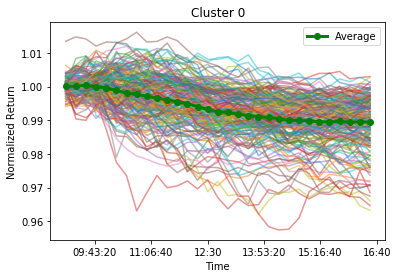

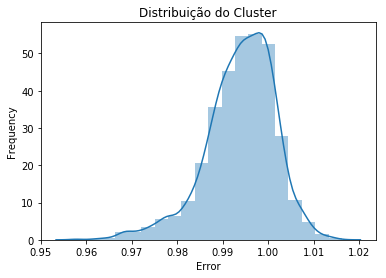

#------------------------------//------------------------------#
Cluster 1
Have 140 days
Representation: 28.57
Accumulated Representation: 67.55
Absolute Error: 0.0220
Mean Square Error: 0.0007
Upward Trend 09:15:00


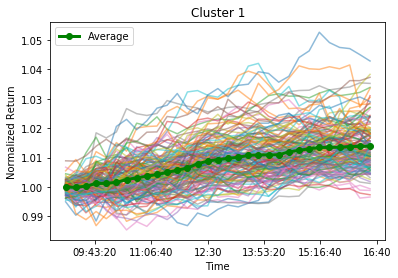

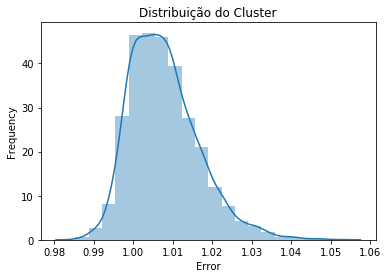

#------------------------------//------------------------------#
Cluster 2
Have 23 days
Representation: 4.69
Accumulated Representation: 72.24
Absolute Error: 0.0633
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 10:45:00
Downtrend 13:45:00


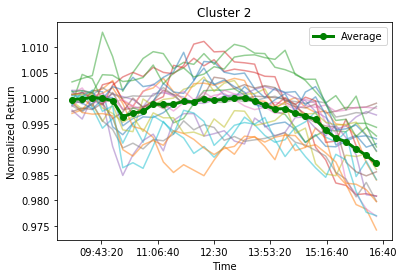

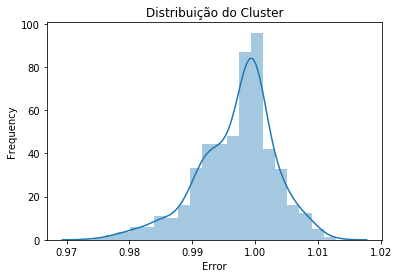

#------------------------------//------------------------------#
Cluster 3
Have 16 days
Representation: 3.27
Accumulated Representation: 75.51
Absolute Error: 0.1037
Mean Square Error: 0.0033
Upward Trend 09:15:00
Downtrend 13:45:00


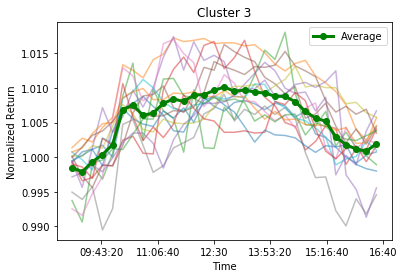

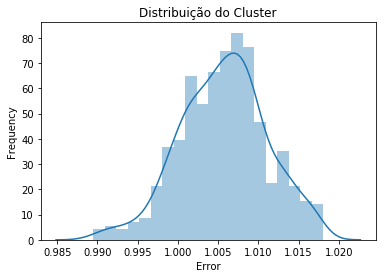

#------------------------------//------------------------------#
Cluster 4
Have 13 days
Representation: 2.65
Accumulated Representation: 78.16
Absolute Error: 0.0635
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:30:00
Upward Trend 15:30:00


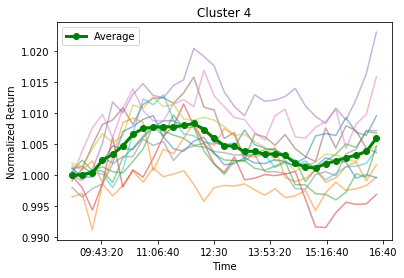

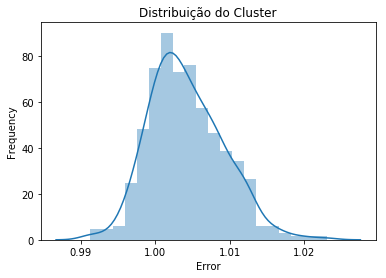

#------------------------------//------------------------------#
Cluster 5
Have 11 days
Representation: 2.24
Accumulated Representation: 80.41
Absolute Error: 0.0621
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:00:00
Upward Trend 14:00:00


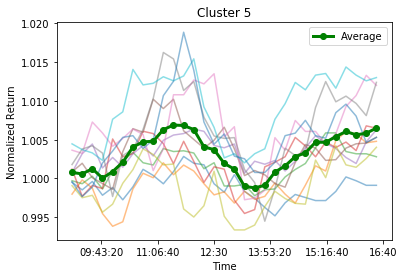

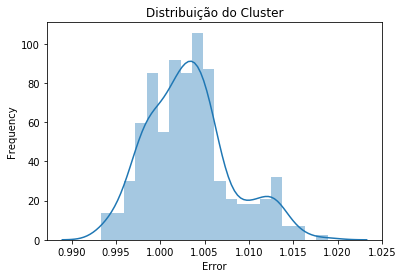

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -5.530225223541753
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002025          0.801673          0.699167      0.000046
--------//--------
Generation:  2
Media Geração:  -5.528046644842557
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002025          0.801673          0.699167      0.000046
--------//--------
Generation:  3
Media Geração:  -5.3264281686282855
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002452          0.814165           0.69364     -0.000027
--------//--------
Generation:  4
Media Geração:  -5.325610401418866
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002452          0.814165           0.69364     -0.000027
--------//--------
Generation:  5
Media Geração:  -5.124144518850417
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrela

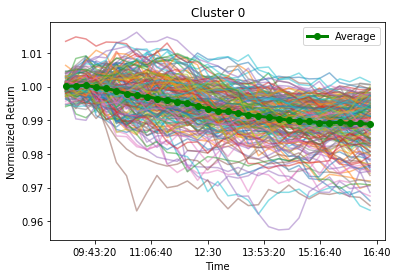

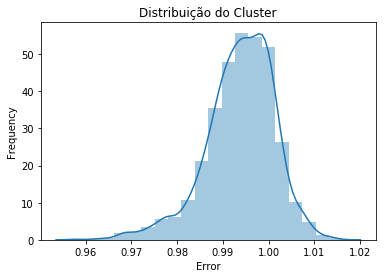

#------------------------------//------------------------------#
Cluster 1
Have 147 days
Representation: 28.88
Accumulated Representation: 68.17
Absolute Error: 0.0225
Mean Square Error: 0.0007
Upward Trend 09:15:00


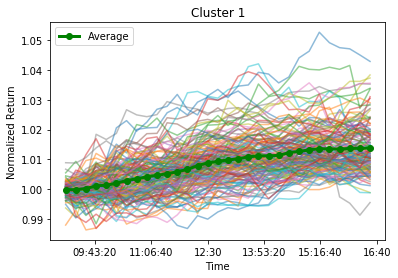

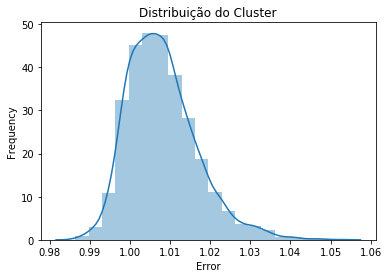

#------------------------------//------------------------------#
Cluster 2
Have 28 days
Representation: 5.50
Accumulated Representation: 73.67
Absolute Error: 0.0898
Mean Square Error: 0.0029
Upward Trend 09:15:00
Downtrend 13:15:00


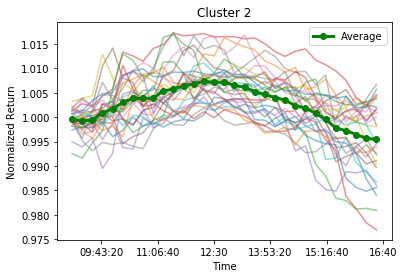

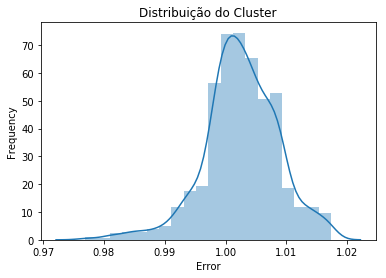

#------------------------------//------------------------------#
Cluster 3
Have 16 days
Representation: 3.14
Accumulated Representation: 76.82
Absolute Error: 0.0736
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 11:15:00
Upward Trend 13:45:00


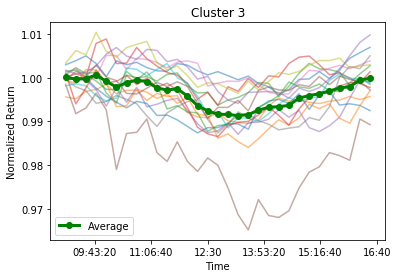

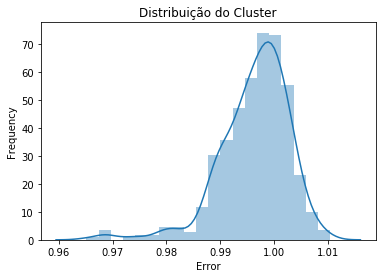

#------------------------------//------------------------------#
Cluster 4
Have 14 days
Representation: 2.75
Accumulated Representation: 79.57
Absolute Error: 0.0853
Mean Square Error: 0.0028
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 13:00:00


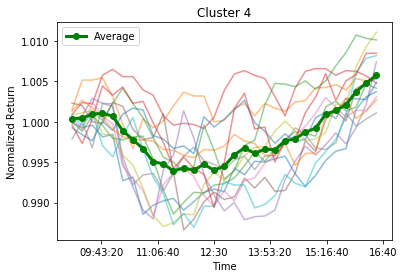

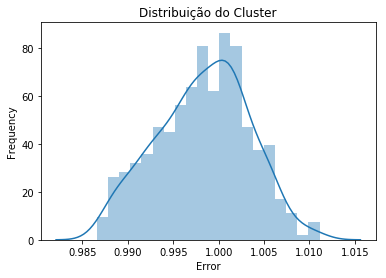

#------------------------------//------------------------------#
Cluster 5
Have 13 days
Representation: 2.55
Accumulated Representation: 82.12
Absolute Error: 0.0623
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:15:00
Upward Trend 15:30:00


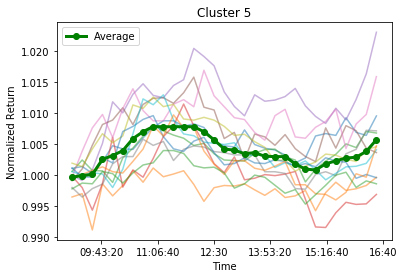

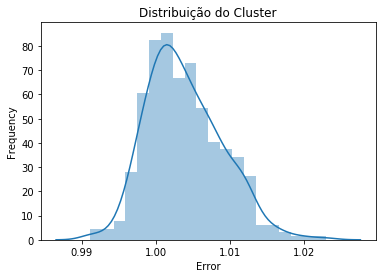

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -10.020750799715385
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002038          0.800009          0.703776     -0.000096
--------//--------
Generation:  2
Media Geração:  -9.819695575702209
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002038          0.800009          0.703776     -0.000096
--------//--------
Generation:  3
Media Geração:  -9.719176732438493
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001887          0.794954          0.693014      0.000031
--------//--------
Generation:  4
Media Geração:  -8.72138235282802
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001599          0.800434          0.671092      0.000498
--------//--------
Generation:  5
Media Geração:  -8.029020235696576
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelac

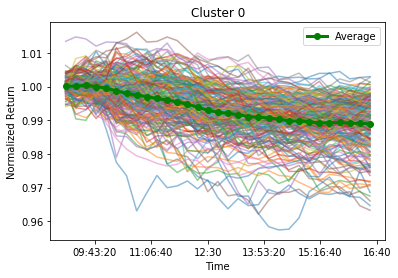

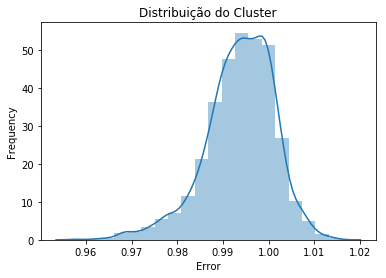

#------------------------------//------------------------------#
Cluster 1
Have 155 days
Representation: 29.41
Accumulated Representation: 68.31
Absolute Error: 0.0241
Mean Square Error: 0.0008
Upward Trend 09:15:00


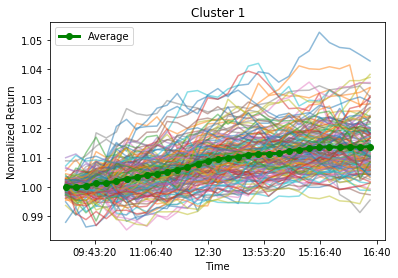

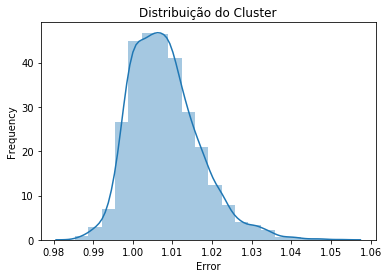

#------------------------------//------------------------------#
Cluster 2
Have 23 days
Representation: 4.36
Accumulated Representation: 72.68
Absolute Error: 0.0666
Mean Square Error: 0.0021
Downtrend 09:15:00
Upward Trend 10:45:00
Downtrend 12:45:00


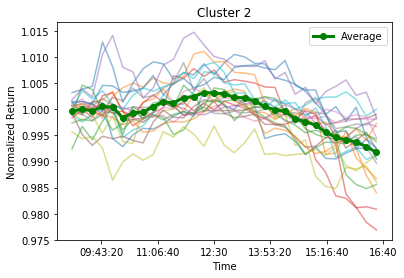

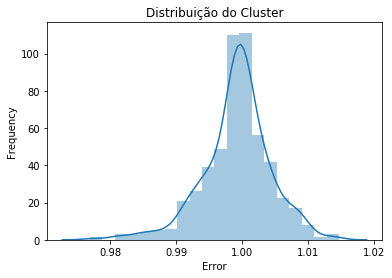

#------------------------------//------------------------------#
Cluster 3
Have 17 days
Representation: 3.23
Accumulated Representation: 75.90
Absolute Error: 0.0795
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:30:00


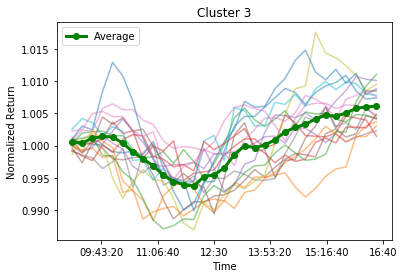

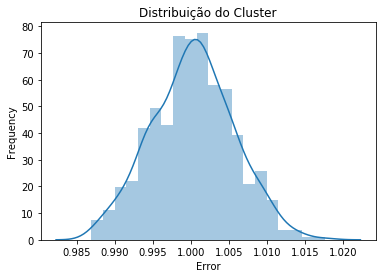

#------------------------------//------------------------------#
Cluster 4
Have 15 days
Representation: 2.85
Accumulated Representation: 78.75
Absolute Error: 0.0974
Mean Square Error: 0.0031
Upward Trend 09:15:00
Downtrend 13:15:00


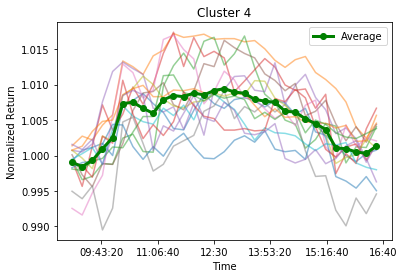

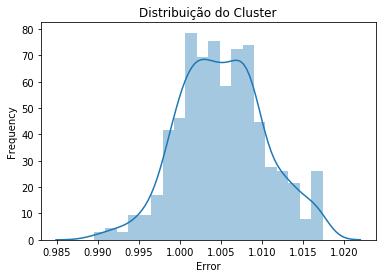

#------------------------------//------------------------------#
Cluster 5
Have 13 days
Representation: 2.47
Accumulated Representation: 81.21
Absolute Error: 0.0623
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:15:00
Upward Trend 15:30:00


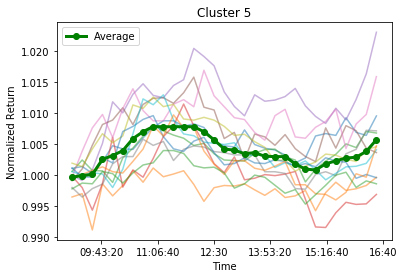

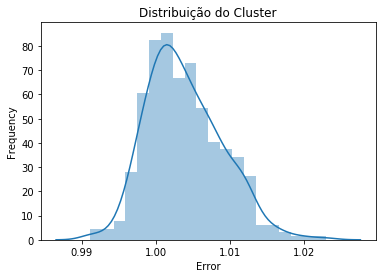

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -11.942180500090917
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002095          0.795467          0.700644       0.00004
--------//--------
Generation:  2
Media Geração:  -11.735016120655748
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002092          0.787566          0.693983      0.000111
--------//--------
Generation:  3
Media Geração:  -11.52366614600933
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001886          0.781427          0.688026     -0.000254
--------//--------
Generation:  4
Media Geração:  -11.112361737411394
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001875          0.817974          0.698001      0.000242
--------//--------
Generation:  5
Media Geração:  -10.720868218479444
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorr

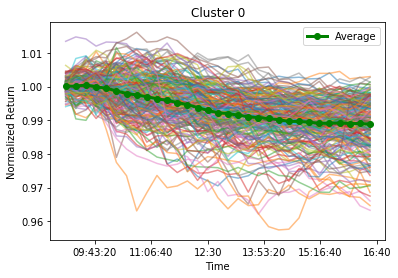

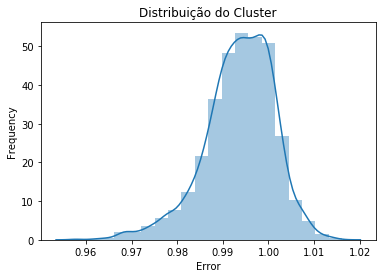

#------------------------------//------------------------------#
Cluster 1
Have 164 days
Representation: 29.87
Accumulated Representation: 67.94
Absolute Error: 0.0212
Mean Square Error: 0.0007
Upward Trend 09:15:00


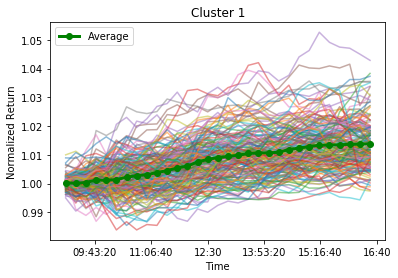

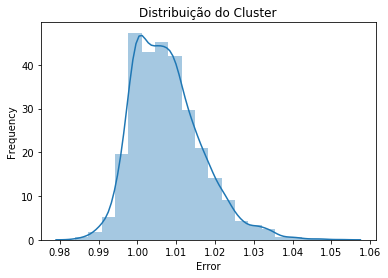

#------------------------------//------------------------------#
Cluster 2
Have 24 days
Representation: 4.37
Accumulated Representation: 72.31
Absolute Error: 0.0747
Mean Square Error: 0.0024
Downtrend 09:15:00
Upward Trend 10:45:00
Downtrend 12:45:00


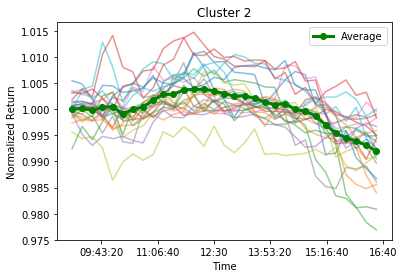

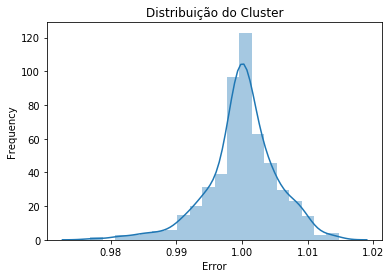

#------------------------------//------------------------------#
Cluster 3
Have 23 days
Representation: 4.19
Accumulated Representation: 76.50
Absolute Error: 0.0849
Mean Square Error: 0.0027
Upward Trend 09:15:00
Downtrend 12:00:00


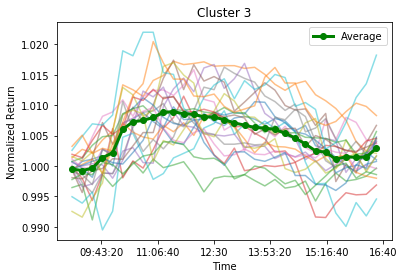

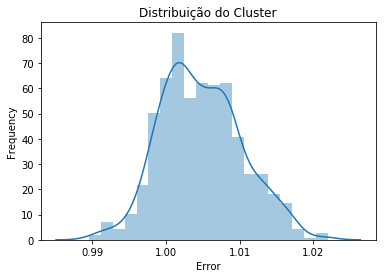

#------------------------------//------------------------------#
Cluster 4
Have 22 days
Representation: 4.01
Accumulated Representation: 80.51
Absolute Error: 0.0675
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


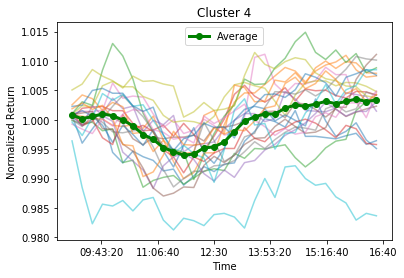

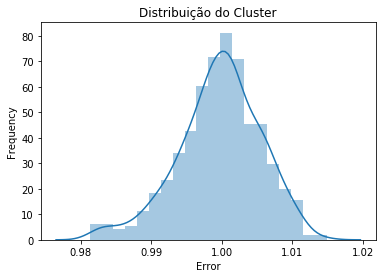

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -5.908686455531568
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002013          0.802147          0.700473     -0.000022
--------//--------
Generation:  2
Media Geração:  -5.902068920875079
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001897          0.797919          0.693208      0.000138
--------//--------
Generation:  3
Media Geração:  -5.893902497387041
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001897          0.797919          0.693208      0.000138
--------//--------
Generation:  4
Media Geração:  -5.889076711450318
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001897          0.797919          0.693208      0.000138
--------//--------
Generation:  5
Media Geração:  -5.884988872388919
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelac

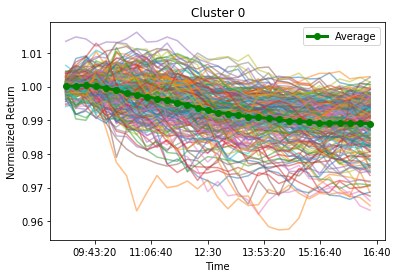

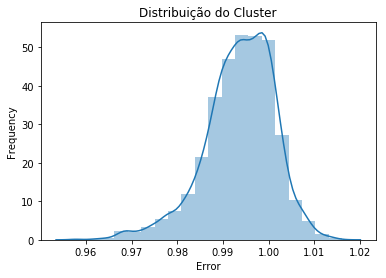

#------------------------------//------------------------------#
Cluster 1
Have 169 days
Representation: 29.70
Accumulated Representation: 67.49
Absolute Error: 0.0224
Mean Square Error: 0.0007
Upward Trend 09:15:00


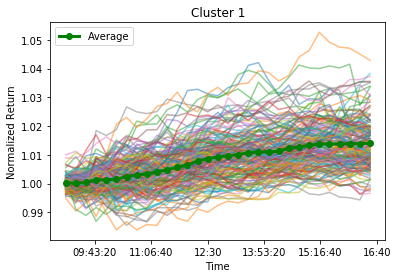

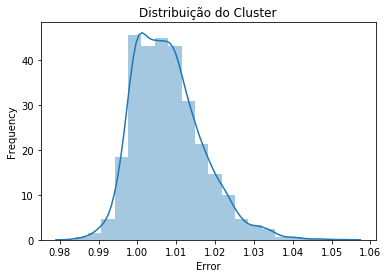

#------------------------------//------------------------------#
Cluster 2
Have 31 days
Representation: 5.45
Accumulated Representation: 72.93
Absolute Error: 0.0907
Mean Square Error: 0.0029
Upward Trend 09:15:00
Downtrend 13:15:00


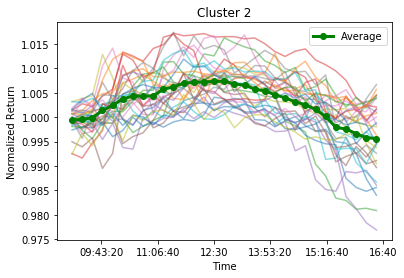

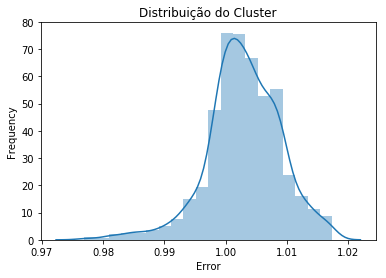

#------------------------------//------------------------------#
Cluster 3
Have 17 days
Representation: 2.99
Accumulated Representation: 75.92
Absolute Error: 0.0686
Mean Square Error: 0.0022
Downtrend 09:15:00
Upward Trend 10:00:00
Downtrend 11:00:00
Upward Trend 13:30:00


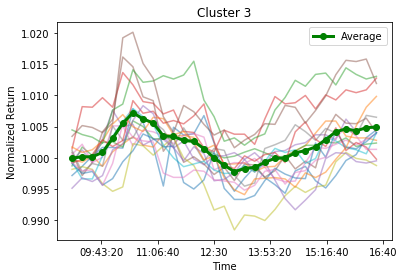

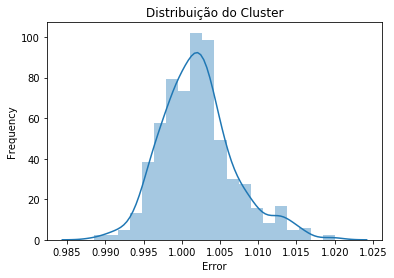

#------------------------------//------------------------------#
Cluster 4
Have 16 days
Representation: 2.81
Accumulated Representation: 78.73
Absolute Error: 0.0748
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 10:30:00
Upward Trend 12:30:00


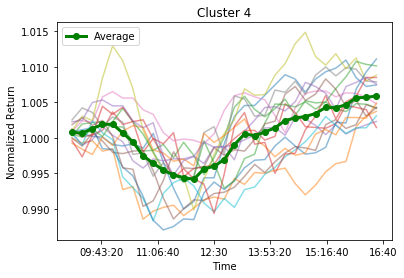

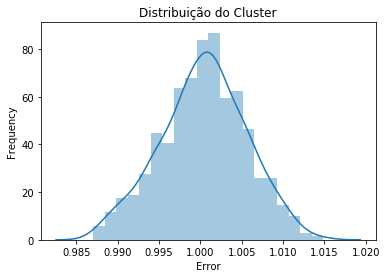

#------------------------------//------------------------------#
Cluster 5
Have 11 days
Representation: 1.93
Accumulated Representation: 80.67
Absolute Error: 0.0675
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 12:30:00
Upward Trend 15:15:00


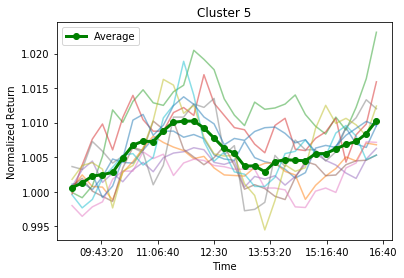

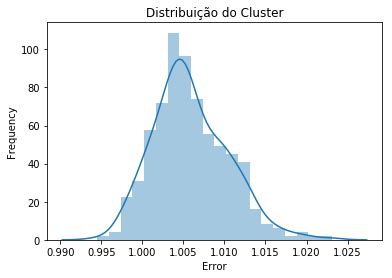

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -4.911868987142255
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0         0.002               0.8               0.7             0
--------//--------
Generation:  2
Media Geração:  -4.905723692089888
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001899          0.783871          0.689008     -0.000088
--------//--------
Generation:  3
Media Geração:  -4.899624075471443
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002054          0.800038          0.702354      0.000164
--------//--------
Generation:  4
Media Geração:  -4.898856361658082
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002054          0.800038          0.702354      0.000164
--------//--------
Generation:  5
Media Geração:  -4.897473144327877
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelac

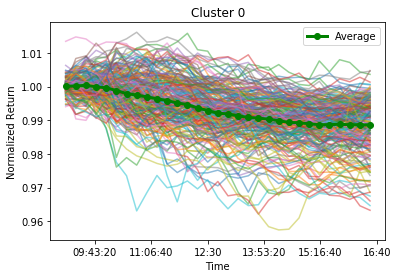

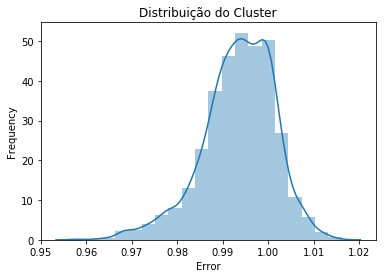

#------------------------------//------------------------------#
Cluster 1
Have 169 days
Representation: 28.64
Accumulated Representation: 65.42
Absolute Error: 0.0235
Mean Square Error: 0.0008
Upward Trend 09:15:00


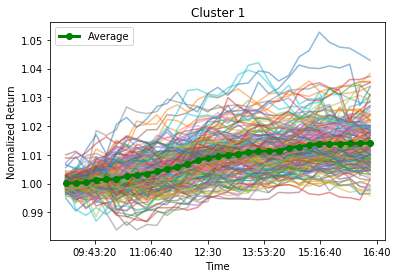

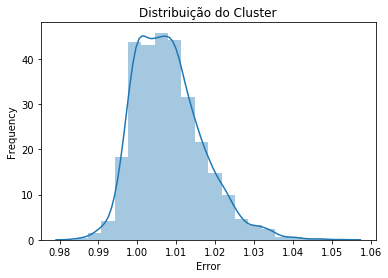

#------------------------------//------------------------------#
Cluster 2
Have 34 days
Representation: 5.76
Accumulated Representation: 71.19
Absolute Error: 0.0908
Mean Square Error: 0.0029
Upward Trend 09:15:00
Downtrend 13:00:00


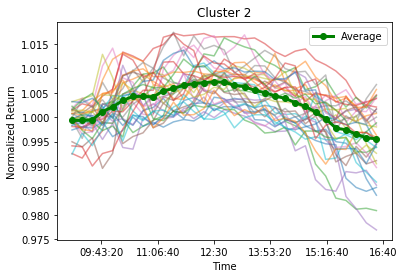

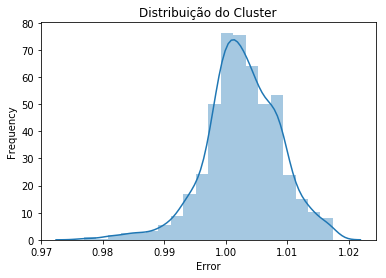

#------------------------------//------------------------------#
Cluster 3
Have 26 days
Representation: 4.41
Accumulated Representation: 75.59
Absolute Error: 0.0695
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


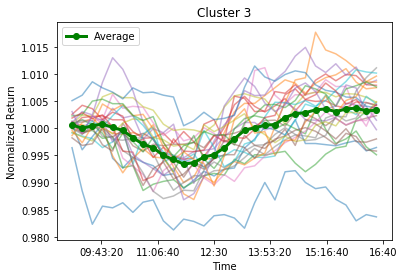

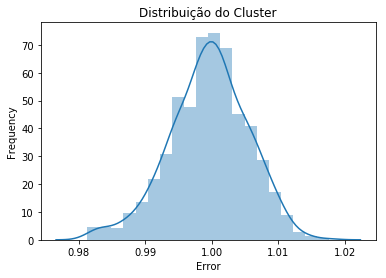

#------------------------------//------------------------------#
Cluster 4
Have 15 days
Representation: 2.54
Accumulated Representation: 78.14
Absolute Error: 0.0606
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 11:00:00
Downtrend 14:45:00


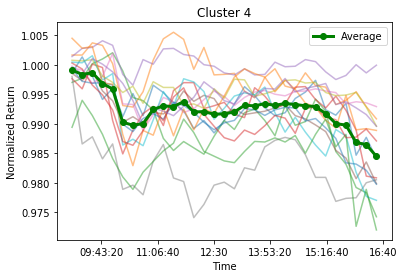

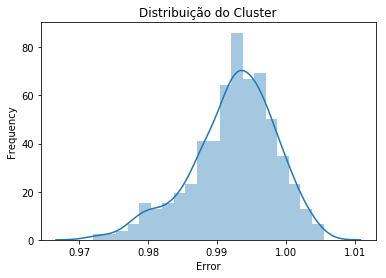

#------------------------------//------------------------------#
Cluster 5
Have 10 days
Representation: 1.69
Accumulated Representation: 79.83
Absolute Error: 0.0687
Mean Square Error: 0.0022
Downtrend 09:15:00
Upward Trend 10:00:00
Downtrend 11:30:00
Upward Trend 15:15:00


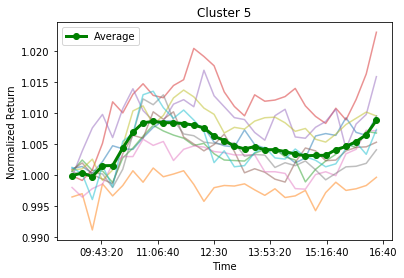

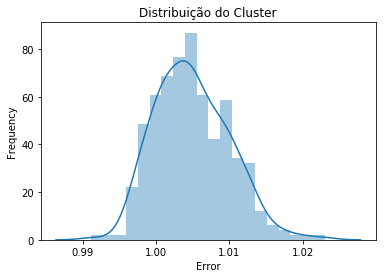

#------------------------------//------------------------------#
Cluster 6
Have 10 days
Representation: 1.69
Accumulated Representation: 81.53
Absolute Error: 0.0403
Mean Square Error: 0.0013
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 12:15:00
Downtrend 13:15:00


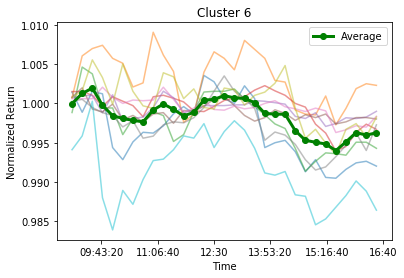

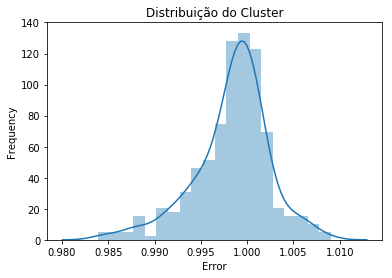

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -11.814299794131513
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002068          0.795789          0.699956      0.000037
--------//--------
Generation:  2
Media Geração:  -11.713521284982292
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001904          0.803794          0.695721      0.000024
--------//--------
Generation:  3
Media Geração:  -11.613043718017972
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001904          0.803794          0.695721      0.000024
--------//--------
Generation:  4
Media Geração:  -11.512535105852567
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001904          0.803794          0.695721      0.000024
--------//--------
Generation:  5
Media Geração:  -11.119132072305167
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCor

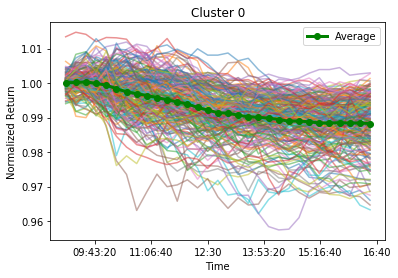

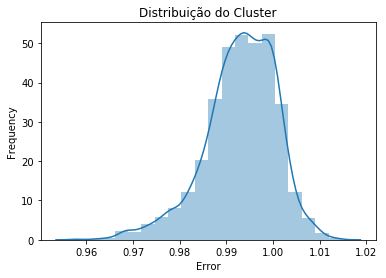

#------------------------------//------------------------------#
Cluster 1
Have 178 days
Representation: 29.08
Accumulated Representation: 64.87
Absolute Error: 0.0233
Mean Square Error: 0.0008
Upward Trend 09:15:00


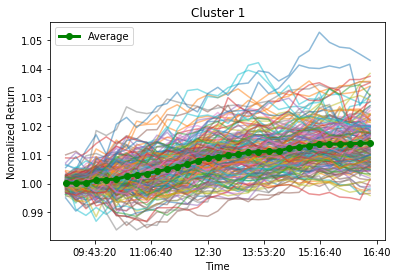

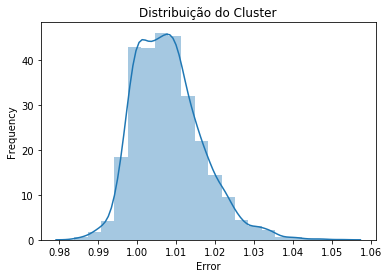

#------------------------------//------------------------------#
Cluster 2
Have 33 days
Representation: 5.39
Accumulated Representation: 70.26
Absolute Error: 0.0734
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 12:15:00


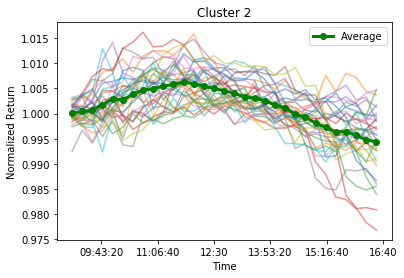

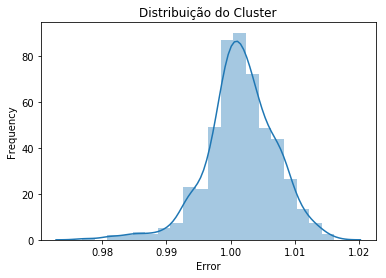

#------------------------------//------------------------------#
Cluster 3
Have 26 days
Representation: 4.25
Accumulated Representation: 74.51
Absolute Error: 0.0695
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


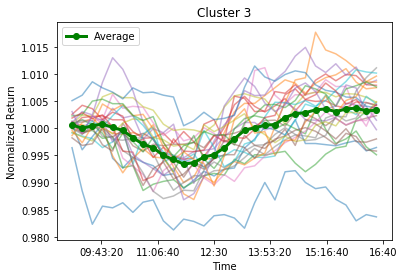

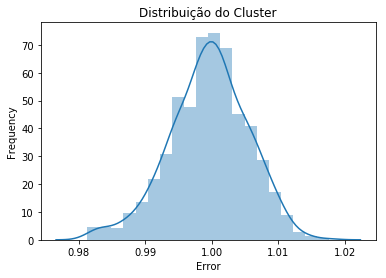

#------------------------------//------------------------------#
Cluster 4
Have 20 days
Representation: 3.27
Accumulated Representation: 77.78
Absolute Error: 0.1000
Mean Square Error: 0.0032
Upward Trend 09:15:00
Downtrend 13:45:00


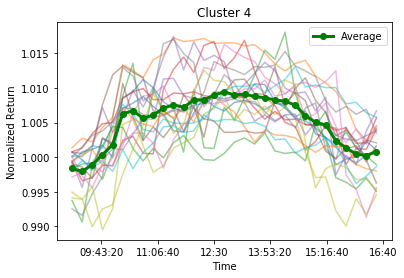

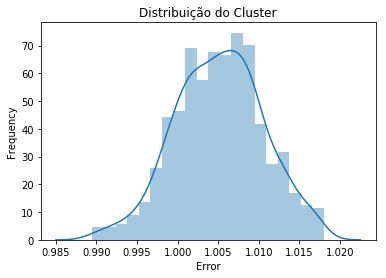

#------------------------------//------------------------------#
Cluster 5
Have 13 days
Representation: 2.12
Accumulated Representation: 79.90
Absolute Error: 0.0499
Mean Square Error: 0.0016
Downtrend 09:15:00
Upward Trend 11:15:00
Downtrend 12:15:00
Upward Trend 13:30:00


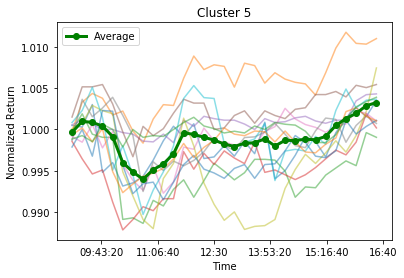

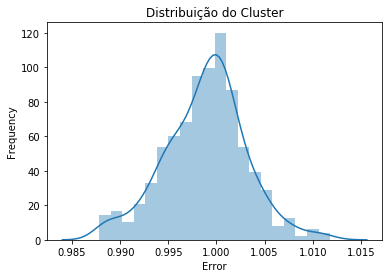

#------------------------------//------------------------------#
Cluster 6
Have 12 days
Representation: 1.96
Accumulated Representation: 81.86
Absolute Error: 0.0707
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 12:45:00
Downtrend 15:30:00


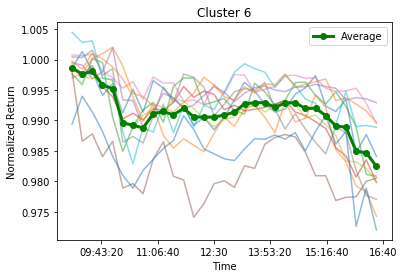

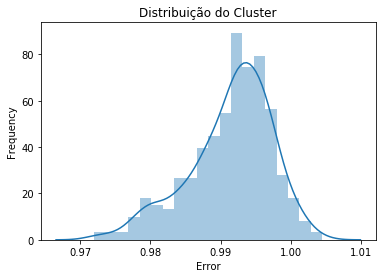

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -4.903203091250929
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001961          0.800861          0.687771      0.000182
--------//--------
Generation:  2
Media Geração:  -4.902766808880989
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001961          0.800861          0.687771      0.000182
--------//--------
Generation:  3
Media Geração:  -4.901258181575395
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002081          0.801369          0.700258     -0.000092
--------//--------
Generation:  4
Media Geração:  -4.900313079269781
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002081          0.801369          0.700258     -0.000092
--------//--------
Generation:  5
Media Geração:  -4.900313079269781
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelac

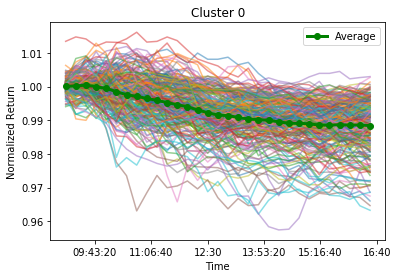

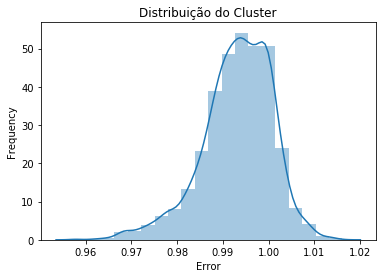

#------------------------------//------------------------------#
Cluster 1
Have 189 days
Representation: 29.86
Accumulated Representation: 65.09
Absolute Error: 0.0214
Mean Square Error: 0.0007
Upward Trend 09:15:00


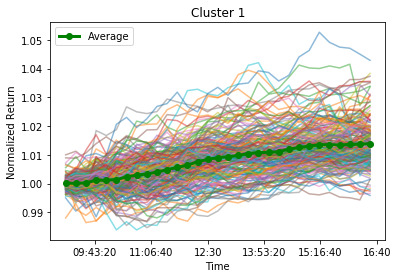

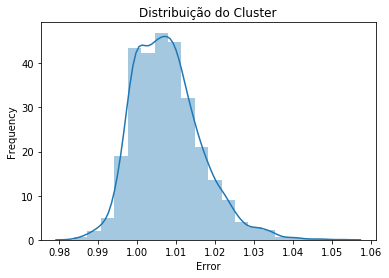

#------------------------------//------------------------------#
Cluster 2
Have 38 days
Representation: 6.00
Accumulated Representation: 71.09
Absolute Error: 0.0695
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 12:15:00


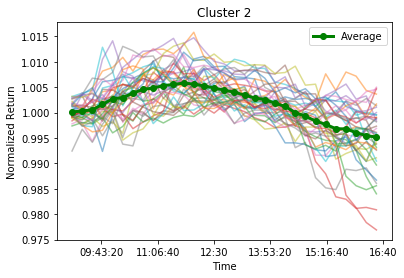

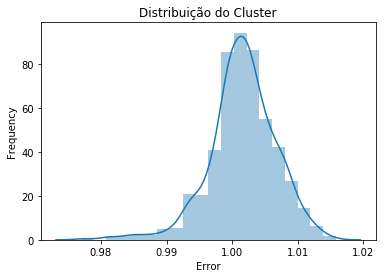

#------------------------------//------------------------------#
Cluster 3
Have 20 days
Representation: 3.16
Accumulated Representation: 74.25
Absolute Error: 0.1000
Mean Square Error: 0.0032
Upward Trend 09:15:00
Downtrend 13:45:00


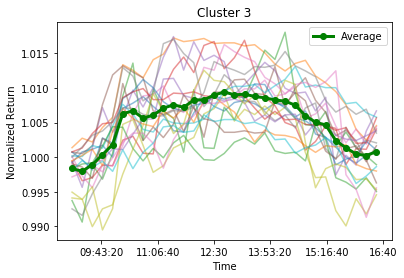

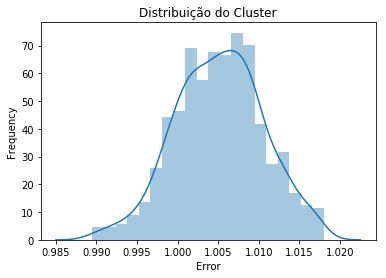

#------------------------------//------------------------------#
Cluster 4
Have 16 days
Representation: 2.53
Accumulated Representation: 76.78
Absolute Error: 0.0699
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00
Downtrend 16:15:00


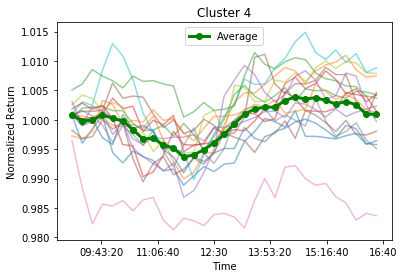

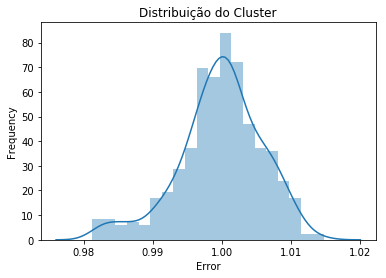

#------------------------------//------------------------------#
Cluster 5
Have 15 days
Representation: 2.37
Accumulated Representation: 79.15
Absolute Error: 0.0863
Mean Square Error: 0.0028
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 13:15:00


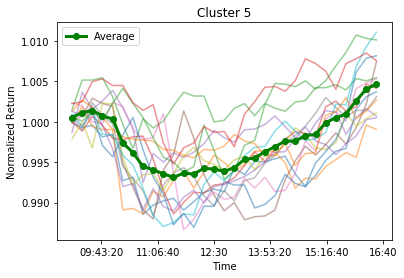

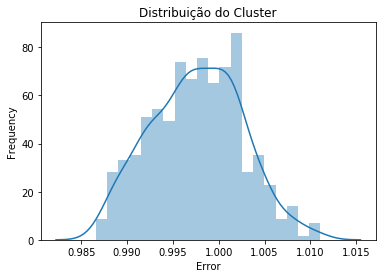

#------------------------------//------------------------------#
Cluster 6
Have 12 days
Representation: 1.90
Accumulated Representation: 81.04
Absolute Error: 0.0640
Mean Square Error: 0.0021
Downtrend 09:15:00
Upward Trend 10:00:00
Downtrend 12:00:00
Upward Trend 15:45:00


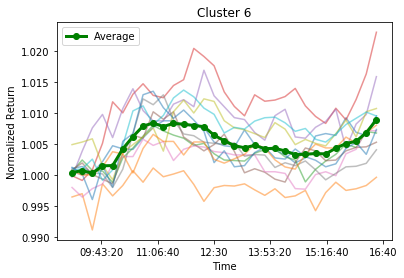

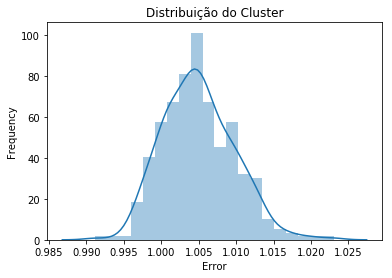

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -1.955038679797449
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002053          0.804743          0.699306     -0.000061
--------//--------
Generation:  2
Media Geração:  -1.9479659304884032
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001926          0.800909          0.697552     -0.000007
--------//--------
Generation:  3
Media Geração:  -1.9431333112307443
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002081             0.803          0.695435      0.000231
--------//--------
Generation:  4
Media Geração:  -1.9431333112307443
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002081             0.803          0.695435      0.000231
--------//--------
Generation:  5
Media Geração:  -1.9429909869843498
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorr

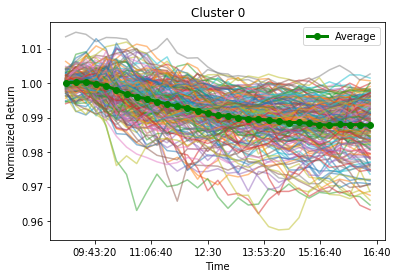

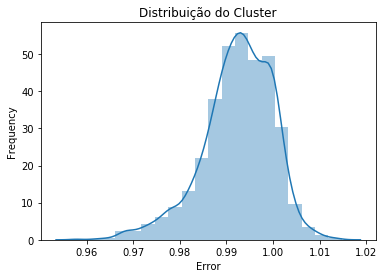

#------------------------------//------------------------------#
Cluster 1
Have 180 days
Representation: 27.44
Accumulated Representation: 57.32
Absolute Error: 0.0199
Mean Square Error: 0.0006
Upward Trend 09:15:00


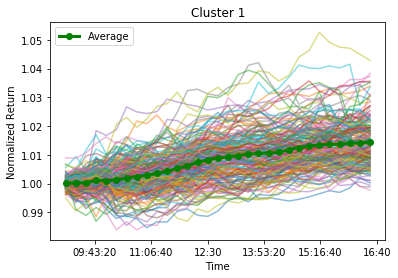

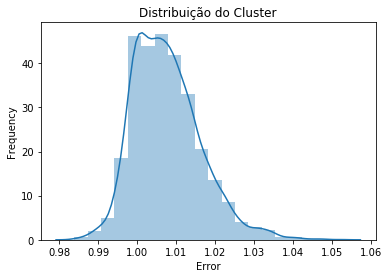

#------------------------------//------------------------------#
Cluster 2
Have 58 days
Representation: 8.84
Accumulated Representation: 66.16
Absolute Error: 0.0531
Mean Square Error: 0.0017
Upward Trend 09:15:00
Downtrend 12:00:00


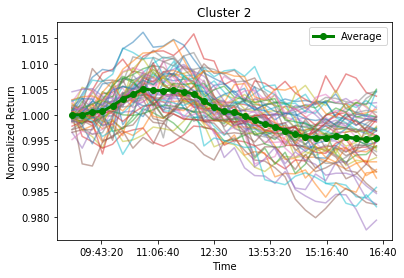

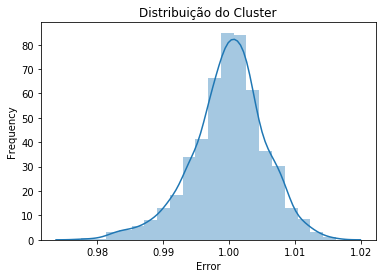

#------------------------------//------------------------------#
Cluster 3
Have 36 days
Representation: 5.49
Accumulated Representation: 71.65
Absolute Error: 0.0891
Mean Square Error: 0.0029
Upward Trend 09:15:00
Downtrend 13:00:00


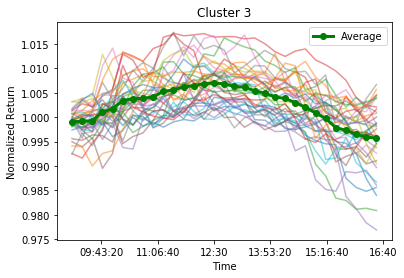

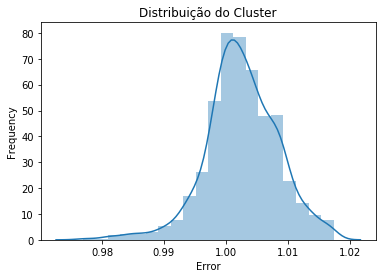

#------------------------------//------------------------------#
Cluster 4
Have 23 days
Representation: 3.51
Accumulated Representation: 75.15
Absolute Error: 0.0639
Mean Square Error: 0.0021
Downtrend 09:15:00
Upward Trend 12:15:00
Downtrend 15:30:00


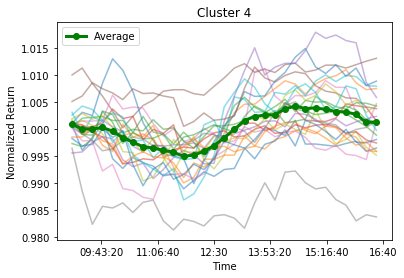

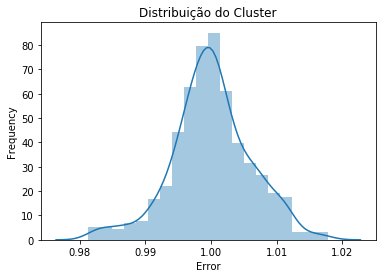

#------------------------------//------------------------------#
Cluster 5
Have 20 days
Representation: 3.05
Accumulated Representation: 78.20
Absolute Error: 0.0787
Mean Square Error: 0.0025
Upward Trend 09:15:00
Downtrend 14:00:00


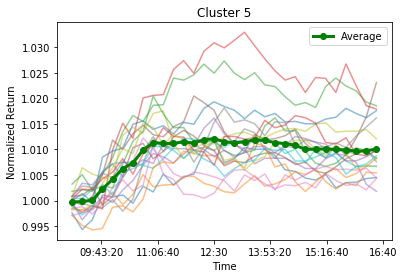

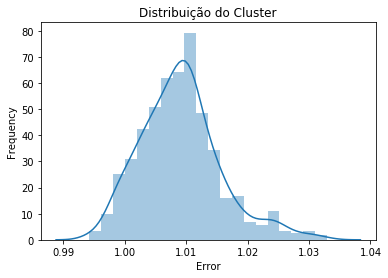

#------------------------------//------------------------------#
Cluster 6
Have 17 days
Representation: 2.59
Accumulated Representation: 80.79
Absolute Error: 0.0719
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 11:15:00
Upward Trend 13:45:00


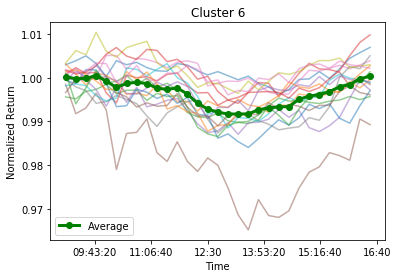

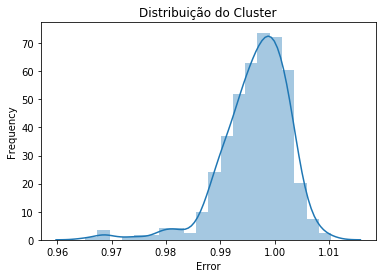

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -3.8204164503527984
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0         0.002               0.8               0.7             0
--------//--------
Generation:  2
Media Geração:  -3.6220147378289482
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0         0.002          0.804224          0.698529       0.00001
--------//--------
Generation:  3
Media Geração:  -3.3238746190409723
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001848          0.814233          0.694065     -0.000021
--------//--------
Generation:  4
Media Geração:  -3.126201787523415
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0       0.00171          0.831926          0.683703     -0.000108
--------//--------
Generation:  5
Media Geração:  -2.6320438247543123
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorr

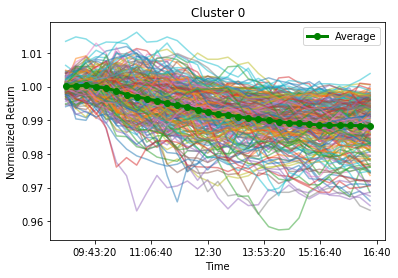

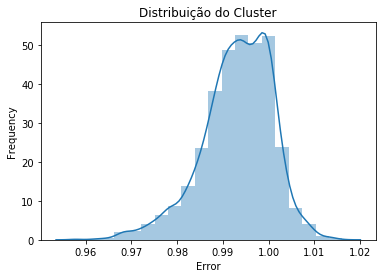

#------------------------------//------------------------------#
Cluster 1
Have 212 days
Representation: 31.31
Accumulated Representation: 65.73
Absolute Error: 0.0200
Mean Square Error: 0.0006
Upward Trend 09:15:00


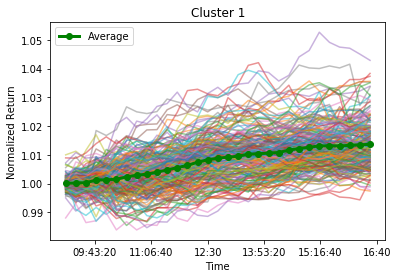

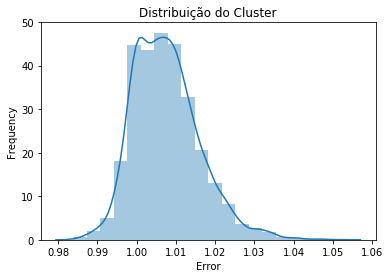

#------------------------------//------------------------------#
Cluster 2
Have 54 days
Representation: 7.98
Accumulated Representation: 73.71
Absolute Error: 0.0796
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 12:15:00


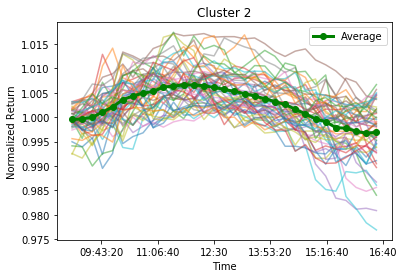

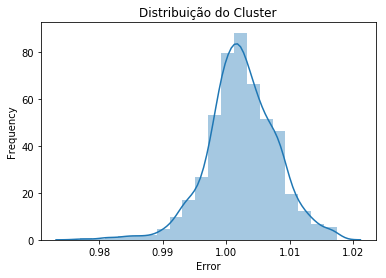

#------------------------------//------------------------------#
Cluster 3
Have 25 days
Representation: 3.69
Accumulated Representation: 77.40
Absolute Error: 0.0716
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:30:00


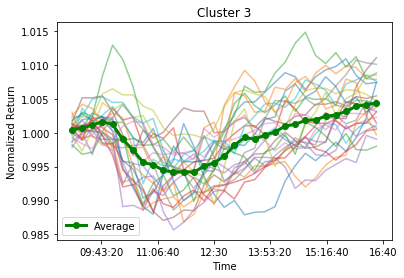

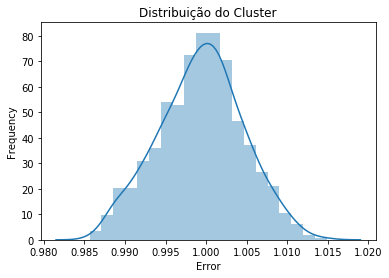

#------------------------------//------------------------------#
Cluster 4
Have 20 days
Representation: 2.95
Accumulated Representation: 80.35
Absolute Error: 0.0792
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 11:00:00
Upward Trend 15:00:00


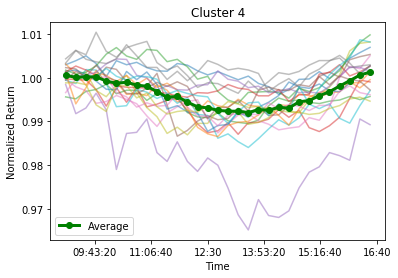

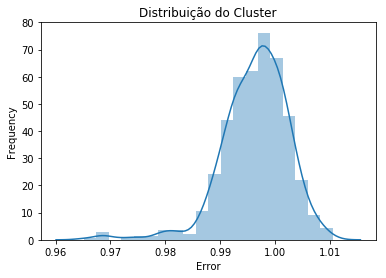

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -8.90471664196415
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0       0.00196          0.804801          0.695216      0.000092
--------//--------
Generation:  2
Media Geração:  -8.902111946972855
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0         0.002               0.8               0.7             0
--------//--------
Generation:  3
Media Geração:  -8.89803402799009
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002008           0.79558          0.702426     -0.000074
--------//--------
Generation:  4
Media Geração:  -8.896166820654468
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002008           0.79558          0.702426     -0.000074
--------//--------
Generation:  5
Media Geração:  -8.895544746990549
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao

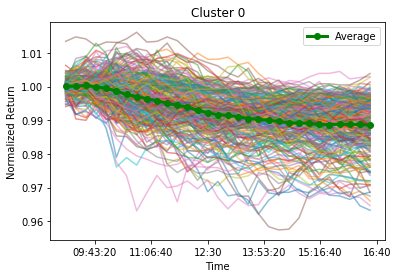

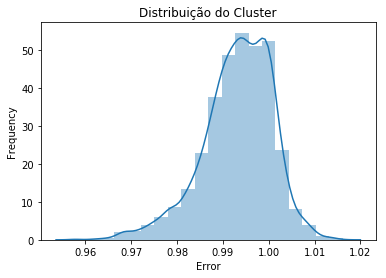

#------------------------------//------------------------------#
Cluster 1
Have 217 days
Representation: 31.13
Accumulated Representation: 66.00
Absolute Error: 0.0209
Mean Square Error: 0.0007
Upward Trend 09:15:00


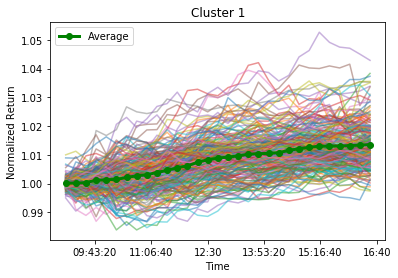

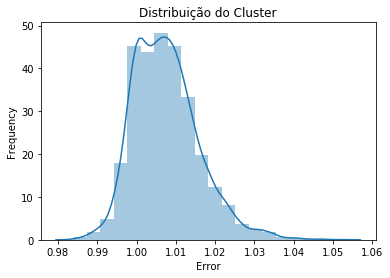

#------------------------------//------------------------------#
Cluster 2
Have 56 days
Representation: 8.03
Accumulated Representation: 74.03
Absolute Error: 0.0789
Mean Square Error: 0.0025
Upward Trend 09:15:00
Downtrend 12:30:00


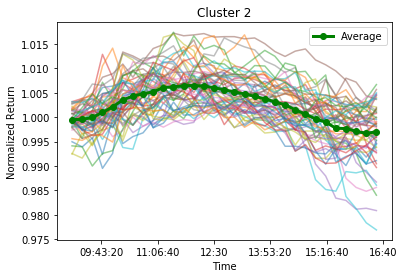

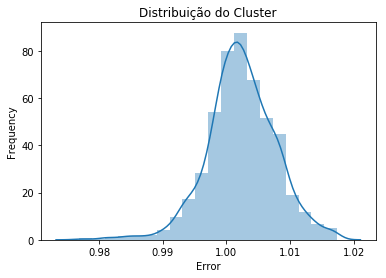

#------------------------------//------------------------------#
Cluster 3
Have 25 days
Representation: 3.59
Accumulated Representation: 77.62
Absolute Error: 0.0716
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:30:00


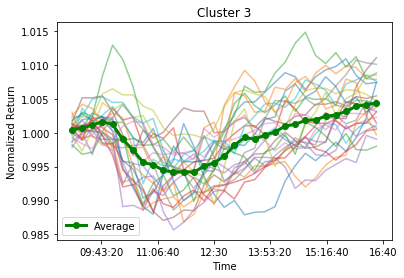

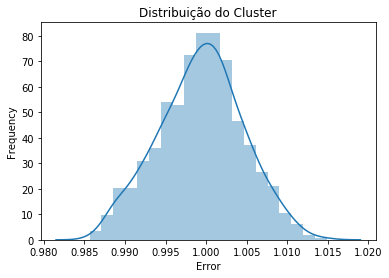

#------------------------------//------------------------------#
Cluster 4
Have 21 days
Representation: 3.01
Accumulated Representation: 80.63
Absolute Error: 0.0500
Mean Square Error: 0.0016
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 11:00:00
Downtrend 12:15:00


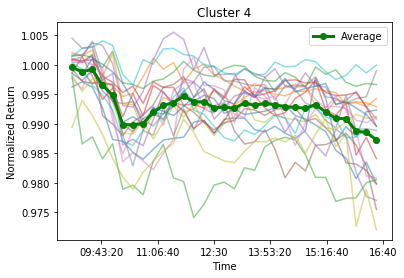

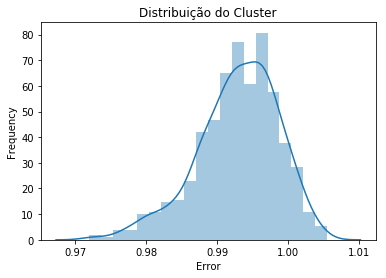

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -3.91165412389996
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001819          0.798252          0.694022      0.000032
--------//--------
Generation:  2
Media Geração:  -3.9101011700905075
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001999           0.79754          0.703463      -0.00004
--------//--------
Generation:  3
Media Geração:  -3.9069142626029723
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001843          0.801796           0.70591      0.000152
--------//--------
Generation:  4
Media Geração:  -3.8024052437471942
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001932          0.770789          0.700658      0.000208
--------//--------
Generation:  5
Media Geração:  -3.6016402544529624
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorre

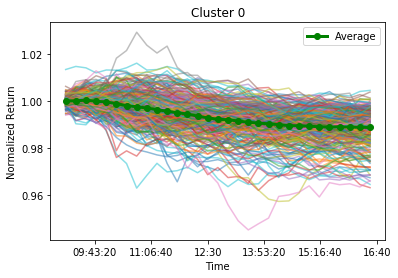

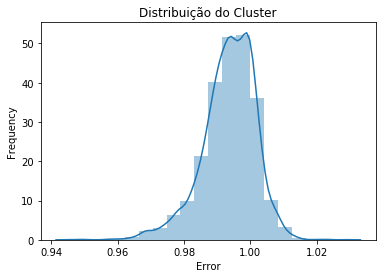

#------------------------------//------------------------------#
Cluster 1
Have 222 days
Representation: 30.96
Accumulated Representation: 67.64
Absolute Error: 0.0209
Mean Square Error: 0.0007
Upward Trend 09:15:00


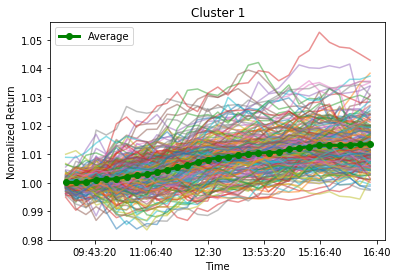

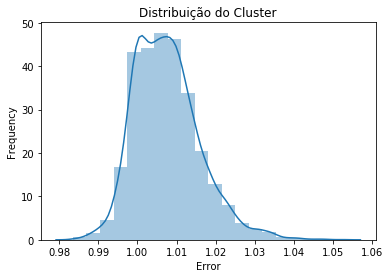

#------------------------------//------------------------------#
Cluster 2
Have 38 days
Representation: 5.30
Accumulated Representation: 72.94
Absolute Error: 0.0893
Mean Square Error: 0.0029
Upward Trend 09:15:00
Downtrend 13:00:00


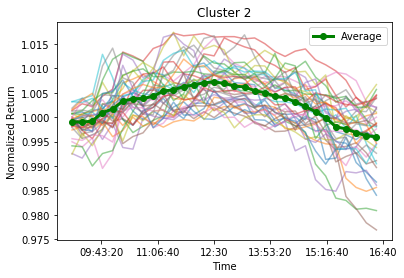

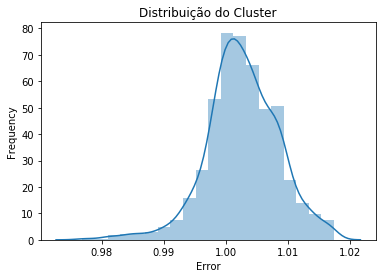

#------------------------------//------------------------------#
Cluster 3
Have 25 days
Representation: 3.49
Accumulated Representation: 76.43
Absolute Error: 0.0716
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:30:00


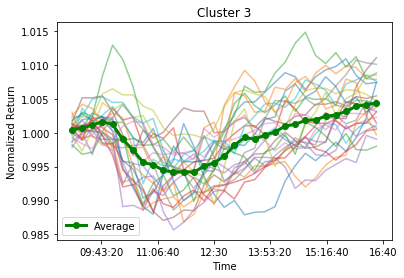

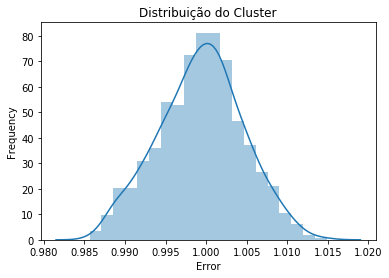

#------------------------------//------------------------------#
Cluster 4
Have 19 days
Representation: 2.65
Accumulated Representation: 79.08
Absolute Error: 0.0579
Mean Square Error: 0.0019
Downtrend 09:15:00
Upward Trend 10:00:00
Downtrend 11:45:00
Upward Trend 15:30:00


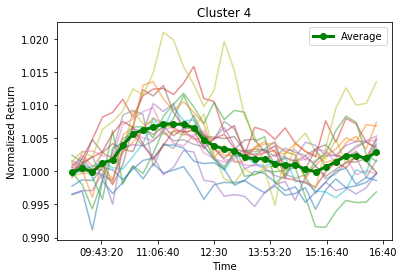

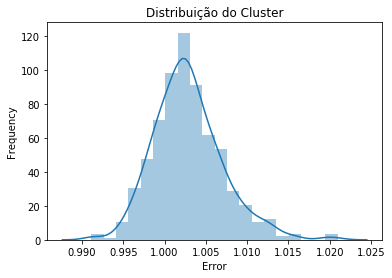

#------------------------------//------------------------------#
Cluster 5
Have 16 days
Representation: 2.23
Accumulated Representation: 81.31
Absolute Error: 0.0516
Mean Square Error: 0.0017
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 10:45:00
Downtrend 15:00:00


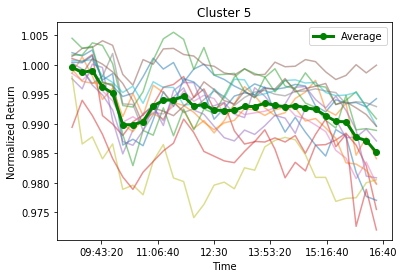

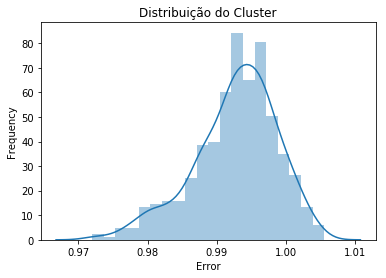

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -8.883015550553685
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001992           0.79846          0.700051     -0.000003
--------//--------
Generation:  2
Media Geração:  -8.88152098669001
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002016           0.80299          0.696837      0.000092
--------//--------
Generation:  3
Media Geração:  -8.879445905168248
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002016           0.80299          0.696837      0.000092
--------//--------
Generation:  4
Media Geração:  -8.875011441431885
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001707          0.806765          0.699523     -0.000196
--------//--------
Generation:  5
Media Geração:  -8.872722944458177
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelaca

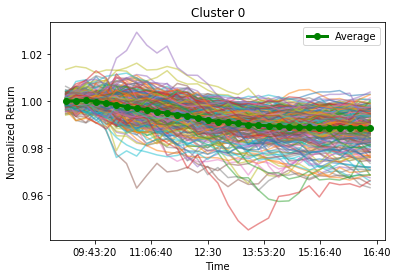

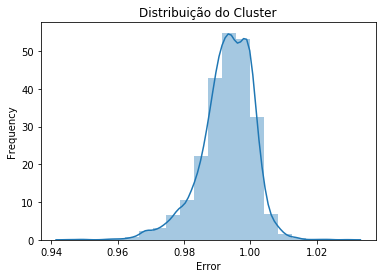

#------------------------------//------------------------------#
Cluster 1
Have 230 days
Representation: 31.17
Accumulated Representation: 64.50
Absolute Error: 0.0213
Mean Square Error: 0.0007
Upward Trend 09:15:00


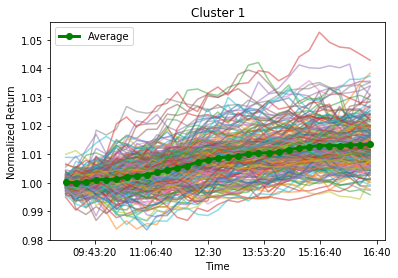

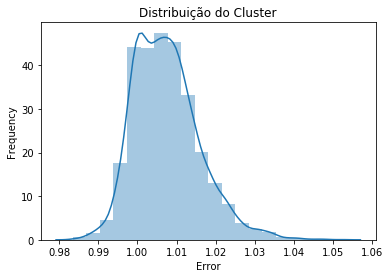

#------------------------------//------------------------------#
Cluster 2
Have 70 days
Representation: 9.49
Accumulated Representation: 73.98
Absolute Error: 0.0783
Mean Square Error: 0.0025
Upward Trend 09:15:00
Downtrend 12:15:00


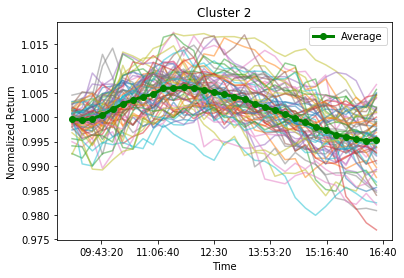

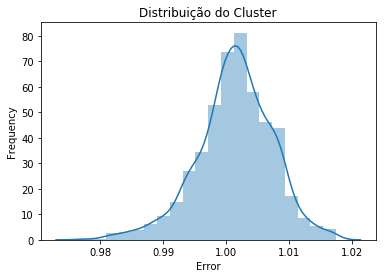

#------------------------------//------------------------------#
Cluster 3
Have 26 days
Representation: 3.52
Accumulated Representation: 77.51
Absolute Error: 0.0406
Mean Square Error: 0.0013
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 11:00:00
Downtrend 13:45:00


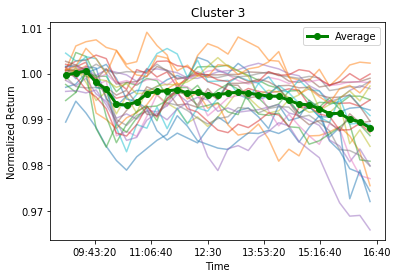

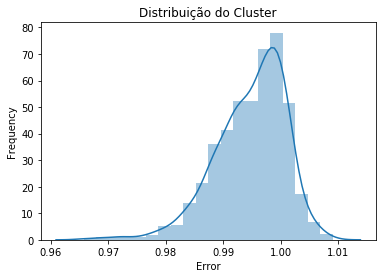

#------------------------------//------------------------------#
Cluster 4
Have 25 days
Representation: 3.39
Accumulated Representation: 80.89
Absolute Error: 0.0697
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


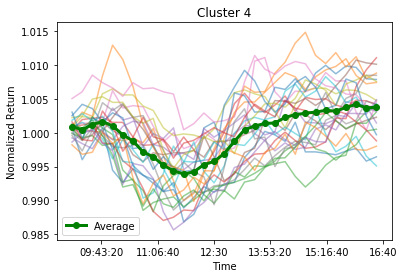

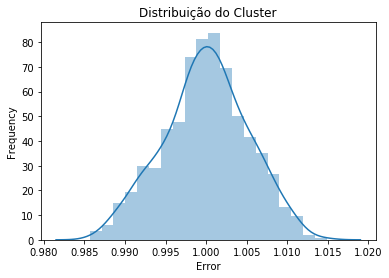

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -8.243157828315415
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001967          0.795527          0.702055     -0.000068
--------//--------
Generation:  2
Media Geração:  -7.9420159604506235
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001943          0.789298          0.711458     -0.000159
--------//--------
Generation:  3
Media Geração:  -7.939370941649609
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001922          0.794664           0.69747     -0.000096
--------//--------
Generation:  4
Media Geração:  -7.936453706573003
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001922          0.794664           0.69747     -0.000096
--------//--------
Generation:  5
Media Geração:  -7.9352856515812915
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrel

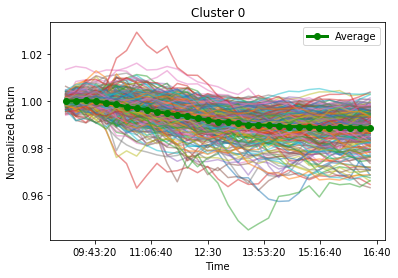

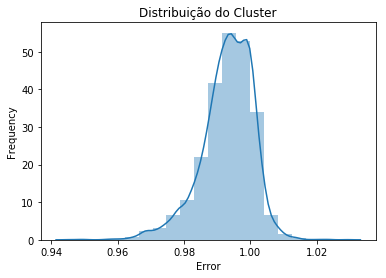

#------------------------------//------------------------------#
Cluster 1
Have 240 days
Representation: 31.62
Accumulated Representation: 64.95
Absolute Error: 0.0203
Mean Square Error: 0.0007
Upward Trend 09:15:00


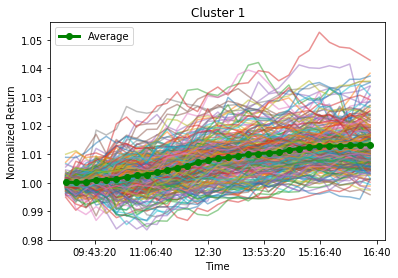

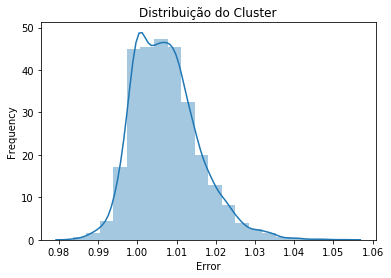

#------------------------------//------------------------------#
Cluster 2
Have 70 days
Representation: 9.22
Accumulated Representation: 74.18
Absolute Error: 0.0783
Mean Square Error: 0.0025
Upward Trend 09:15:00
Downtrend 12:15:00


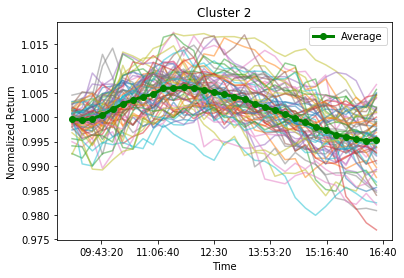

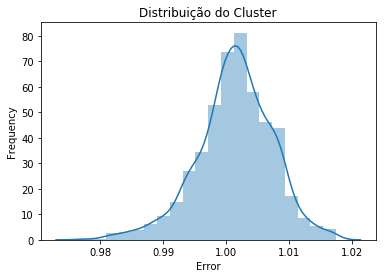

#------------------------------//------------------------------#
Cluster 3
Have 25 days
Representation: 3.29
Accumulated Representation: 77.47
Absolute Error: 0.0412
Mean Square Error: 0.0013
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 11:00:00
Downtrend 13:45:00


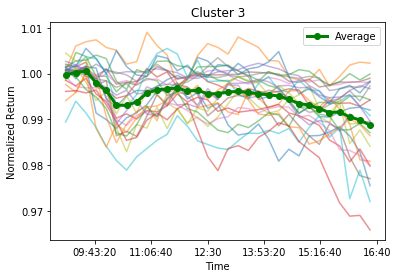

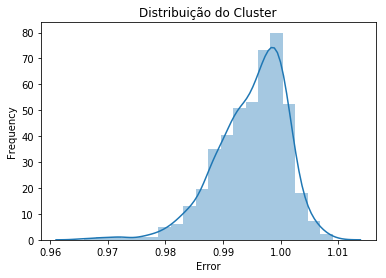

#------------------------------//------------------------------#
Cluster 4
Have 25 days
Representation: 3.29
Accumulated Representation: 80.76
Absolute Error: 0.0697
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


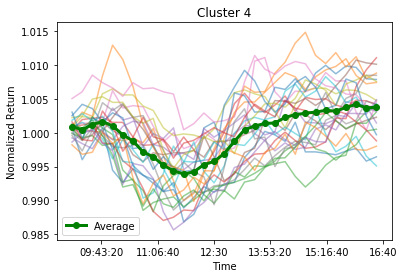

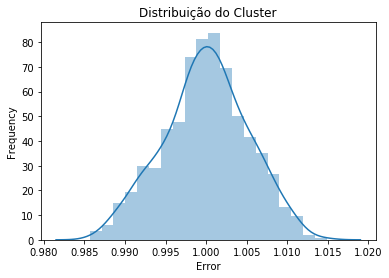

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -7.94591028593665
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002098          0.795256          0.698832      0.000086
--------//--------
Generation:  2
Media Geração:  -7.940962540409201
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002098          0.795256          0.698832      0.000086
--------//--------
Generation:  3
Media Geração:  -7.738367375464871
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001994          0.796557          0.701757     -0.000087
--------//--------
Generation:  4
Media Geração:  -7.636195689220327
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001932          0.794383           0.69691      0.000126
--------//--------
Generation:  5
Media Geração:  -7.332191265856835
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelaca

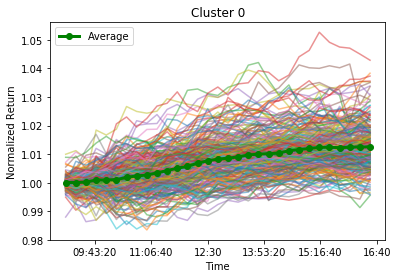

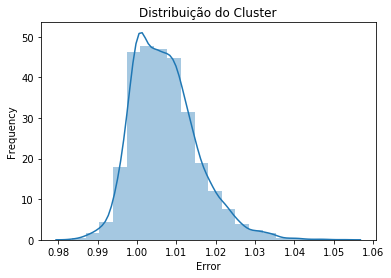

#------------------------------//------------------------------#
Cluster 1
Have 233 days
Representation: 29.99
Accumulated Representation: 62.93
Absolute Error: 0.0176
Mean Square Error: 0.0006
Upward Trend 09:15:00
Downtrend 10:00:00


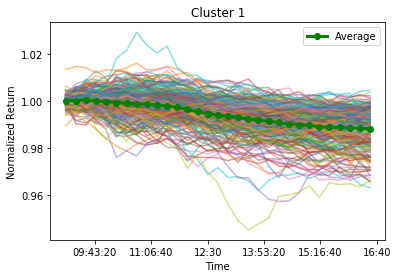

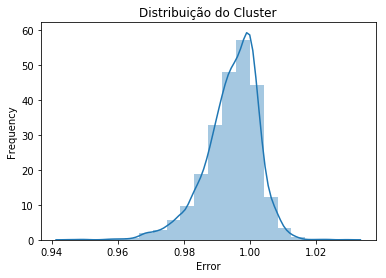

#------------------------------//------------------------------#
Cluster 2
Have 98 days
Representation: 12.61
Accumulated Representation: 75.55
Absolute Error: 0.0673
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 14:00:00


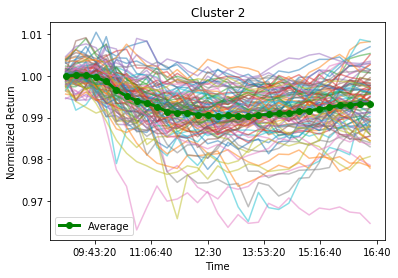

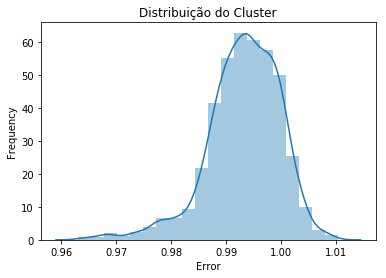

#------------------------------//------------------------------#
Cluster 3
Have 47 days
Representation: 6.05
Accumulated Representation: 81.60
Absolute Error: 0.0825
Mean Square Error: 0.0027
Upward Trend 09:15:00
Downtrend 13:45:00


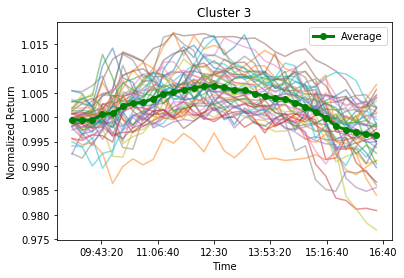

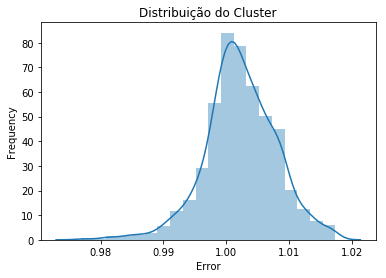

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -7.5163060635023555
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001977          0.804646          0.697064       0.00004
--------//--------
Generation:  2
Media Geração:  -7.313582965136436
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001908          0.801791          0.701863      0.000022
--------//--------
Generation:  3
Media Geração:  -7.0118329834773565
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001983          0.804002           0.70415     -0.000047
--------//--------
Generation:  4
Media Geração:  -6.413623459613855
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002384          0.785923          0.743871       0.00027
--------//--------
Generation:  5
Media Geração:  -6.018713800593053
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrel

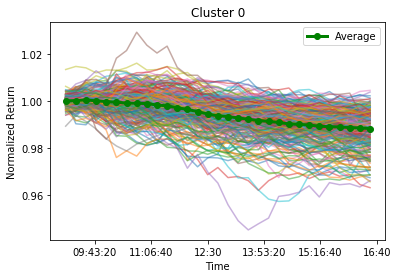

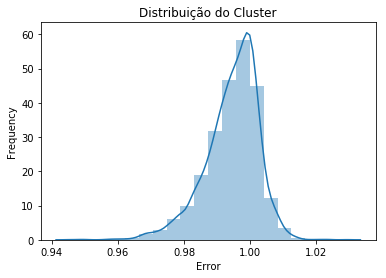

#------------------------------//------------------------------#
Cluster 1
Have 243 days
Representation: 30.41
Accumulated Representation: 60.83
Absolute Error: 0.0178
Mean Square Error: 0.0006
Upward Trend 09:15:00


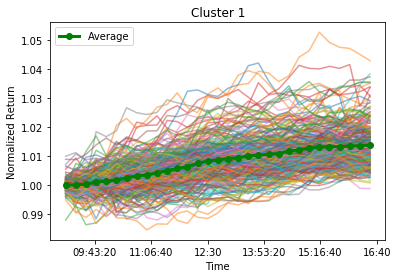

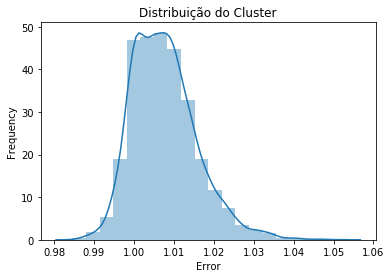

#------------------------------//------------------------------#
Cluster 2
Have 92 days
Representation: 11.51
Accumulated Representation: 72.34
Absolute Error: 0.0702
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 14:00:00


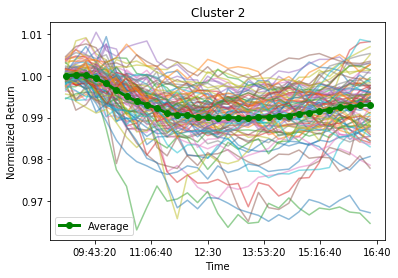

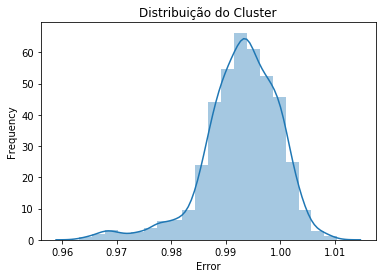

#------------------------------//------------------------------#
Cluster 3
Have 41 days
Representation: 5.13
Accumulated Representation: 77.47
Absolute Error: 0.0883
Mean Square Error: 0.0028
Upward Trend 09:15:00
Downtrend 13:00:00


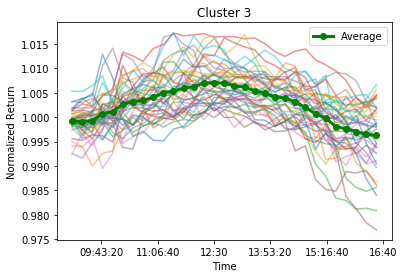

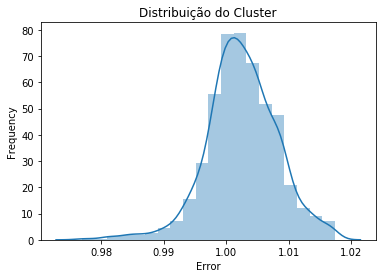

#------------------------------//------------------------------#
Cluster 4
Have 29 days
Representation: 3.63
Accumulated Representation: 81.10
Absolute Error: 0.0653
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


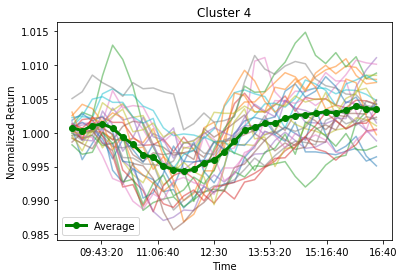

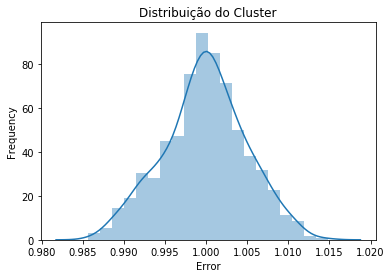

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -9.186619420892498
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002099          0.797095          0.697435     -0.000008
--------//--------
Generation:  2
Media Geração:  -8.985610687973914
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002099          0.797095          0.697435     -0.000008
--------//--------
Generation:  3
Media Geração:  -8.983366507808656
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002099          0.797095          0.697435     -0.000008
--------//--------
Generation:  4
Media Geração:  -8.981079451550036
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002099          0.797095          0.697435     -0.000008
--------//--------
Generation:  5
Media Geração:  -8.973257413560933
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelac

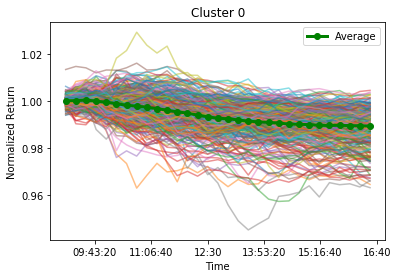

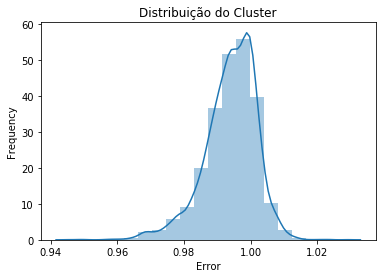

#------------------------------//------------------------------#
Cluster 1
Have 246 days
Representation: 30.11
Accumulated Representation: 69.52
Absolute Error: 0.0179
Mean Square Error: 0.0006
Upward Trend 09:15:00


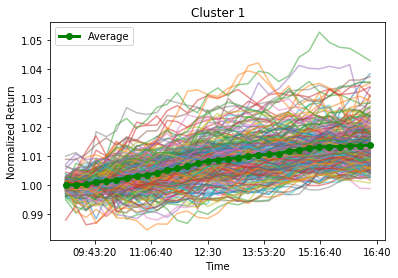

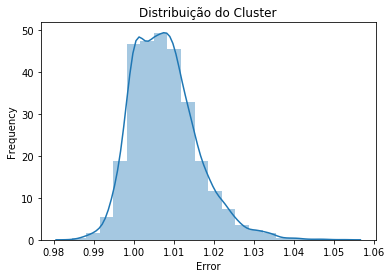

#------------------------------//------------------------------#
Cluster 2
Have 42 days
Representation: 5.14
Accumulated Representation: 74.66
Absolute Error: 0.0894
Mean Square Error: 0.0029
Upward Trend 09:15:00
Downtrend 13:00:00


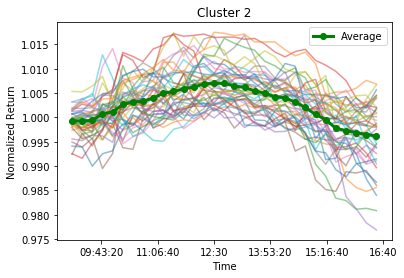

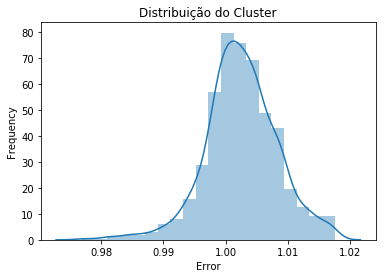

#------------------------------//------------------------------#
Cluster 3
Have 31 days
Representation: 3.79
Accumulated Representation: 78.46
Absolute Error: 0.0657
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


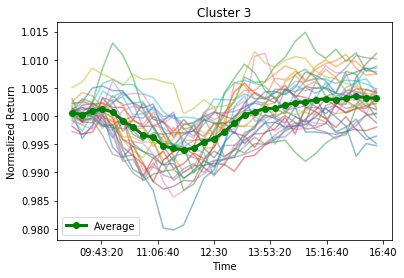

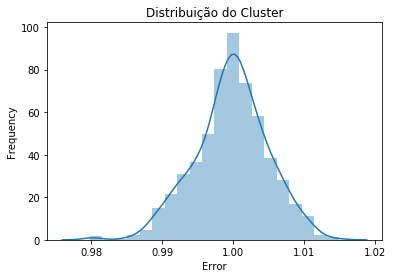

#------------------------------//------------------------------#
Cluster 4
Have 24 days
Representation: 2.94
Accumulated Representation: 81.40
Absolute Error: 0.0646
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 11:15:00
Downtrend 14:15:00


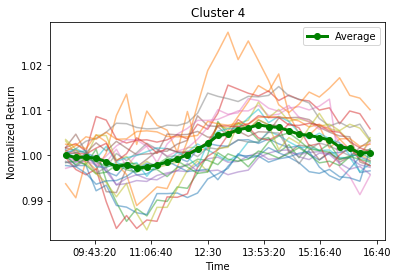

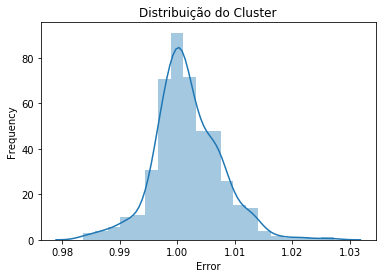

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -7.72721600555308
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0         0.002               0.8               0.7             0
--------//--------
Generation:  2
Media Geração:  -7.026767904549665
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002244          0.787535          0.700508      0.000055
--------//--------
Generation:  3
Media Geração:  -6.330403220885605
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002221           0.78437          0.708129      0.000126
--------//--------
Generation:  4
Media Geração:  -5.931078595652703
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002221           0.78437          0.708129      0.000126
--------//--------
Generation:  5
Media Geração:  -5.229390691626251
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelaca

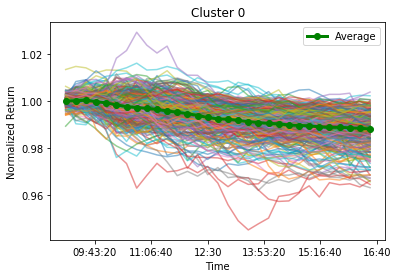

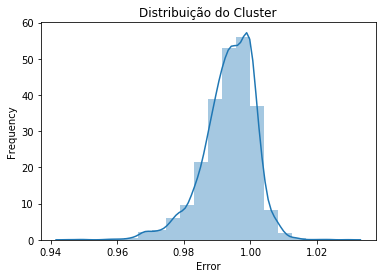

#------------------------------//------------------------------#
Cluster 1
Have 251 days
Representation: 29.92
Accumulated Representation: 65.55
Absolute Error: 0.0187
Mean Square Error: 0.0006
Upward Trend 09:15:00


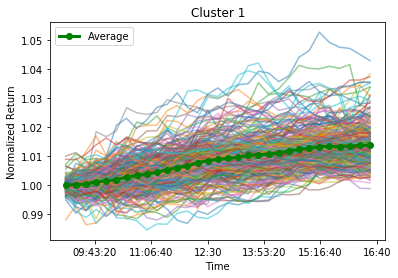

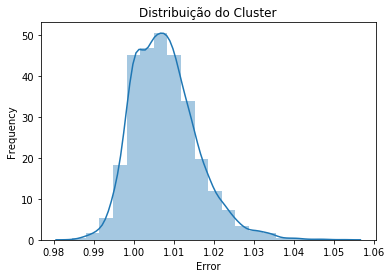

#------------------------------//------------------------------#
Cluster 2
Have 55 days
Representation: 6.56
Accumulated Representation: 72.11
Absolute Error: 0.0666
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 12:15:00


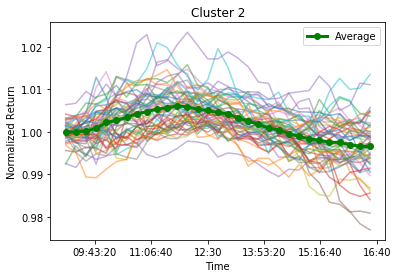

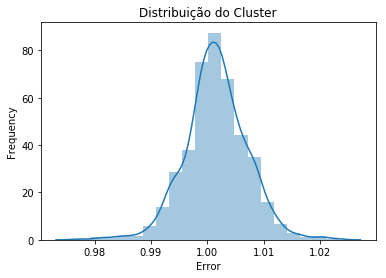

#------------------------------//------------------------------#
Cluster 3
Have 44 days
Representation: 5.24
Accumulated Representation: 77.35
Absolute Error: 0.0612
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:00:00


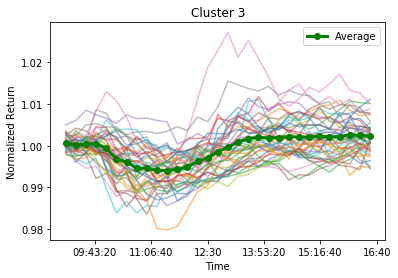

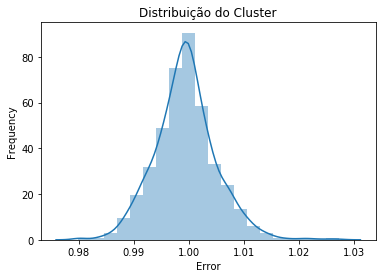

#------------------------------//------------------------------#
Cluster 4
Have 42 days
Representation: 5.01
Accumulated Representation: 82.36
Absolute Error: 0.0798
Mean Square Error: 0.0026
Downtrend 09:15:00
Upward Trend 14:00:00


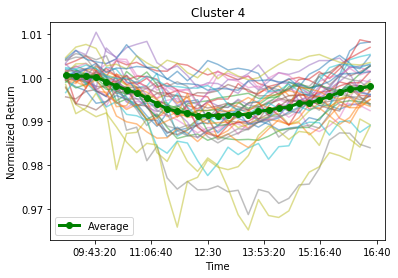

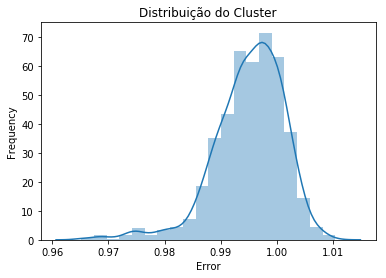

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -5.042656667674477
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001961           0.79575           0.69889     -0.000081
--------//--------
Generation:  2
Media Geração:  -4.940569498591279
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001961           0.79575           0.69889     -0.000081
--------//--------
Generation:  3
Media Geração:  -4.940569498591279
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001961           0.79575           0.69889     -0.000081
--------//--------
Generation:  4
Media Geração:  -4.940569498591279
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001961           0.79575           0.69889     -0.000081
--------//--------
Generation:  5
Media Geração:  -4.940050196836901
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelac

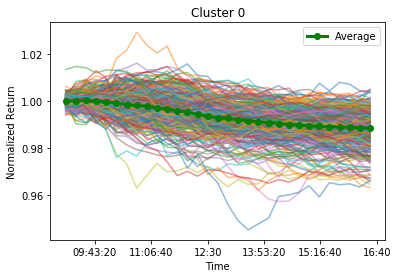

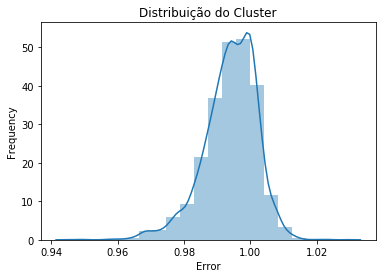

#------------------------------//------------------------------#
Cluster 1
Have 266 days
Representation: 30.93
Accumulated Representation: 65.93
Absolute Error: 0.0200
Mean Square Error: 0.0006
Upward Trend 09:15:00


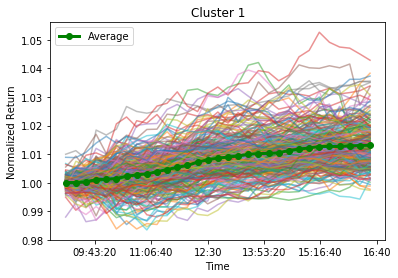

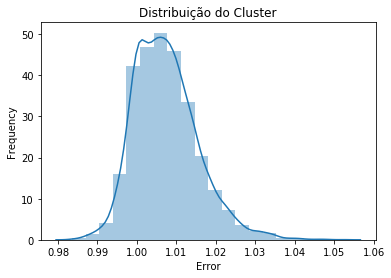

#------------------------------//------------------------------#
Cluster 2
Have 43 days
Representation: 5.00
Accumulated Representation: 70.93
Absolute Error: 0.0783
Mean Square Error: 0.0025
Downtrend 09:15:00
Upward Trend 12:45:00


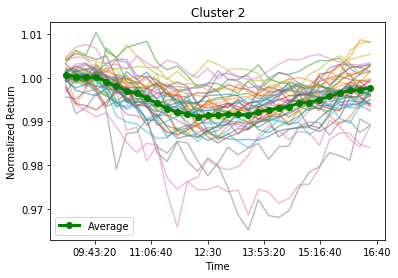

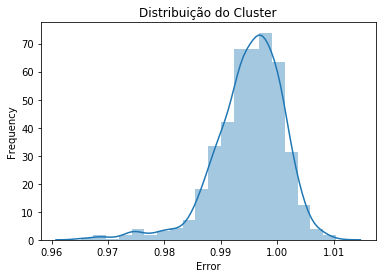

#------------------------------//------------------------------#
Cluster 3
Have 34 days
Representation: 3.95
Accumulated Representation: 74.88
Absolute Error: 0.0634
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 13:15:00


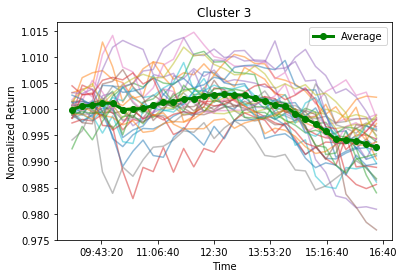

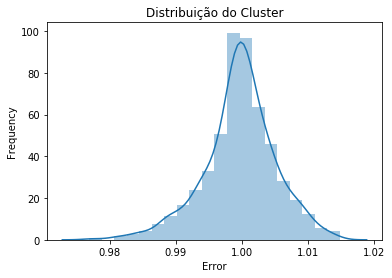

#------------------------------//------------------------------#
Cluster 4
Have 29 days
Representation: 3.37
Accumulated Representation: 78.26
Absolute Error: 0.0875
Mean Square Error: 0.0028
Upward Trend 09:15:00
Downtrend 13:00:00


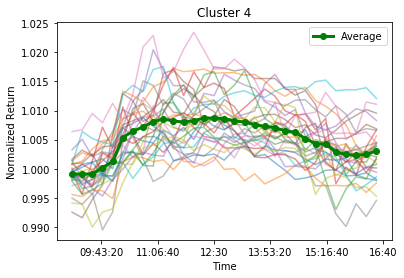

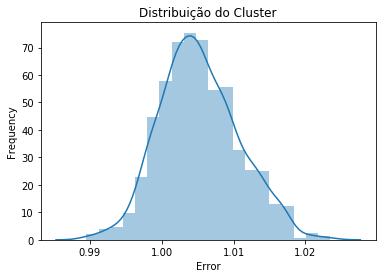

#------------------------------//------------------------------#
Cluster 5
Have 27 days
Representation: 3.14
Accumulated Representation: 81.40
Absolute Error: 0.0729
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 12:15:00


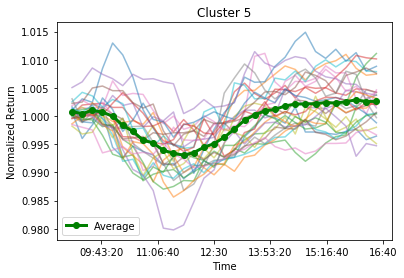

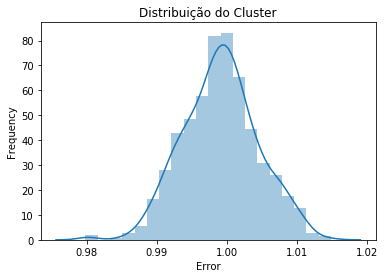

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -9.90013568983978
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0         0.002               0.8               0.7             0
--------//--------
Generation:  2
Media Geração:  -9.899558681431534
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0         0.002               0.8               0.7             0
--------//--------
Generation:  3
Media Geração:  -9.89898167302329
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0         0.002               0.8               0.7             0
--------//--------
Generation:  4
Media Geração:  -9.898025618813232
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0         0.002               0.8               0.7             0
--------//--------
Generation:  5
Media Geração:  -9.897532750238346
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao

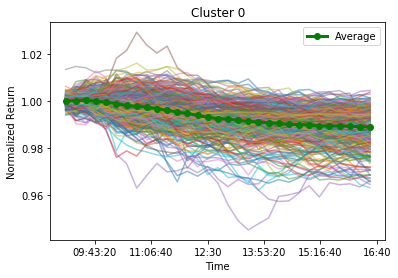

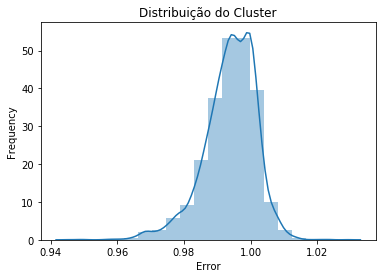

#------------------------------//------------------------------#
Cluster 1
Have 309 days
Representation: 35.07
Accumulated Representation: 72.53
Absolute Error: 0.0186
Mean Square Error: 0.0006
Upward Trend 09:15:00


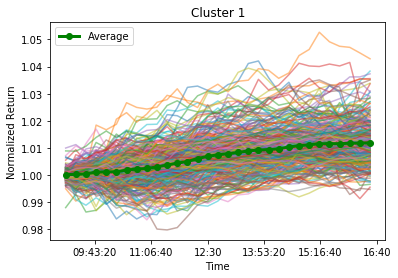

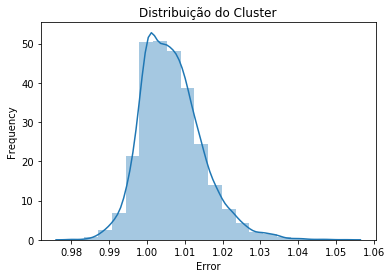

#------------------------------//------------------------------#
Cluster 2
Have 46 days
Representation: 5.22
Accumulated Representation: 77.75
Absolute Error: 0.0864
Mean Square Error: 0.0028
Upward Trend 09:15:00
Downtrend 13:15:00


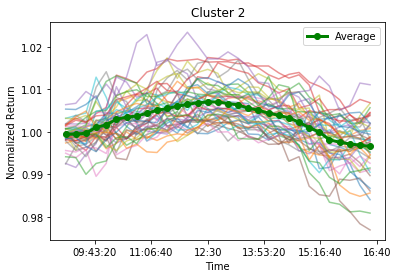

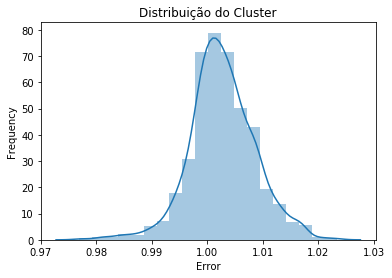

#------------------------------//------------------------------#
Cluster 3
Have 18 days
Representation: 2.04
Accumulated Representation: 79.80
Absolute Error: 0.0538
Mean Square Error: 0.0017
Upward Trend 09:15:00
Downtrend 12:15:00
Upward Trend 15:00:00


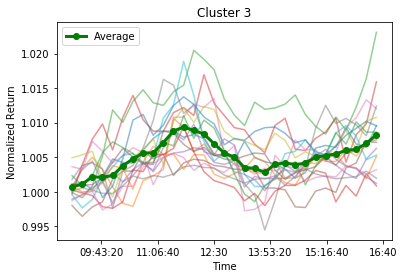

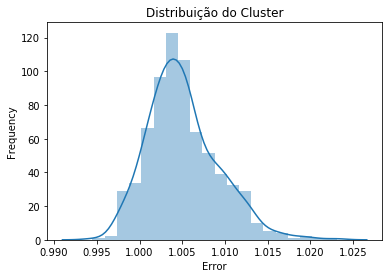

#------------------------------//------------------------------#
Cluster 4
Have 18 days
Representation: 2.04
Accumulated Representation: 81.84
Absolute Error: 0.0566
Mean Square Error: 0.0018
Upward Trend 09:15:00
Downtrend 11:00:00
Upward Trend 14:00:00


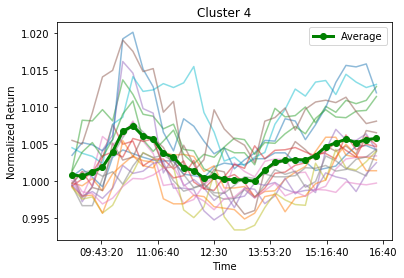

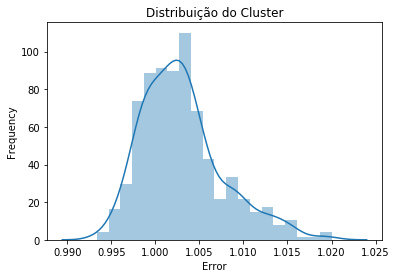

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -8.948653666987445
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002005          0.797604          0.701732      0.000083
--------//--------
Generation:  2
Media Geração:  -8.946250684464292
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001939          0.803555          0.696905      0.000155
--------//--------
Generation:  3
Media Geração:  -8.941822311251297
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001939          0.803555          0.696905      0.000155
--------//--------
Generation:  4
Media Geração:  -8.937731140908216
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001939          0.803555          0.696905      0.000155
--------//--------
Generation:  5
Media Geração:  -8.936408429717186
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelac

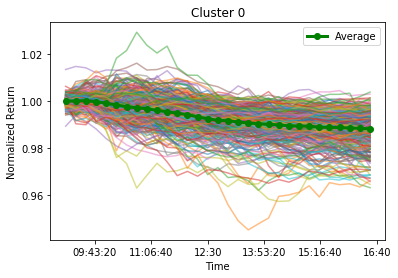

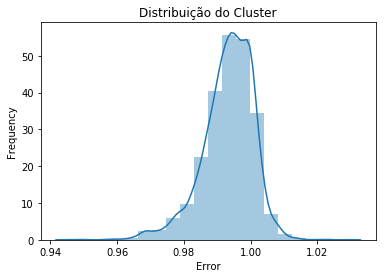

#------------------------------//------------------------------#
Cluster 1
Have 279 days
Representation: 30.86
Accumulated Representation: 64.49
Absolute Error: 0.0197
Mean Square Error: 0.0006
Upward Trend 09:15:00


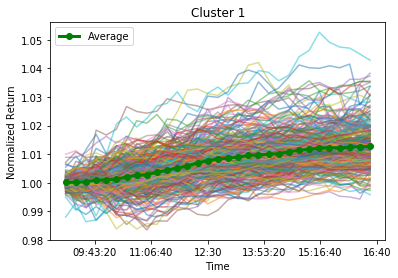

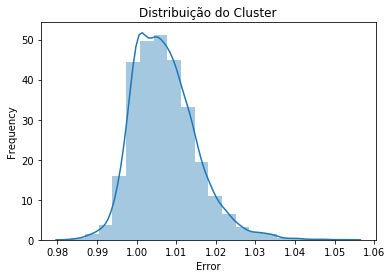

#------------------------------//------------------------------#
Cluster 2
Have 61 days
Representation: 6.75
Accumulated Representation: 71.24
Absolute Error: 0.0647
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 12:15:00


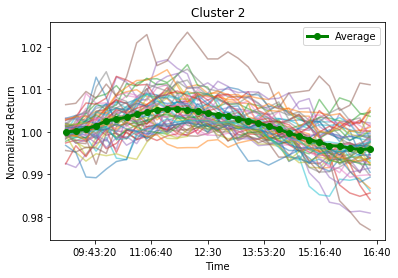

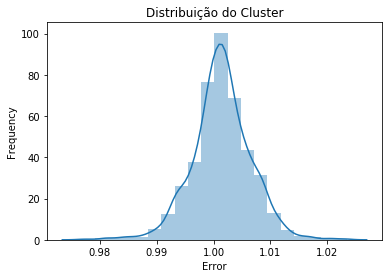

#------------------------------//------------------------------#
Cluster 3
Have 44 days
Representation: 4.87
Accumulated Representation: 76.11
Absolute Error: 0.0794
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 14:15:00


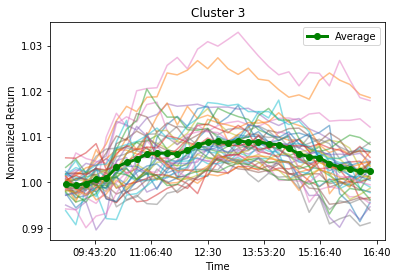

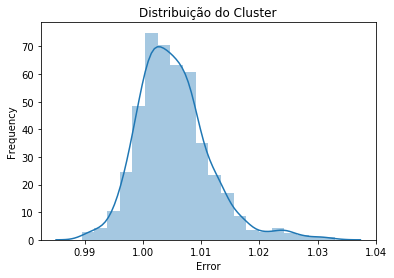

#------------------------------//------------------------------#
Cluster 4
Have 37 days
Representation: 4.09
Accumulated Representation: 80.20
Absolute Error: 0.0704
Mean Square Error: 0.0023
Upward Trend 09:15:00
Downtrend 10:15:00
Upward Trend 12:15:00


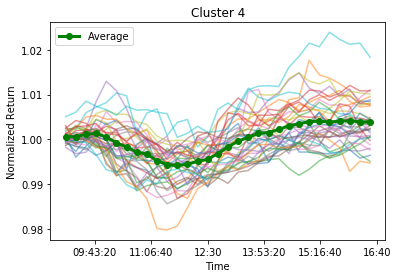

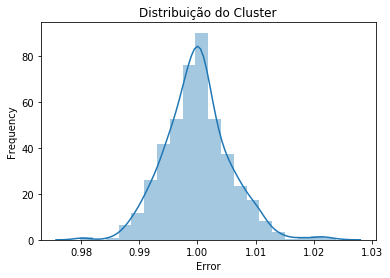

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -5.973426540027498
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002069          0.797514          0.701211      0.000082
--------//--------
Generation:  2
Media Geração:  -5.967140543173296
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001909          0.793459          0.698974     -0.000053
--------//--------
Generation:  3
Media Geração:  -5.962554112488325
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001395          0.788251           0.70058      0.000226
--------//--------
Generation:  4
Media Geração:  -5.960807941832527
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001781          0.792044          0.706501      0.000156
--------//--------
Generation:  5
Media Geração:  -5.95956465901424
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelaca

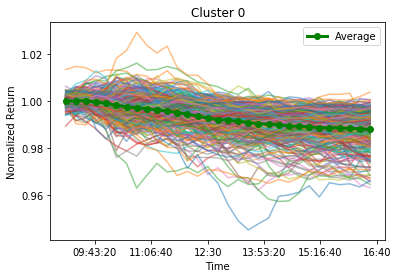

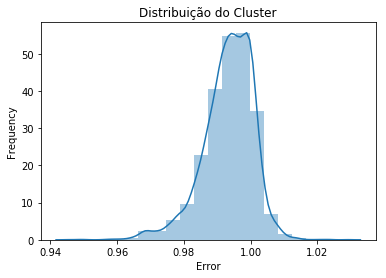

#------------------------------//------------------------------#
Cluster 1
Have 287 days
Representation: 31.06
Accumulated Representation: 63.20
Absolute Error: 0.0185
Mean Square Error: 0.0006
Upward Trend 09:15:00


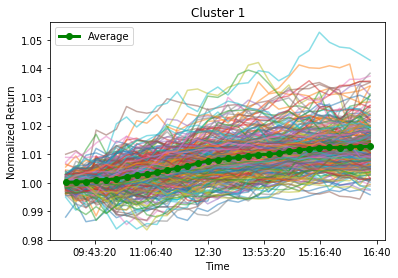

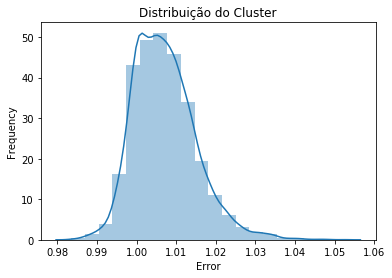

#------------------------------//------------------------------#
Cluster 2
Have 62 days
Representation: 6.71
Accumulated Representation: 69.91
Absolute Error: 0.0619
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:15:00


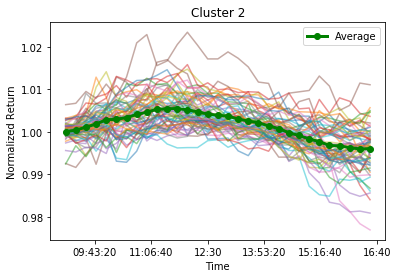

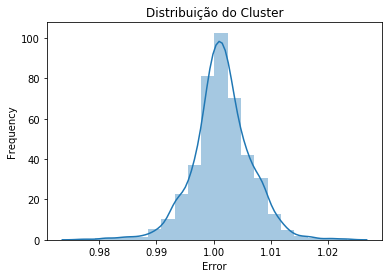

#------------------------------//------------------------------#
Cluster 3
Have 52 days
Representation: 5.63
Accumulated Representation: 75.54
Absolute Error: 0.0771
Mean Square Error: 0.0025
Downtrend 09:15:00
Upward Trend 13:15:00


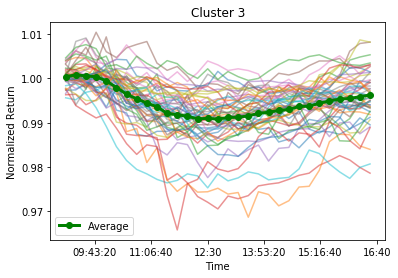

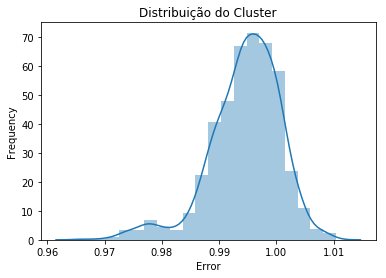

#------------------------------//------------------------------#
Cluster 4
Have 43 days
Representation: 4.65
Accumulated Representation: 80.19
Absolute Error: 0.0796
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 13:45:00


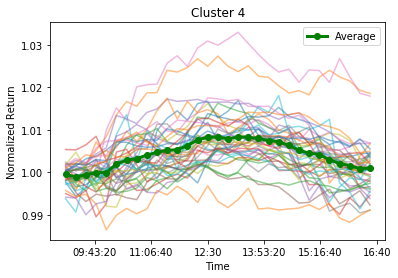

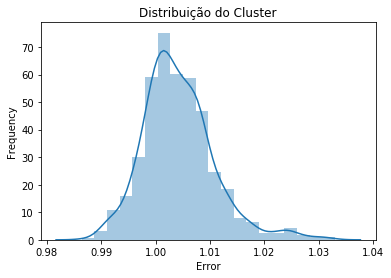

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -11.895563966846211
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002098          0.799428          0.698658     -0.000043
--------//--------
Generation:  2
Media Geração:  -11.894834110395532
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002098          0.799428          0.698658     -0.000043
--------//--------
Generation:  3
Media Geração:  -11.894340900275328
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002098          0.799428          0.698658     -0.000043
--------//--------
Generation:  4
Media Geração:  -11.894066838909481
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002459          0.799933          0.697968     -0.000042
--------//--------
Generation:  5
Media Geração:  -11.894025505208148
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCor

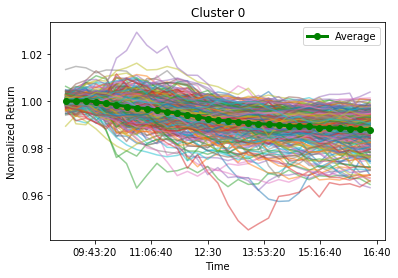

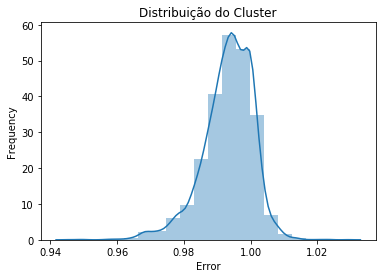

#------------------------------//------------------------------#
Cluster 1
Have 301 days
Representation: 31.85
Accumulated Representation: 63.70
Absolute Error: 0.0183
Mean Square Error: 0.0006
Upward Trend 09:15:00


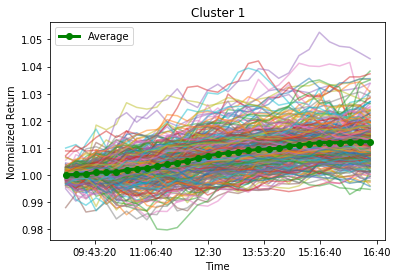

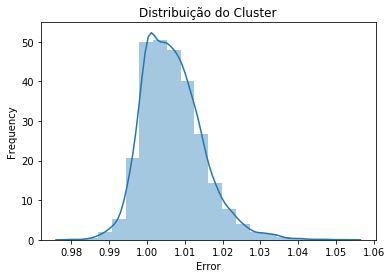

#------------------------------//------------------------------#
Cluster 2
Have 72 days
Representation: 7.62
Accumulated Representation: 71.32
Absolute Error: 0.0618
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:15:00


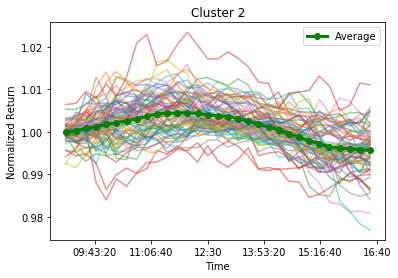

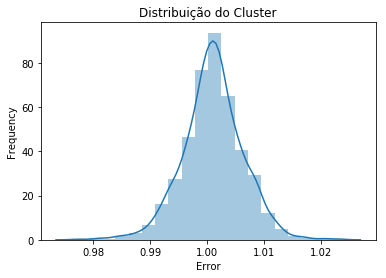

#------------------------------//------------------------------#
Cluster 3
Have 60 days
Representation: 6.35
Accumulated Representation: 77.67
Absolute Error: 0.0765
Mean Square Error: 0.0025
Downtrend 09:15:00
Upward Trend 13:15:00


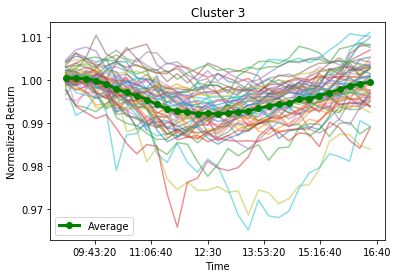

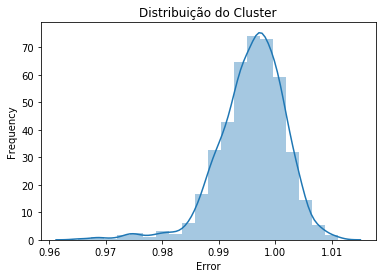

#------------------------------//------------------------------#
Cluster 4
Have 47 days
Representation: 4.97
Accumulated Representation: 82.65
Absolute Error: 0.0758
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 14:15:00


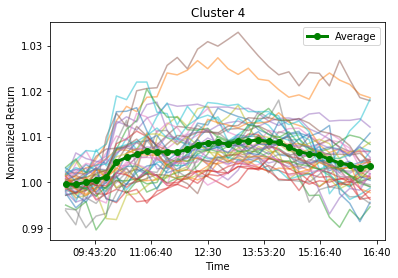

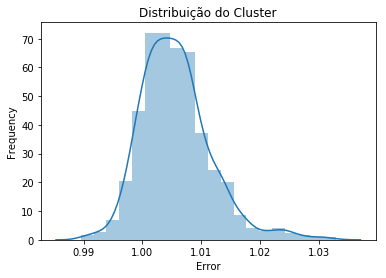

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -9.940552276693753
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001964          0.795938          0.711477     -0.000071
--------//--------
Generation:  2
Media Geração:  -9.940552276693753
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001964          0.795938          0.711477     -0.000071
--------//--------
Generation:  3
Media Geração:  -9.940291492073515
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001964          0.795938          0.711477     -0.000071
--------//--------
Generation:  4
Media Geração:  -9.939358021599919
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0         0.002               0.8               0.7             0
--------//--------
Generation:  5
Media Geração:  -9.93894916895586
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelaca

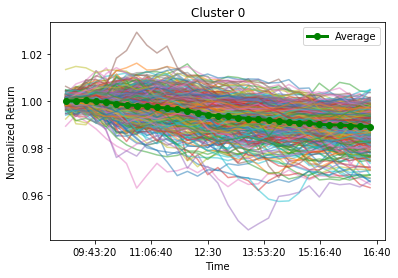

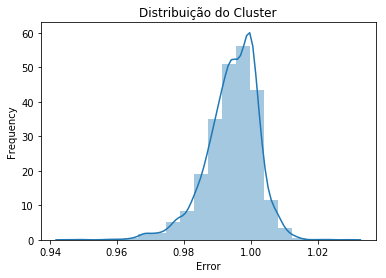

#------------------------------//------------------------------#
Cluster 1
Have 333 days
Representation: 34.54
Accumulated Representation: 73.24
Absolute Error: 0.0183
Mean Square Error: 0.0006
Upward Trend 09:15:00


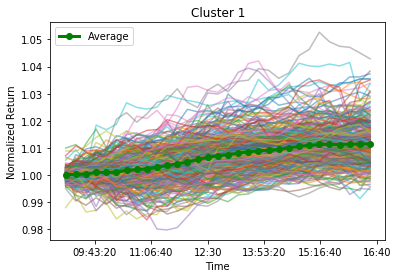

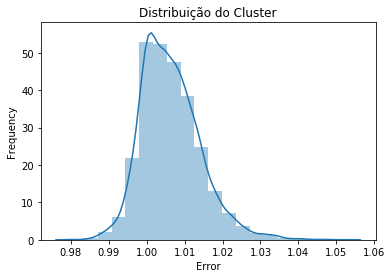

#------------------------------//------------------------------#
Cluster 2
Have 46 days
Representation: 4.77
Accumulated Representation: 78.01
Absolute Error: 0.0797
Mean Square Error: 0.0026
Downtrend 09:15:00
Upward Trend 14:00:00


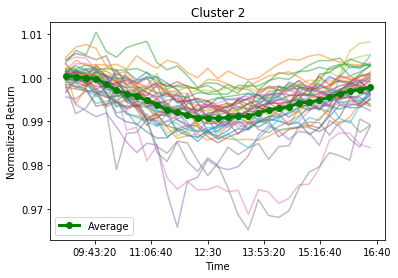

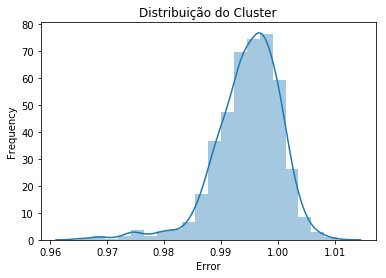

#------------------------------//------------------------------#
Cluster 3
Have 45 days
Representation: 4.67
Accumulated Representation: 82.68
Absolute Error: 0.0826
Mean Square Error: 0.0027
Upward Trend 09:15:00
Downtrend 13:45:00


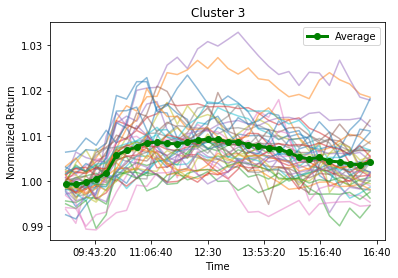

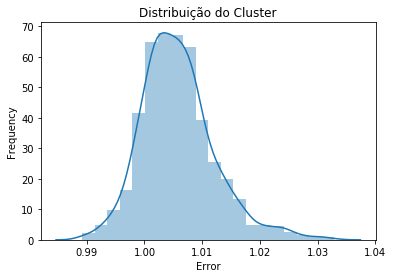

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -9.915734669477967
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001899          0.800393          0.706914       0.00005
--------//--------
Generation:  2
Media Geração:  -9.913200139720821
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001853          0.795517          0.704623      0.000009
--------//--------
Generation:  3
Media Geração:  -9.910069556043975
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001948          0.788759          0.713447      0.000476
--------//--------
Generation:  4
Media Geração:  -9.907330098976677
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001731          0.777375          0.707951      0.000806
--------//--------
Generation:  5
Media Geração:  -9.905468265036173
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelac

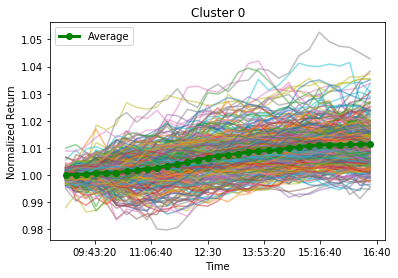

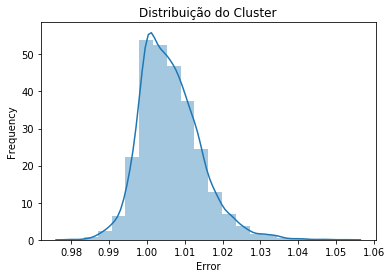

#------------------------------//------------------------------#
Cluster 1
Have 281 days
Representation: 28.59
Accumulated Representation: 62.56
Absolute Error: 0.0259
Mean Square Error: 0.0008
Upward Trend 09:15:00
Downtrend 10:00:00


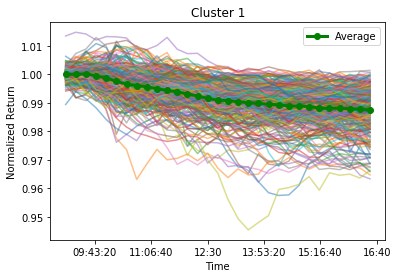

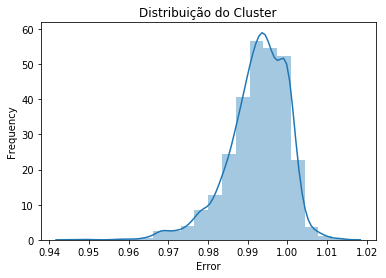

#------------------------------//------------------------------#
Cluster 2
Have 110 days
Representation: 11.19
Accumulated Representation: 73.75
Absolute Error: 0.0551
Mean Square Error: 0.0018
Upward Trend 09:15:00
Downtrend 12:00:00


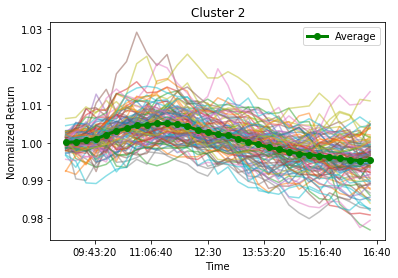

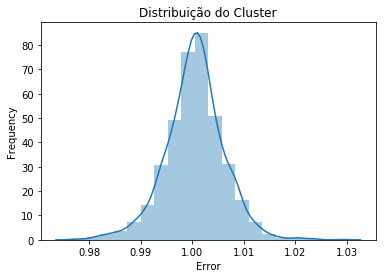

#------------------------------//------------------------------#
Cluster 3
Have 48 days
Representation: 4.88
Accumulated Representation: 78.64
Absolute Error: 0.0758
Mean Square Error: 0.0024
Downtrend 09:15:00
Upward Trend 13:15:00


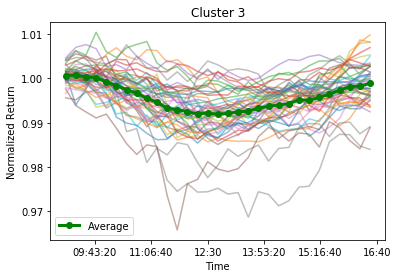

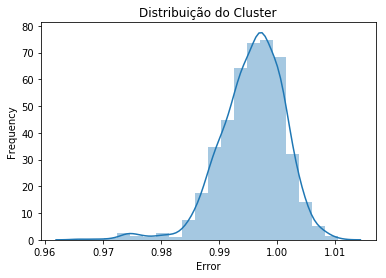

#------------------------------//------------------------------#
Cluster 4
Have 38 days
Representation: 3.87
Accumulated Representation: 82.50
Absolute Error: 0.0807
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 11:30:00
Upward Trend 12:15:00
Downtrend 13:45:00


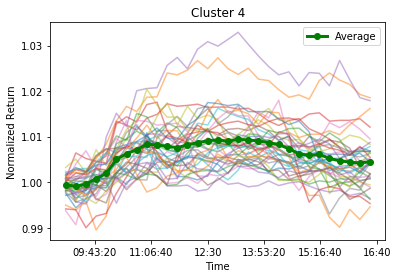

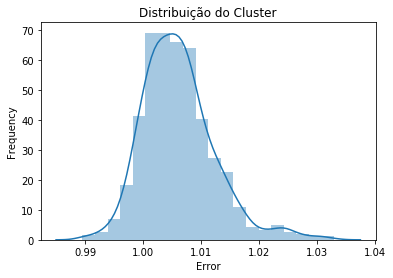

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -6.925823977830753
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001962          0.804319          0.695202      0.000091
--------//--------
Generation:  2
Media Geração:  -6.91895326192539
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001962          0.804319          0.695202      0.000091
--------//--------
Generation:  3
Media Geração:  -6.916941397467186
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001962          0.804319          0.695202      0.000091
--------//--------
Generation:  4
Media Geração:  -6.905279400694137
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001917          0.804667          0.700909      0.000076
--------//--------
Generation:  5
Media Geração:  -6.707660416673019
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelaca

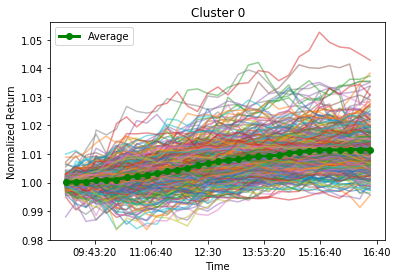

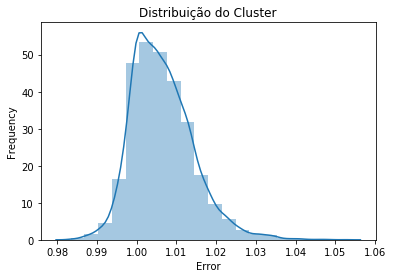

#------------------------------//------------------------------#
Cluster 1
Have 282 days
Representation: 28.09
Accumulated Representation: 61.45
Absolute Error: 0.0258
Mean Square Error: 0.0008
Upward Trend 09:15:00
Downtrend 10:00:00


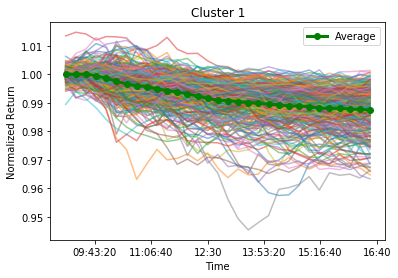

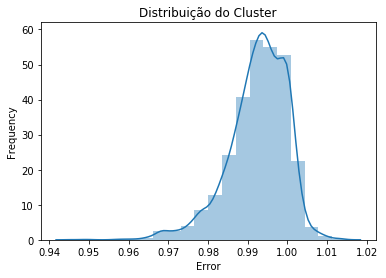

#------------------------------//------------------------------#
Cluster 2
Have 113 days
Representation: 11.25
Accumulated Representation: 72.71
Absolute Error: 0.0544
Mean Square Error: 0.0018
Upward Trend 09:15:00
Downtrend 12:00:00


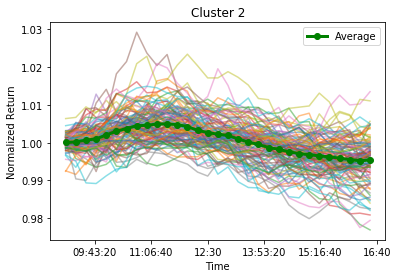

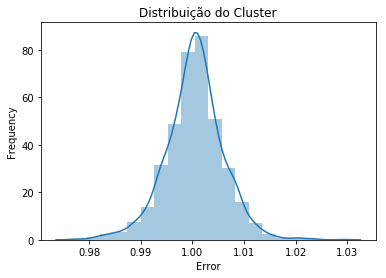

#------------------------------//------------------------------#
Cluster 3
Have 45 days
Representation: 4.48
Accumulated Representation: 77.19
Absolute Error: 0.0757
Mean Square Error: 0.0024
Downtrend 09:15:00
Upward Trend 13:15:00


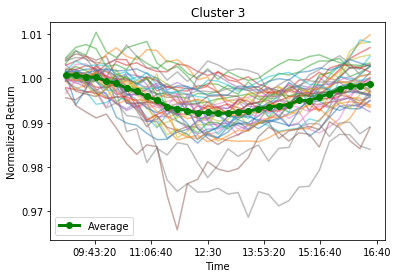

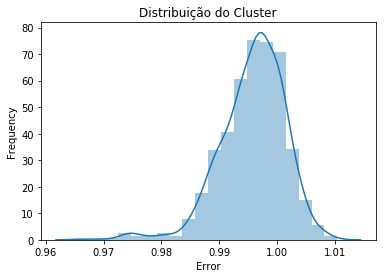

#------------------------------//------------------------------#
Cluster 4
Have 37 days
Representation: 3.69
Accumulated Representation: 80.88
Absolute Error: 0.0823
Mean Square Error: 0.0027
Upward Trend 09:15:00
Downtrend 11:30:00
Upward Trend 12:15:00
Downtrend 13:45:00


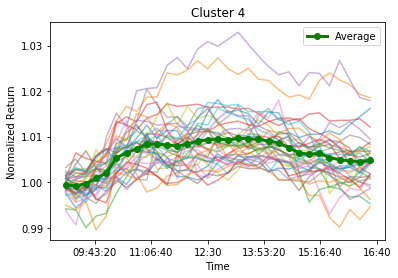

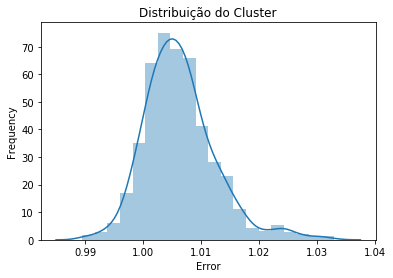

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -2.9511532403566276
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002007          0.799088          0.703685      0.000081
--------//--------
Generation:  2
Media Geração:  -2.9484514628965877
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002092          0.796812          0.695753     -0.000053
--------//--------
Generation:  3
Media Geração:  -2.946921719853205
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002092          0.796812          0.695753     -0.000053
--------//--------
Generation:  4
Media Geração:  -2.9463092225769687
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002067          0.778662          0.724429     -0.000126
--------//--------
Generation:  5
Media Geração:  -2.9453075970955265
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorr

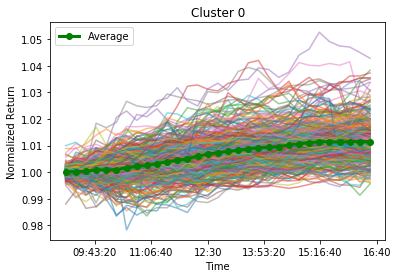

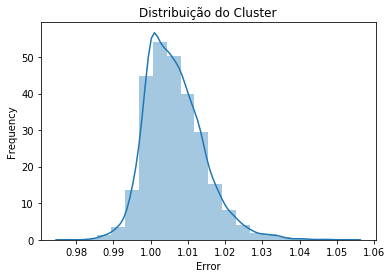

#------------------------------//------------------------------#
Cluster 1
Have 311 days
Representation: 30.46
Accumulated Representation: 64.05
Absolute Error: 0.0316
Mean Square Error: 0.0010
Upward Trend 09:15:00
Downtrend 10:00:00


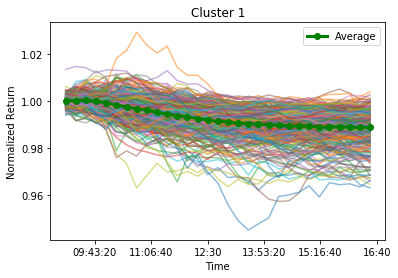

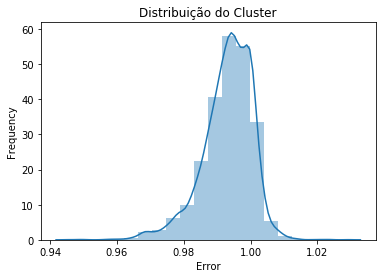

#------------------------------//------------------------------#
Cluster 2
Have 93 days
Representation: 9.11
Accumulated Representation: 73.16
Absolute Error: 0.0627
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 12:00:00


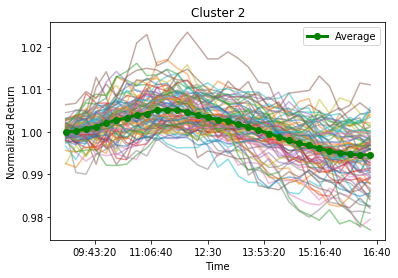

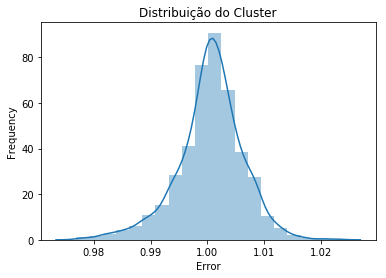

#------------------------------//------------------------------#
Cluster 3
Have 39 days
Representation: 3.82
Accumulated Representation: 76.98
Absolute Error: 0.0804
Mean Square Error: 0.0026
Upward Trend 09:15:00
Downtrend 11:30:00
Upward Trend 12:15:00
Downtrend 13:45:00


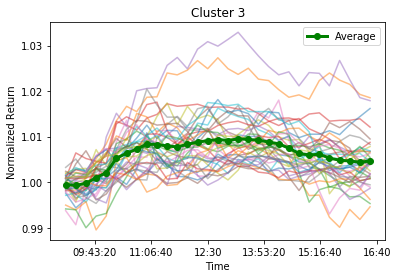

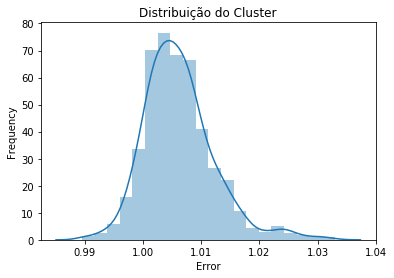

#------------------------------//------------------------------#
Cluster 4
Have 32 days
Representation: 3.13
Accumulated Representation: 80.12
Absolute Error: 0.0630
Mean Square Error: 0.0020
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 12:15:00


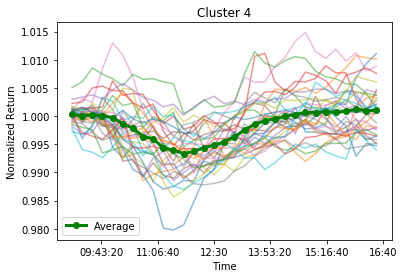

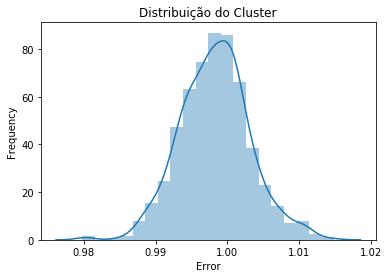

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -5.3695245584449784
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002009          0.790796          0.693111      0.000085
--------//--------
Generation:  2
Media Geração:  -5.2696196831658
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0         0.002               0.8               0.7             0
--------//--------
Generation:  3
Media Geração:  -5.167294303118192
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002208          0.784516          0.705454      0.000162
--------//--------
Generation:  4
Media Geração:  -5.166334514501223
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002208          0.784516          0.705454      0.000162
--------//--------
Generation:  5
Media Geração:  -5.065864999378637
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelaca

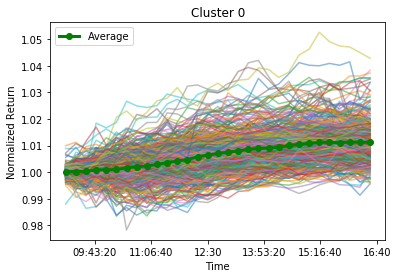

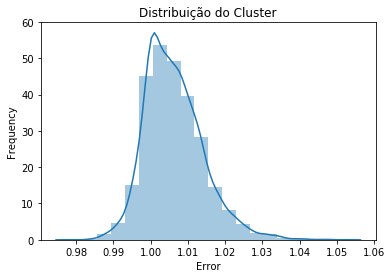

#------------------------------//------------------------------#
Cluster 1
Have 297 days
Representation: 28.50
Accumulated Representation: 62.96
Absolute Error: 0.0288
Mean Square Error: 0.0009
Upward Trend 09:15:00
Downtrend 10:00:00


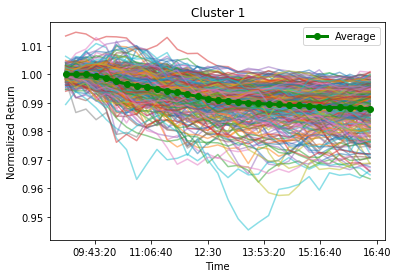

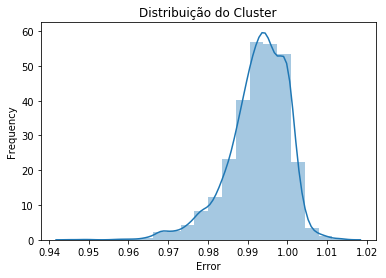

#------------------------------//------------------------------#
Cluster 2
Have 127 days
Representation: 12.19
Accumulated Representation: 75.14
Absolute Error: 0.0550
Mean Square Error: 0.0018
Upward Trend 09:15:00
Downtrend 11:45:00


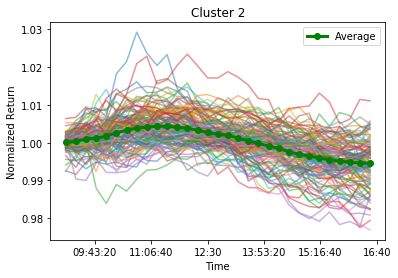

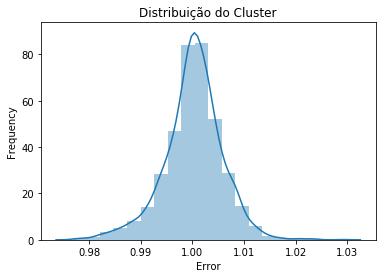

#------------------------------//------------------------------#
Cluster 3
Have 41 days
Representation: 3.93
Accumulated Representation: 79.08
Absolute Error: 0.0691
Mean Square Error: 0.0022
Downtrend 09:15:00
Upward Trend 13:15:00


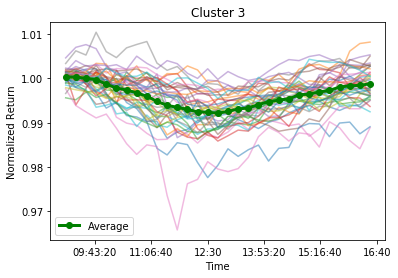

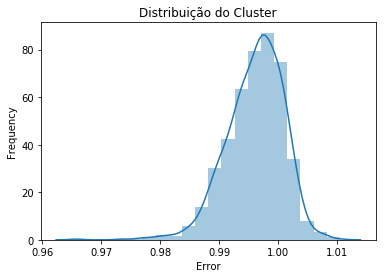

#------------------------------//------------------------------#
Cluster 4
Have 38 days
Representation: 3.65
Accumulated Representation: 82.73
Absolute Error: 0.0744
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 11:30:00
Upward Trend 12:15:00
Downtrend 14:15:00


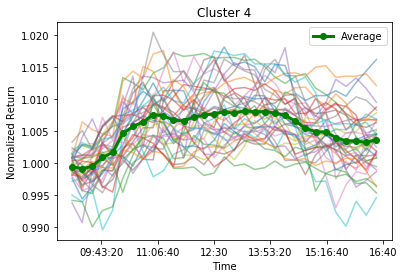

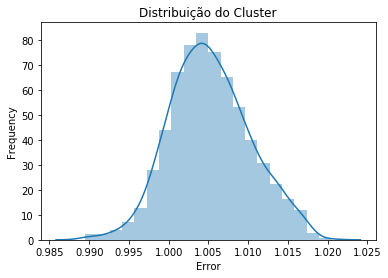

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -10.309171319698978
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0         0.002               0.8               0.7             0
--------//--------
Generation:  2
Media Geração:  -10.106546474309877
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002005           0.80459            0.6963      0.000202
--------//--------
Generation:  3
Media Geração:  -10.105776619092131
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001841          0.809165          0.696423      0.000432
--------//--------
Generation:  4
Media Geração:  -10.104714246448951
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002005          0.804354          0.699376      0.000068
--------//--------
Generation:  5
Media Geração:  -10.002540385312184
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCor

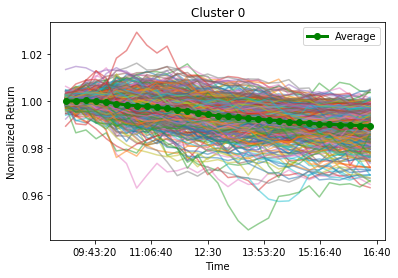

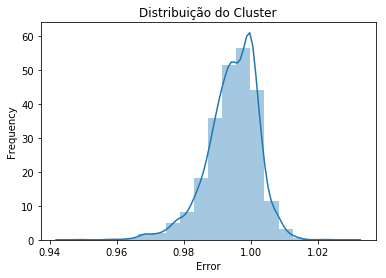

#------------------------------//------------------------------#
Cluster 1
Have 341 days
Representation: 32.08
Accumulated Representation: 71.21
Absolute Error: 0.0231
Mean Square Error: 0.0007
Upward Trend 09:15:00


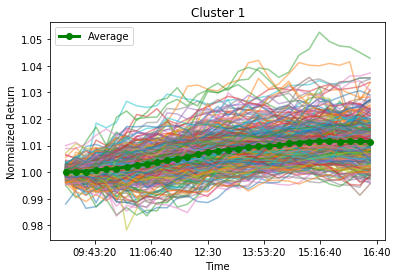

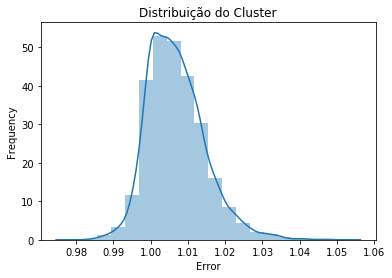

#------------------------------//------------------------------#
Cluster 2
Have 76 days
Representation: 7.15
Accumulated Representation: 78.36
Absolute Error: 0.0732
Mean Square Error: 0.0024
Downtrend 09:15:00
Upward Trend 13:15:00


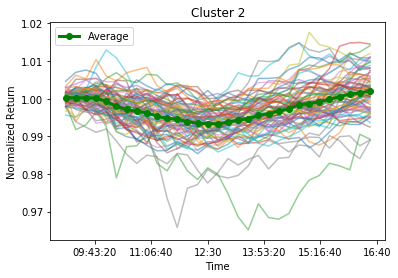

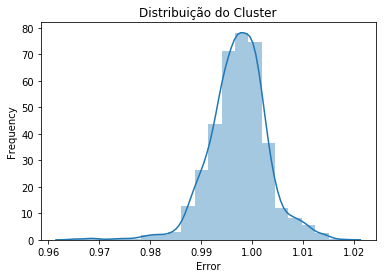

#------------------------------//------------------------------#
Cluster 3
Have 45 days
Representation: 4.23
Accumulated Representation: 82.60
Absolute Error: 0.0733
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 11:30:00


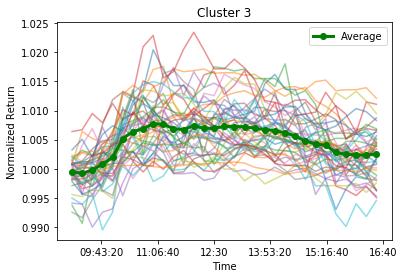

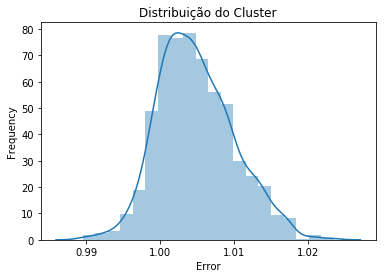

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -10.306092005801764
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001915          0.793522          0.688548     -0.000051
--------//--------
Generation:  2
Media Geração:  -10.306055992476738
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001915          0.793522          0.688548     -0.000051
--------//--------
Generation:  3
Media Geração:  -10.106366263026686
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001915          0.793522          0.688548     -0.000051
--------//--------
Generation:  4
Media Geração:  -10.106348700166237
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001915          0.793522          0.688548     -0.000051
--------//--------
Generation:  5
Media Geração:  -10.106348700166237
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCor

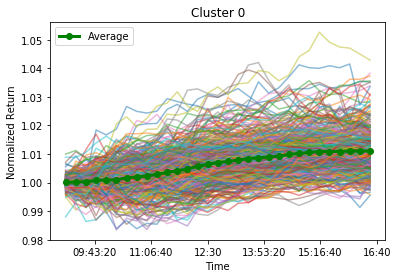

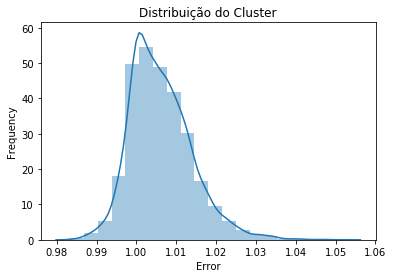

#------------------------------//------------------------------#
Cluster 1
Have 371 days
Representation: 34.23
Accumulated Representation: 69.46
Absolute Error: 0.0216
Mean Square Error: 0.0007
Upward Trend 09:15:00
Downtrend 10:00:00


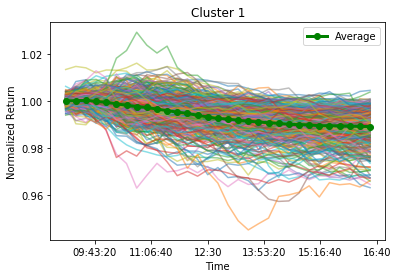

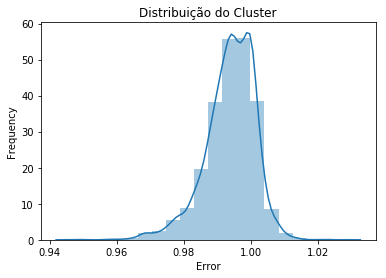

#------------------------------//------------------------------#
Cluster 2
Have 55 days
Representation: 5.07
Accumulated Representation: 74.54
Absolute Error: 0.0648
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 10:45:00
Downtrend 13:30:00


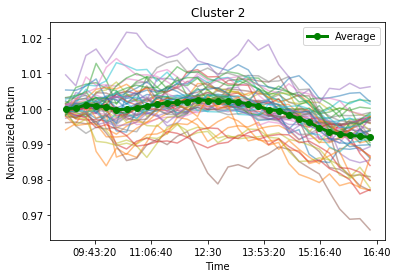

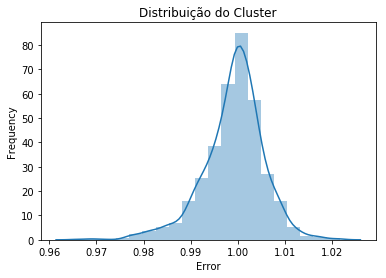

#------------------------------//------------------------------#
Cluster 3
Have 50 days
Representation: 4.61
Accumulated Representation: 79.15
Absolute Error: 0.0694
Mean Square Error: 0.0022
Downtrend 09:15:00
Upward Trend 13:15:00


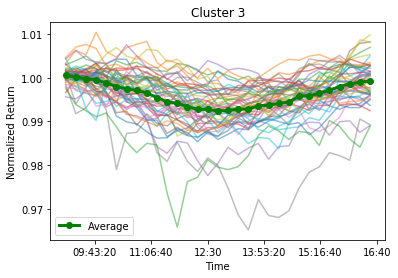

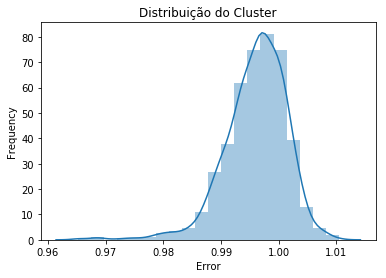

#------------------------------//------------------------------#
Cluster 4
Have 36 days
Representation: 3.32
Accumulated Representation: 82.47
Absolute Error: 0.0775
Mean Square Error: 0.0025
Upward Trend 09:15:00
Downtrend 11:30:00
Upward Trend 12:15:00
Downtrend 14:15:00


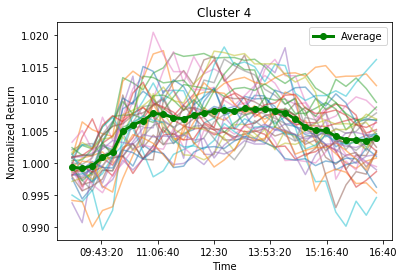

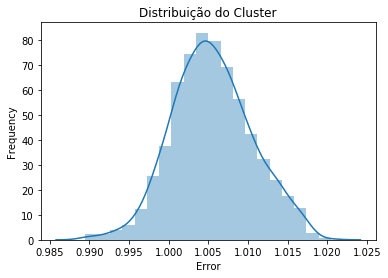

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -6.220156494896289
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002131           0.80836          0.699728      0.000262
--------//--------
Generation:  2
Media Geração:  -6.118841137293219
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002131           0.80836          0.699728      0.000262
--------//--------
Generation:  3
Media Geração:  -6.118235477047861
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002131           0.80836          0.699728      0.000262
--------//--------
Generation:  4
Media Geração:  -6.118235477047861
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002131           0.80836          0.699728      0.000262
--------//--------
Generation:  5
Media Geração:  -6.118124185331065
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelac

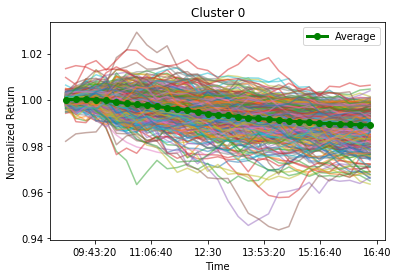

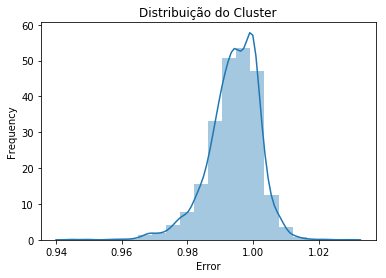

#------------------------------//------------------------------#
Cluster 1
Have 386 days
Representation: 34.93
Accumulated Representation: 72.22
Absolute Error: 0.0186
Mean Square Error: 0.0006
Upward Trend 09:15:00


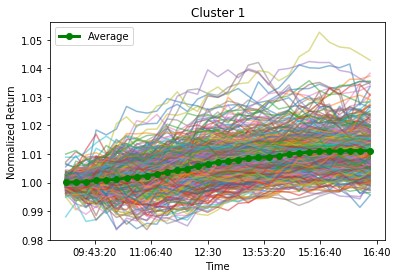

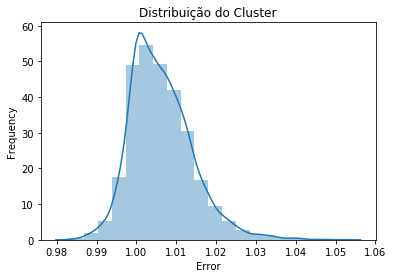

#------------------------------//------------------------------#
Cluster 2
Have 67 days
Representation: 6.06
Accumulated Representation: 78.28
Absolute Error: 0.0676
Mean Square Error: 0.0022
Downtrend 09:15:00
Upward Trend 12:45:00


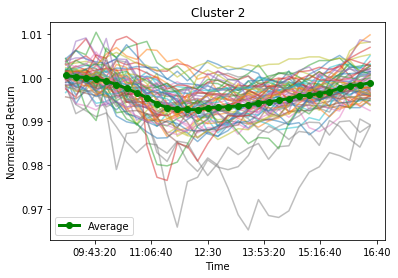

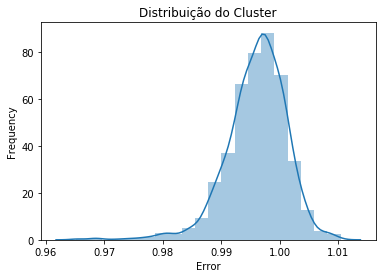

#------------------------------//------------------------------#
Cluster 3
Have 62 days
Representation: 5.61
Accumulated Representation: 83.89
Absolute Error: 0.0696
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 13:15:00


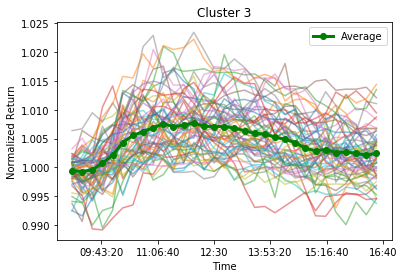

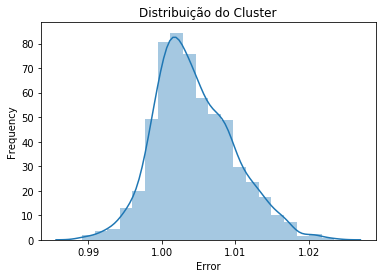

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -14.806961474263662
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001924          0.805288          0.700326      0.000147
--------//--------
Generation:  2
Media Geração:  -14.806961474263662
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001924          0.805288          0.700326      0.000147
--------//--------
Generation:  3
Media Geração:  -14.806961474263662
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001924          0.805288          0.700326      0.000147
--------//--------
Generation:  4
Media Geração:  -14.806961474263662
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001924          0.805288          0.700326      0.000147
--------//--------
Generation:  5
Media Geração:  -14.806961474263662
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCor

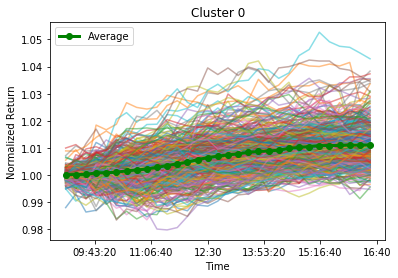

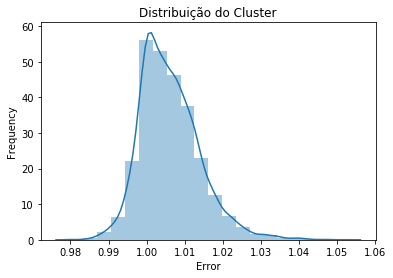

#------------------------------//------------------------------#
Cluster 1
Have 369 days
Representation: 32.77
Accumulated Representation: 67.85
Absolute Error: 0.0237
Mean Square Error: 0.0008
Upward Trend 09:15:00
Downtrend 10:00:00


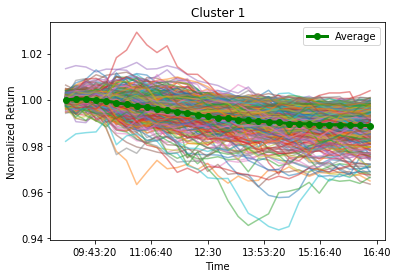

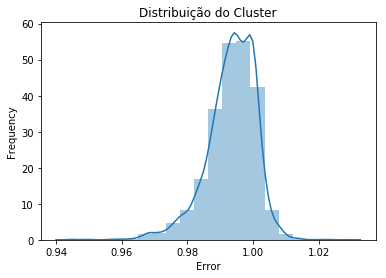

#------------------------------//------------------------------#
Cluster 2
Have 114 days
Representation: 10.12
Accumulated Representation: 77.98
Absolute Error: 0.0670
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 12:45:00


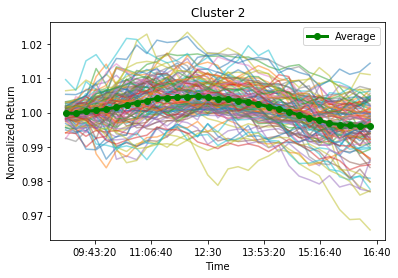

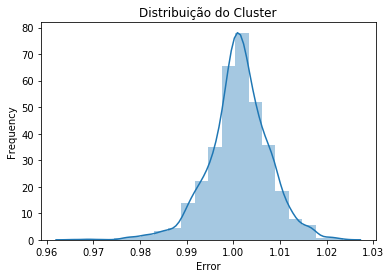

#------------------------------//------------------------------#
Cluster 3
Have 53 days
Representation: 4.71
Accumulated Representation: 82.68
Absolute Error: 0.0721
Mean Square Error: 0.0023
Downtrend 09:15:00
Upward Trend 13:15:00


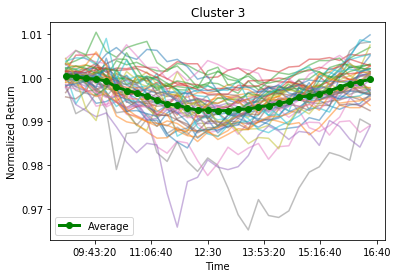

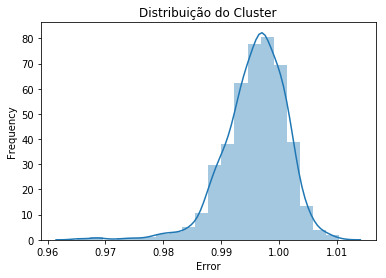

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -8.943569360209935
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002185          0.799586          0.697866      0.000022
--------//--------
Generation:  2
Media Geração:  -8.939010052969014
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002084          0.802638          0.701147      0.000086
--------//--------
Generation:  3
Media Geração:  -8.938084694278505
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002022           0.79831          0.699327      0.000187
--------//--------
Generation:  4
Media Geração:  -8.935724654844943
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001825          0.785321          0.707087      0.000341
--------//--------
Generation:  5
Media Geração:  -8.532172030103775
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelac

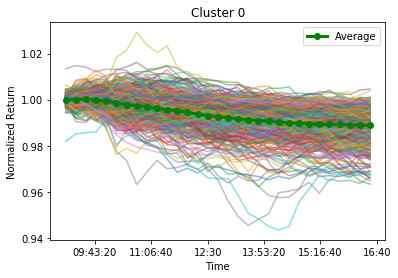

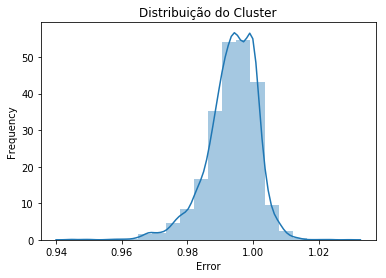

#------------------------------//------------------------------#
Cluster 1
Have 341 days
Representation: 29.68
Accumulated Representation: 64.75
Absolute Error: 0.0227
Mean Square Error: 0.0007
Upward Trend 09:15:00


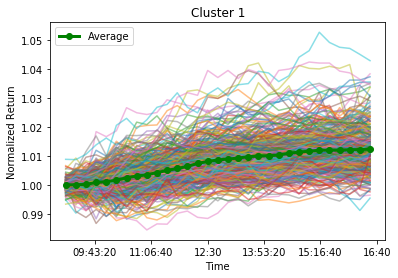

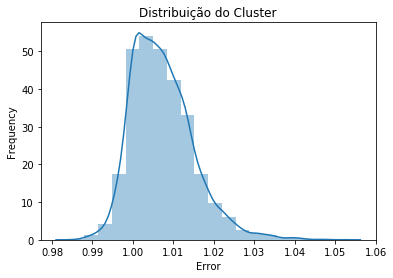

#------------------------------//------------------------------#
Cluster 2
Have 74 days
Representation: 6.44
Accumulated Representation: 71.19
Absolute Error: 0.0563
Mean Square Error: 0.0018
Downtrend 09:15:00
Upward Trend 12:15:00
Downtrend 16:15:00


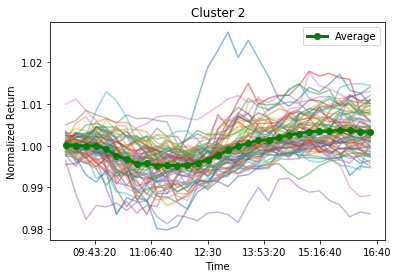

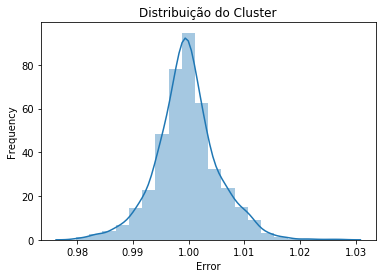

#------------------------------//------------------------------#
Cluster 3
Have 72 days
Representation: 6.27
Accumulated Representation: 77.46
Absolute Error: 0.0748
Mean Square Error: 0.0024
Upward Trend 09:15:00
Downtrend 13:00:00


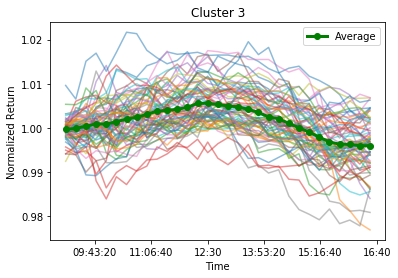

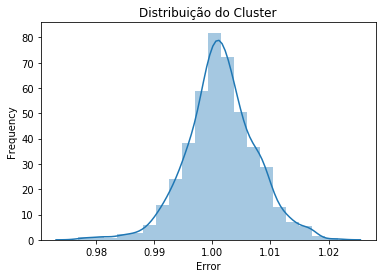

#------------------------------//------------------------------#
Cluster 4
Have 52 days
Representation: 4.53
Accumulated Representation: 81.98
Absolute Error: 0.0566
Mean Square Error: 0.0018
Upward Trend 09:15:00
Downtrend 11:45:00
Upward Trend 15:15:00


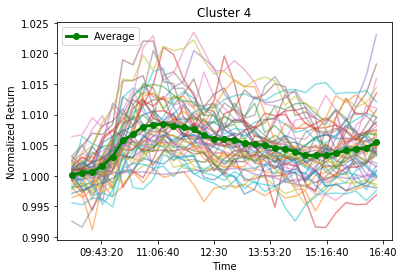

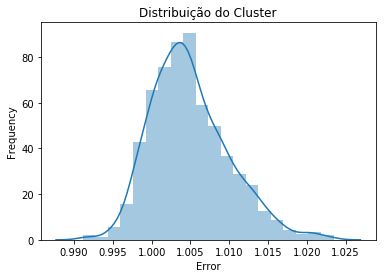

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -10.415449817068911
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001976          0.799469          0.703305      0.000092
--------//--------
Generation:  2
Media Geração:  -10.114955872289894
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001976          0.799469          0.703305      0.000092
--------//--------
Generation:  3
Media Geração:  -10.110955497918857
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002157          0.795272          0.709251      0.000387
--------//--------
Generation:  4
Media Geração:  -10.012582119645554
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002157          0.795272          0.709251      0.000387
--------//--------
Generation:  5
Media Geração:  -9.710298260100716
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorr

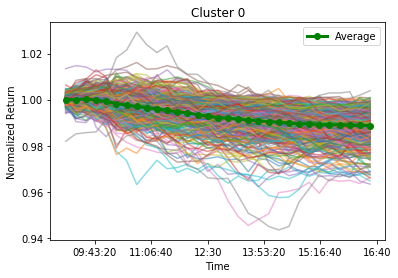

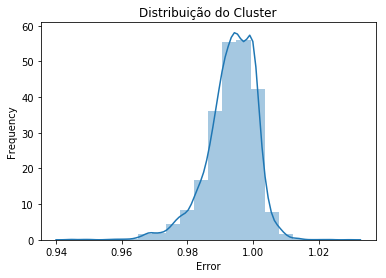

#------------------------------//------------------------------#
Cluster 1
Have 398 days
Representation: 34.08
Accumulated Representation: 68.84
Absolute Error: 0.0141
Mean Square Error: 0.0005
Upward Trend 09:15:00


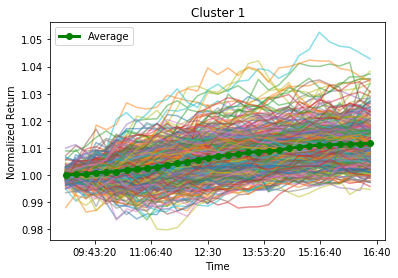

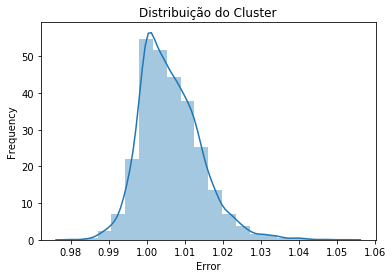

#------------------------------//------------------------------#
Cluster 2
Have 76 days
Representation: 6.51
Accumulated Representation: 75.34
Absolute Error: 0.0655
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 12:15:00


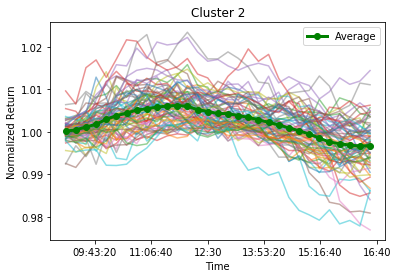

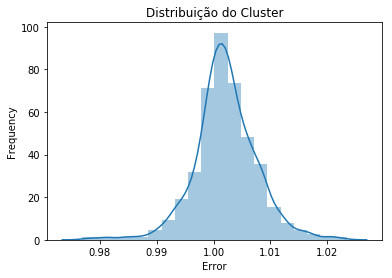

#------------------------------//------------------------------#
Cluster 3
Have 52 days
Representation: 4.45
Accumulated Representation: 79.79
Absolute Error: 0.0717
Mean Square Error: 0.0023
Downtrend 09:15:00
Upward Trend 13:15:00


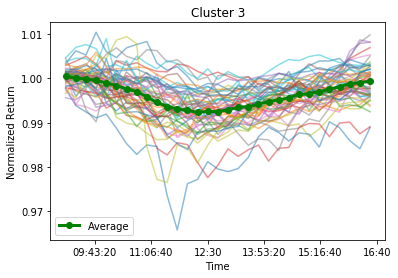

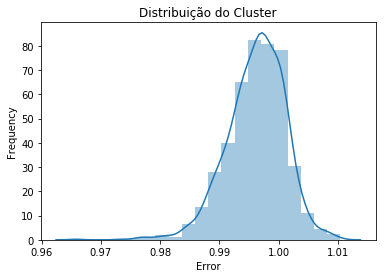

#------------------------------//------------------------------#
Cluster 4
Have 46 days
Representation: 3.94
Accumulated Representation: 83.73
Absolute Error: 0.0772
Mean Square Error: 0.0025
Upward Trend 09:15:00
Downtrend 13:45:00


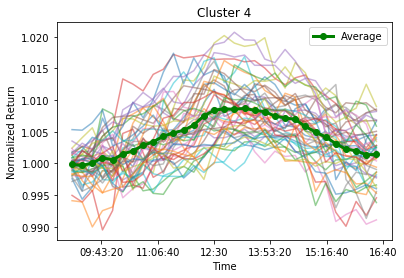

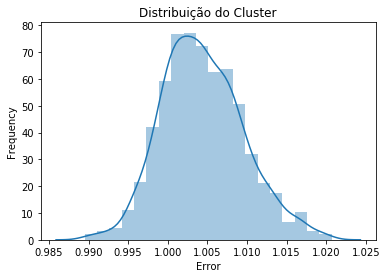

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -9.856771443185153
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001827          0.798045          0.696085     -0.000047
--------//--------
Generation:  2
Media Geração:  -9.854107541295287
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001827          0.798045          0.696085     -0.000047
--------//--------
Generation:  3
Media Geração:  -9.852544491782208
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001827          0.798045          0.696085     -0.000047
--------//--------
Generation:  4
Media Geração:  -9.755555385279155
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001973          0.802606          0.695911       0.00002
--------//--------
Generation:  5
Media Geração:  -9.75526268429967
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelaca

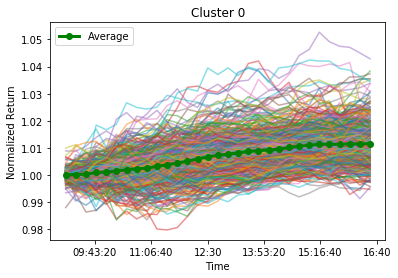

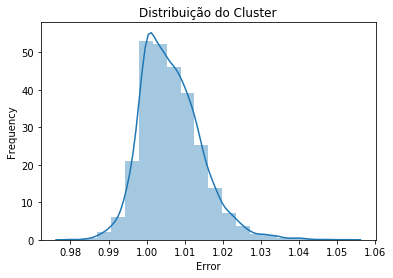

#------------------------------//------------------------------#
Cluster 1
Have 378 days
Representation: 31.76
Accumulated Representation: 65.63
Absolute Error: 0.0169
Mean Square Error: 0.0005
Upward Trend 09:15:00
Downtrend 10:00:00


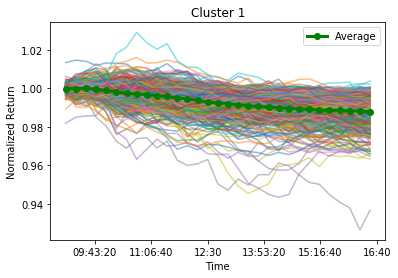

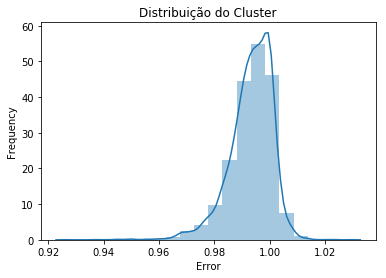

#------------------------------//------------------------------#
Cluster 2
Have 116 days
Representation: 9.75
Accumulated Representation: 75.38
Absolute Error: 0.0638
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 10:00:00
Upward Trend 13:15:00


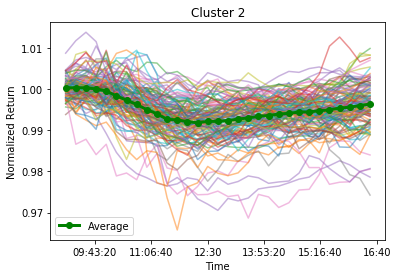

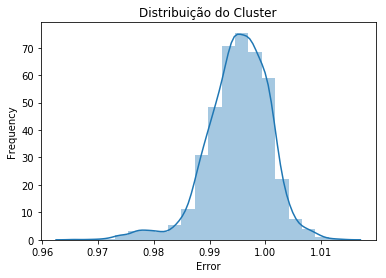

#------------------------------//------------------------------#
Cluster 3
Have 73 days
Representation: 6.13
Accumulated Representation: 81.51
Absolute Error: 0.0663
Mean Square Error: 0.0021
Upward Trend 09:15:00
Downtrend 12:15:00


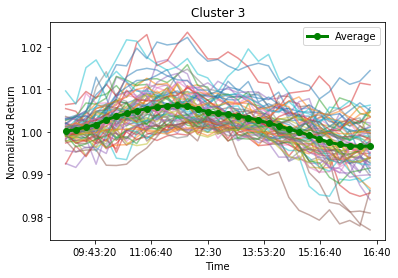

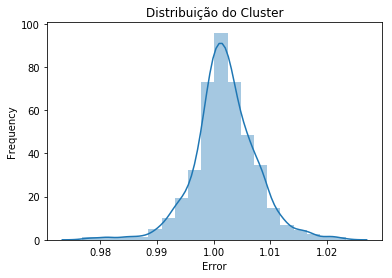

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -11.828613815883909
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002005          0.795878          0.698337      0.000072
--------//--------
Generation:  2
Media Geração:  -11.823261645367495
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001953          0.789187          0.699791      0.000132
--------//--------
Generation:  3
Media Geração:  -11.809549945389069
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002019          0.802783          0.699698     -0.000016
--------//--------
Generation:  4
Media Geração:  -11.610384028843693
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.003015           0.85735          0.704996      0.000302
--------//--------
Generation:  5
Media Geração:  -10.41618363156823
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorr

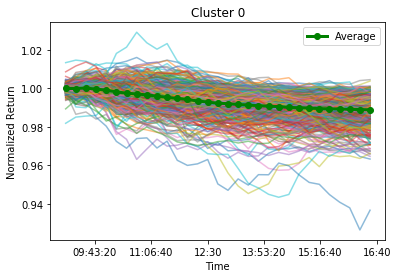

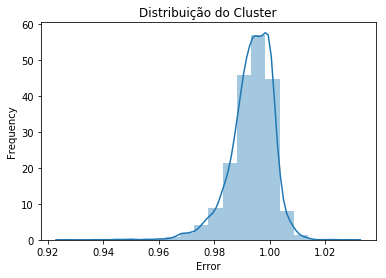

#------------------------------//------------------------------#
Cluster 1
Have 443 days
Representation: 36.64
Accumulated Representation: 74.61
Absolute Error: 0.0162
Mean Square Error: 0.0005
Upward Trend 09:15:00


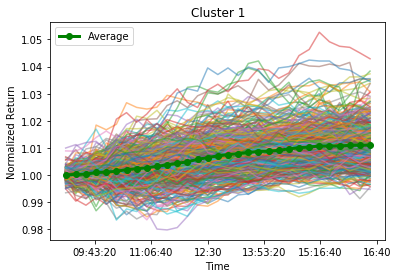

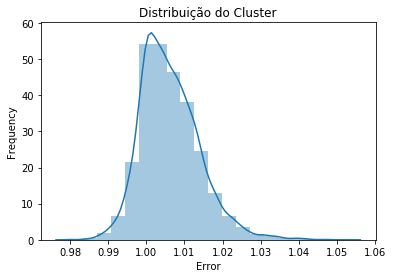

#------------------------------//------------------------------#
Cluster 2
Have 102 days
Representation: 8.44
Accumulated Representation: 83.04
Absolute Error: 0.0693
Mean Square Error: 0.0022
Upward Trend 09:15:00
Downtrend 12:45:00


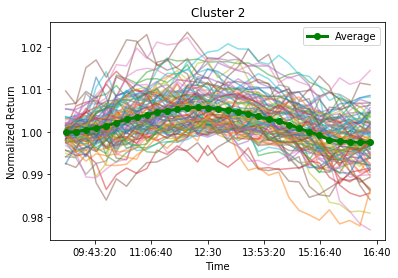

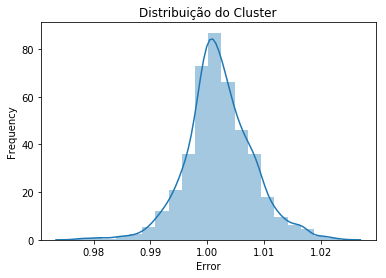

#------------------------------//------------------------------#
-VALIDATION-
--------//--------
Generation:  1
Media Geração:  -8.851812677327485
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.002091          0.797883          0.695446     -0.000156
--------//--------
Generation:  2
Media Geração:  -8.751892287786143
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0      0.001972          0.801504          0.702491      0.000007
--------//--------
Generation:  3
Media Geração:  -8.65162771716968
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0        0.0019           0.79611          0.702614      0.000016
--------//--------
Generation:  4
Media Geração:  -8.35201093080607
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao  MRiscoPadrao
0        0.0019           0.79611          0.702614      0.000016
--------//--------
Generation:  5
Media Geração:  -8.351845928350496
   MGanhoPadrao  MGanhoCorrelacao  MRiscoCorrelacao

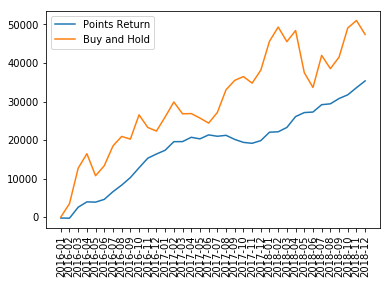

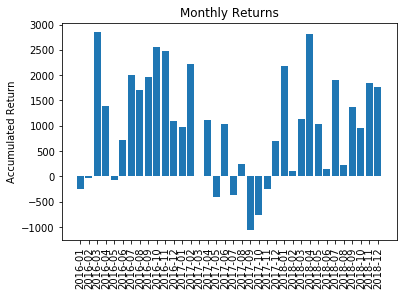

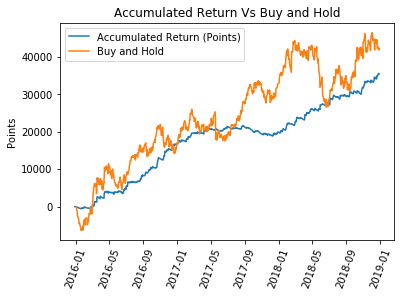

------------------------------//------------------------------


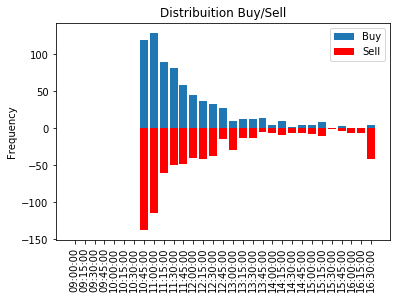

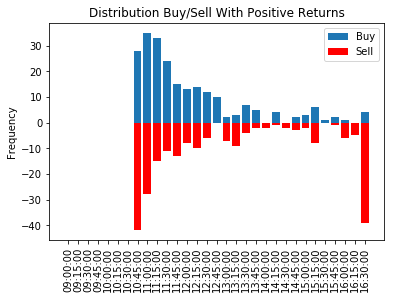

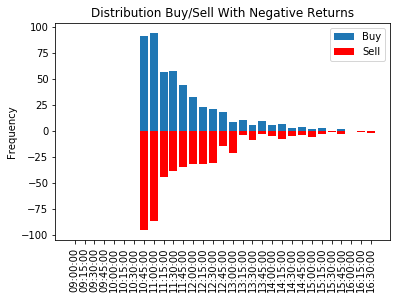

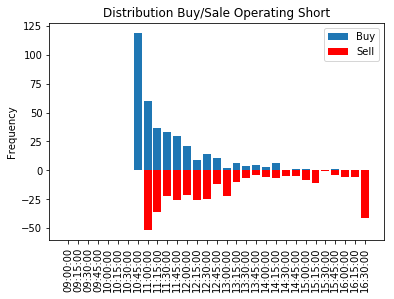

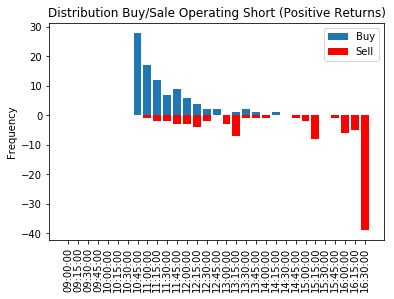

...

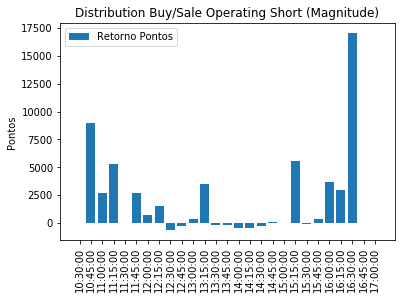

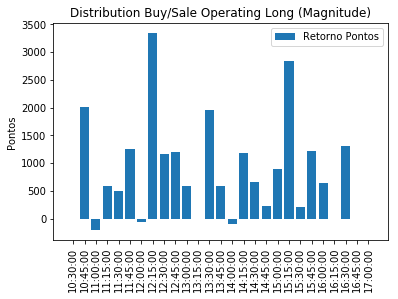

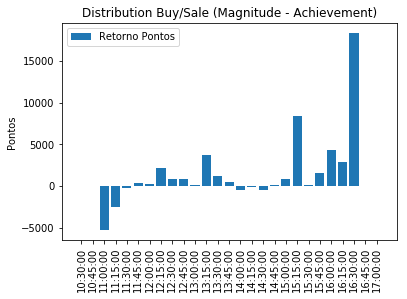

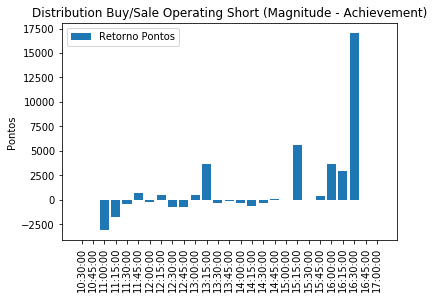

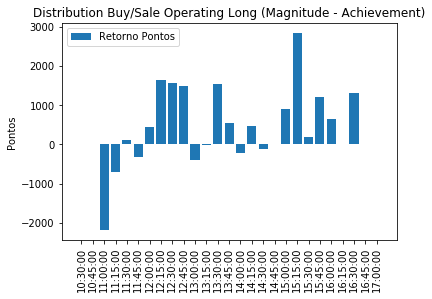

In [5]:
## NORMALIZA OS DADOS DO LOG RETORNO
#LogAux = DadosTratados.T.apply(zscore)
#LogRetornoNormalizado = LogAux.T

hora= sorted(Dados.hora.unique())

#Dados
DadosTratados = logRetornoTratado
#DadosTratados = DadosFiltrados
#DadosTratados = LogRetornoNormalizado


#K - Tamanho do Cluster
K = 30

# Controla o ganho em todos os períodos
ganhoPeriodo = []
ganhoPeriodo.append(0)

ganhoDiario = []
ganhoDiario.append(0)

ganhoMensal = []
ganhoMensal.append(0)

ValorAtivoFinalMes = []

EstudadosDatas = []

FinalMesValor = []
FinalDiaValor = []

listaGanhoCompradoHoraCompra = []  
listaGanhoCompradoHoraVenda = []
listaGanhoVendidoHoraCompra = []
listaGanhoVendidoHoraVenda = []
listaPerdaCompradoHoraCompra = []  
listaPerdaCompradoHoraVenda = []
listaPerdaVendidoHoraCompra = []
listaPerdaVendidoHoraVenda = []
listDaysGain = []
listDaysLoss = []
listDaysNoOperate = []
listaGanhoCompradoHoraCompraMagnitude = {} 
listaGanhoCompradoHoraVendaMagnitude = {}
listaGanhoVendidoHoraCompraMagnitude = {}
listaGanhoVendidoHoraVendaMagnitude = {}
listaPerdaCompradoHoraCompraMagnitude = {}  
listaPerdaCompradoHoraVendaMagnitude = {}
listaPerdaVendidoHoraCompraMagnitude = {}
listaPerdaVendidoHoraVendaMagnitude = {}
for tempo in hora:
    listaGanhoCompradoHoraCompraMagnitude[str(tempo)] = 0
    listaGanhoCompradoHoraVendaMagnitude[str(tempo)] = 0
    listaGanhoVendidoHoraCompraMagnitude[str(tempo)] = 0
    listaGanhoVendidoHoraVendaMagnitude[str(tempo)] = 0
    listaPerdaCompradoHoraCompraMagnitude[str(tempo)] = 0
    listaPerdaCompradoHoraVendaMagnitude[str(tempo)] = 0
    listaPerdaVendidoHoraCompraMagnitude[str(tempo)] = 0
    listaPerdaVendidoHoraVendaMagnitude[str(tempo)] = 0


# Setting for entering the repeat loop
if Windowing == 1:
    temp = range(18,54);
    intervalo = 6;
if Windowing == 2:
    temp = range(12,48)
    intervalo = 12
if Windowing == 3:
    temp = range(0,36)
    intervalo = 24
if Windowing == 4:
    temp = range(24,60)
    intervalo = 0
    
#Two years
 ## range(0,36)
 ## intervalo = 24
 ##EstudadosDatas.append(DatasIniciaisMes[i+intervalo][0:7])
#One years
 ## range(12,48)
 ## intervalo = 12
 ##EstudadosDatas.append(DatasIniciaisMes[i+intervalo][0:7])
#Six months
 ## range(18,54)
 ## intervalo = 6
 ##EstudadosDatas.append(DatasIniciaisMes[i+intervalo][0:7])
 ##inicio = dt_idx.get_loc(DatasIniciaisMes[i])
#Acumulativo
 ## range(24,60)
 ## intervalo = 0
 ##EstudadosDatas.append(DatasIniciaisMes[0][0:7])
 ##inicio = dt_idx.get_loc(DatasIniciaisMes[0])
for i in temp: 
    #intervalo = 24
    print("----------//----------")
    print("Studied Month: ", DatasIniciaisMes[i+intervalo])
    EstudadosDatas.append(DatasIniciaisMes[i+intervalo][0:7])
    #Formação dos Cluster (Treinamento)
    print("-TRAINING-")
    print('Formation of Clusters (Training)')
    inicio = dt_idx.get_loc(DatasIniciaisMes[0])
    fim = dt_idx.get_loc(DatasIniciaisMes[i+intervalo])
    
    DadosAux = DadosTratados.T
    DadosTreinamento = DadosAux[inicio:fim]
    Z = estruturaDados.DadosToCluster(DadosTreinamento, False) # Ultimo parametro é o plot(True or False)
    listaCluster = estruturaDados.segmentaCluster(Z, K, False) # Ultimo parametro é o plot(True or False)

    [listaOrdenada, QuantidadeDias, Representacao]  = estruturaDados.ordenacaoTamanhoCluster(DadosTreinamento, listaCluster)
    if PlotClusters:
        print("Plot the Clusters Formed")
        estruturaDados.printClusters(listaCluster,QuantidadeDias, Representacao, listaOrdenada, DadosTreinamento)

      
    #Validação
    print('-VALIDATION-')
    [listaCurvas, listaMedias] = estruturaDados.CurvasClusters2(DadosTreinamento, listaCluster, listaOrdenada)
    
    
    lista = []
    lista.append(0.002)
    lista.append(0.8)
    lista.append(0.7)
    lista.append(0)
    
    
    #Otimization - Execute Differential Evolution
    if Otimization:
        parametrosNegociacao = estruturaDados.EvolucaoDiferencial(10, 70, 1.5, DadosTreinamento, listaMedias, Representacao, Dados)
    else:
        parametrosNegociacao = pd.DataFrame([lista],columns=['MGanhoPadrao', 'MGanhoCorrelacao', 'MRiscoCorrelacao', 'MRiscoPadrao'], index=[0])
        
    
    #Test
    print('-TEST-')
    inicio = dt_idx.get_loc(DatasIniciaisMes[i+intervalo])
    fim = dt_idx.get_loc(DatasIniciaisMes[i+intervalo+1])


    #Dados Não Normalizados
    DadosAux = DadosFiltrados
    DadosTeste = DadosAux[inicio:fim]
    
    FinalMesValor.append(DadosTeste.iloc[len(DadosTeste)-1][30])
    
    stoplossAux = 0.001

    ganhoAcumuladoMes = 0;
                               
    
    
    for dia in range(0,len(DadosTeste)):
        [ganho, CompradoHoraCompra, CompradoHoraVenda, VendidoHoraCompra, VendidoHoraVenda] = estruturaDados.SimulacaoEstrategia(dia, False, stoplossAux, DadosTeste, listaMedias, Representacao,parametrosNegociacao, Dados)
        if ganho > 0:
            listDaysGain.append(dia)
            if CompradoHoraCompra != 0:
                listaGanhoCompradoHoraCompra.append(CompradoHoraCompra)
                listaGanhoCompradoHoraCompraMagnitude[str(CompradoHoraCompra)] = listaGanhoCompradoHoraCompraMagnitude[str(CompradoHoraCompra)]+ganho
            if CompradoHoraVenda != 0:
                listaGanhoCompradoHoraVenda.append(CompradoHoraVenda)
                listaGanhoCompradoHoraVendaMagnitude[str(CompradoHoraVenda)] = listaGanhoCompradoHoraVendaMagnitude[str(CompradoHoraVenda)]+ganho
            if VendidoHoraCompra != 0:
                listaGanhoVendidoHoraCompra.append(VendidoHoraCompra)
                listaGanhoVendidoHoraCompraMagnitude[str(VendidoHoraCompra)] = listaGanhoVendidoHoraCompraMagnitude[str(VendidoHoraCompra)]+ganho
            if VendidoHoraVenda != 0:
                listaGanhoVendidoHoraVenda.append(VendidoHoraVenda)
                listaGanhoVendidoHoraVendaMagnitude[str(VendidoHoraVenda)] = listaGanhoVendidoHoraVendaMagnitude[str(VendidoHoraVenda)]+ganho
        if ganho < 0:
            listDaysLoss.append(dia)
            if CompradoHoraCompra != 0:
                listaPerdaCompradoHoraCompra.append(CompradoHoraCompra)
                listaPerdaCompradoHoraCompraMagnitude[str(CompradoHoraCompra)] = listaPerdaCompradoHoraCompraMagnitude[str(CompradoHoraCompra)]+ganho
            if CompradoHoraVenda != 0:
                listaPerdaCompradoHoraVenda.append(CompradoHoraVenda)
                listaPerdaCompradoHoraVendaMagnitude[str(CompradoHoraVenda)] = listaPerdaCompradoHoraVendaMagnitude[str(CompradoHoraVenda)]+ganho
            if VendidoHoraCompra != 0:
                listaPerdaVendidoHoraCompra.append(VendidoHoraCompra)
                listaPerdaVendidoHoraCompraMagnitude[str(VendidoHoraCompra)] = listaPerdaVendidoHoraCompraMagnitude[str(VendidoHoraCompra)]+ganho
            if VendidoHoraVenda != 0:
                listaPerdaVendidoHoraVenda.append(VendidoHoraVenda)
                listaPerdaVendidoHoraVendaMagnitude[str(VendidoHoraVenda)] = listaPerdaVendidoHoraVendaMagnitude[str(VendidoHoraVenda)]+ganho
        if ganho == 0:
            listDaysNoOperate.append(dia)
        
        ganhoDiario.append(ganho) 
        ganhoAcumuladoMes = ganhoDiario[-1] + ganhoAcumuladoMes
        FinalDiaValor.append(DadosTeste.iloc[dia][30])
    
    print("Accumulated Month: ", ganhoAcumuladoMes)
    ganhoPeriodo.append(ganhoAcumuladoMes + ganhoPeriodo[-1])
    ganhoMensal.append(ganhoAcumuladoMes)
    ValorAtivoFinalMes.append(FinalMesValor[-1]-FinalMesValor[0])
    

#--------//--------#
#plot os ganhos em termos mensais
plt.plot(EstudadosDatas,ganhoPeriodo[1:])
plt.plot(EstudadosDatas,ValorAtivoFinalMes)
plt.xticks(rotation=90);
plt.legend(["Points Return", "Buy and Hold"])
plt.show()

plt.bar(EstudadosDatas,ganhoMensal[1:])
plt.title("Monthly Returns")
plt.ylabel("Accumulated Return")
plt.xticks(rotation=90);
plt.show()

#--------//--------#
#plot o ganho em termos diários
acumula = []
acumula.append(0)
for i in ganhoDiario:
    acumula.append(acumula[-1]+i)

real = []
for i in FinalDiaValor:
    real.append(i-FinalDiaValor[0])
    
plt.plot(DiasAnalisados[fim-len(acumula):fim], acumula)
plt.plot(DiasAnalisados[fim-len(FinalDiaValor):fim], real)
plt.legend(['Accumulated Return (Points)', 'Buy and Hold'])
plt.title('Accumulated Return Vs Buy and Hold')
plt.xticks(rotation=70);
plt.ylabel('Points')
plt.show()
print("------------------------------//------------------------------")
#Plota as Figuras em Barra referente ao horário de negociações
hora = hora[6:-7]
FigureBar()
FigureBarMagnitude()



Drawdown of Operations Carried out by the Experiment


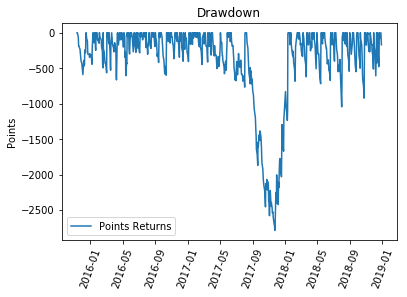

Longer Loss Sequence:  103
Largest Accumulated Loss:  -2786
Biggest Loss in a Day:  -425


In [6]:
print("Drawdown of Operations Carried out by the Experiment")
drawdownGeral = []

drawdownGeral.append(0)
for T in ganhoDiario:
    if drawdownGeral[-1]+T < 0:
        drawdownGeral.append(drawdownGeral[-1]+T)
    if drawdownGeral[-1]+T >= 0:
        drawdownGeral.append(0)

plt.plot(DiasAnalisados[fim-len(drawdownGeral):fim], drawdownGeral)
plt.xticks(rotation=70);

plt.title('Drawdown')
plt.ylabel('Points')
plt.legend(['Points Returns'])
    

plt.show()

MaxDiasPerdas = 0
auxPerdas = 0
for T in drawdownGeral:
    if T < 0:
        auxPerdas = auxPerdas + 1
        if auxPerdas > MaxDiasPerdas:
            MaxDiasPerdas = auxPerdas
    else:
        auxPerdas = 0


        
print("Longer Loss Sequence: ", MaxDiasPerdas)

print("Largest Accumulated Loss: ", min(drawdownGeral))

print("Biggest Loss in a Day: ", min(ganhoDiario) )

Drawdown of Real Data


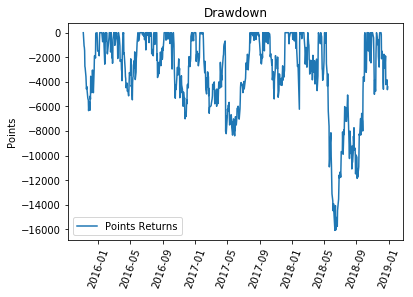

Longer Loss Sequence:  119
Largest Accumulated Loss:  -16080
Biggest Loss in a Day:  -425


In [7]:
print("Drawdown of Real Data")
drawdownGeral = []

diferenca = []
for i in range(1, len(real)):
        diferenca.append(real[i]-real[i-1])
    

drawdownGeral.append(0)
for T in diferenca:
    if drawdownGeral[-1]+T < 0:
        drawdownGeral.append(drawdownGeral[-1]+T)
    if drawdownGeral[-1]+T >= 0:
        drawdownGeral.append(0)

plt.plot(DiasAnalisados[fim-len(drawdownGeral):fim], drawdownGeral)
plt.xticks(rotation=70);

plt.title('Drawdown')
plt.ylabel('Points')
plt.legend(['Points Returns'])
    

plt.show()

MaxDiasPerdas = 0
auxPerdas = 0
for T in drawdownGeral:
    if T < 0:
        auxPerdas = auxPerdas + 1
        if auxPerdas > MaxDiasPerdas:
            MaxDiasPerdas = auxPerdas
    else:
        auxPerdas = 0


        
print("Longer Loss Sequence: ", MaxDiasPerdas)

print("Largest Accumulated Loss: ", min(drawdownGeral))

print("Biggest Loss in a Day: ", min(ganhoDiario) )

Example of Clusters and Representations
Cluster: 0 - Representation: 37.97
Cluster: 1 - Representation: 36.64
Cluster: 2 - Representation: 8.44
Cluster: 3 - Representation: 3.80
Cluster: 4 - Representation: 2.48


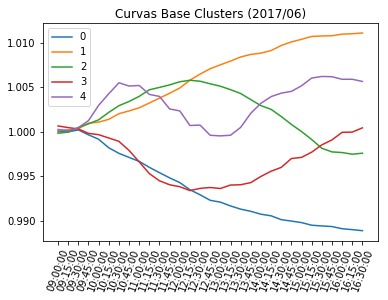

In [8]:
print("Example of Clusters and Representations")
legenda = []
listahora = []

hora= sorted(Dados.hora.unique())
for tempo in hora:
        listahora.append(str(tempo))
        
for i in range(5):
    print("Cluster: %d - Representation: %.2f" % (i,Representacao[i]))
    plt.plot(listahora[0:31], listaMedias[i])
    legenda.append(i)
plt.title('Curvas Base Clusters (2017/06)')
plt.xticks(rotation=70);
plt.legend(legenda)
plt.show()


ponto = 6

Ativados = [1, 2]
ganhoEstrategia = 0;
somaRepresentacao = 0
for i in Ativados:
    ganhoEstrategia = ganhoEstrategia + (listaMedias[i][30] - listaMedias[i][ponto])
    somaRepresentacao = somaRepresentacao + Representacao[i]


In [9]:
print("Experiment Results With the Configured Settings")
positivo = 0
ganhoPositivo = 0
negativo = 0
ganhoNegativo = 0
neutro = 0
for T in ganhoDiario:
    if T>0:
        positivo = 1+positivo
        ganhoPositivo = ganhoPositivo + T
    if T<0:
        negativo = 1+negativo
        ganhoNegativo = ganhoNegativo + T
    if T==0:
        neutro = neutro + 1

        
print("Days: ", positivo+negativo+neutro)
print("Days Gain:", positivo)
print("Magnitude Gain: ", ganhoPositivo)
print("Days Loss:", negativo)
print("Magnitude Loss: ", ganhoNegativo)

print("Average Gain: ", ganhoPositivo/positivo)
print("Average Loss: ", ganhoNegativo/negativo)

print("Average Overall Gain: ", (ganhoPositivo + ganhoNegativo)/(positivo+negativo))

print("Gain / Loss Ratio: ", positivo/(positivo+negativo))
print("No Operate:", neutro)

Experiment Results With the Configured Settings
Days:  738
Days Gain: 218
Magnitude Gain:  72743
Days Loss: 488
Magnitude Loss:  -37392
Average Gain:  333.6834862385321
Average Loss:  -76.62295081967213
Average Overall Gain:  50.07223796033994
Gain / Loss Ratio:  0.3087818696883853
No Operate: 32


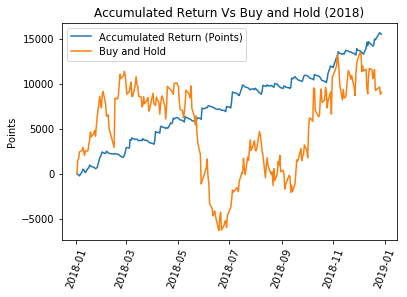

Days:  244
Days Gain: 73
Magnitude Gain:  29629
Days Loss: 159
Magnitude Loss:  -14126
Average Gain:  405.8767123287671
Average Loss:  -88.84276729559748
Average Overall Gain:  66.82327586206897
Gain / Loss Ratio:  0.3146551724137931
No Operate: 12


In [10]:
#DatasIniciaisMes = ['2014-01-02' , '2014-02-03' , '2014-03-06' , '2014-04-01' , '2014-05-02' , '2014-06-02' , '2014-07-01' , '2014-08-01' , '2014-09-01' , '2014-10-01' , '2014-11-03' , '2014-12-01' ,
#                    '2015-01-02' , '2015-02-02' , '2015-03-02' , '2015-04-01' , '2015-05-04' , '2015-06-01' , '2015-07-01' , '2015-08-03' , '2015-09-01' , '2015-10-01' , '2015-11-03' , '2015-12-01' ,
#                    '2016-01-04' , '2016-02-01' , '2016-03-01' , '2016-04-01' , '2016-05-02' , '2016-06-01' , '2016-07-01' , '2016-08-01' , '2016-09-01' , '2016-10-03' , '2016-11-01' , '2016-12-01' , 
#                    '2017-01-02' , '2017-02-01' , '2017-03-02' , '2017-04-03' , '2017-05-02' , '2017-06-01' , '2017-07-03' , '2017-08-01' , '2017-09-01' , '2017-10-02' , '2017-11-01' , '2017-12-01' , 
#                    '2018-01-02' , '2018-02-01' , '2018-03-01' , '2018-04-02' , '2018-05-02' , '2018-06-01' , '2018-07-02' , '2018-08-01' , '2018-09-03' , '2018-10-01' , '2018-11-01' , '2018-12-03' , 
#                    '2019-01-02' , '2019-02-01' , '2019-03-01' , '2019-04-01']

#PLOT 2018
inicioplot = dt_idx.get_loc(DatasIniciaisMes[48])
fimplot = dt_idx.get_loc(DatasIniciaisMes[60])
inicioplotAcumula = fimplot-inicioplot


auxTempReal = []
auxTempAcumula = []

for i in acumula[-inicioplotAcumula:]:
    auxTempAcumula.append(i-acumula[-inicioplotAcumula])
for i in real[-inicioplotAcumula:]:
    auxTempReal.append(i-real[-inicioplotAcumula])
    
    

    
plt.plot(DiasAnalisados[inicioplot:fimplot], auxTempAcumula)
plt.plot(DiasAnalisados[inicioplot:fimplot], auxTempReal)
plt.legend(['Accumulated Return (Points)', 'Buy and Hold'])
plt.title('Accumulated Return Vs Buy and Hold (2018)')
plt.xticks(rotation=70);
plt.ylabel('Points')
plt.show()

# Dados 2018 - Rodar somente depois da celula de dados de 2018
positivo = 0
ganhoPositivo = 0
negativo = 0
ganhoNegativo = 0
neutro = 0

for T in ganhoDiario[-inicioplotAcumula:]:
    if T>0:
        positivo = 1+positivo
        ganhoPositivo = ganhoPositivo + T
    if T<0:
        negativo = 1+negativo
        ganhoNegativo = ganhoNegativo + T
    if T==0:
        neutro = neutro + 1

        
print("Days: ", positivo+negativo+neutro)
print("Days Gain:", positivo)
print("Magnitude Gain: ", ganhoPositivo)
print("Days Loss:", negativo)
print("Magnitude Loss: ", ganhoNegativo)

print("Average Gain: ", ganhoPositivo/positivo)
print("Average Loss: ", ganhoNegativo/negativo)

print("Average Overall Gain: ", (ganhoPositivo + ganhoNegativo)/(positivo+negativo))

print("Gain / Loss Ratio: ", positivo/(positivo+negativo))
print("No Operate:", neutro)

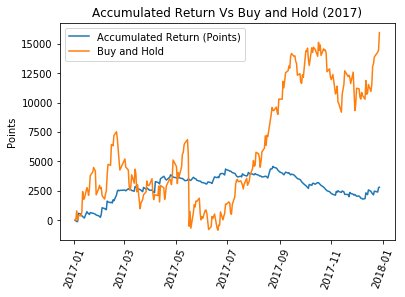

Days:  245
Days Gain: 67
Magnitude Gain:  15050
Days Loss: 168
Magnitude Loss:  -12256
Average Gain:  224.62686567164178
Average Loss:  -72.95238095238095
Average Overall Gain:  11.88936170212766
Gain / Loss Ratio:  0.2851063829787234
No Operate: 10


In [11]:
#PLOT 2017

inicioplotData = dt_idx.get_loc(DatasIniciaisMes[36])
fimplotData = dt_idx.get_loc(DatasIniciaisMes[48])


fimplot = len(acumula)-inicioplotAcumula
inicioplot = fimplot-(fimplotData-inicioplotData)


auxTempAcumula = []
auxTempReal = []
for i in acumula[inicioplot:fimplot]:
    auxTempAcumula.append(i-acumula[inicioplot])
for i in real[inicioplot:fimplot]:
    auxTempReal.append(i-real[inicioplot])


    

    
    
plt.plot(DiasAnalisados[inicioplotData:fimplotData], auxTempAcumula)
plt.plot(DiasAnalisados[inicioplotData:fimplotData], auxTempReal)
plt.legend(['Accumulated Return (Points)', 'Buy and Hold'])
plt.title('Accumulated Return Vs Buy and Hold (2017)')
plt.xticks(rotation=70);
plt.ylabel('Points')
plt.show()

positivo = 0
ganhoPositivo = 0
negativo = 0
ganhoNegativo = 0
neutro = 0

for T in ganhoDiario[inicioplot:fimplot]:
    if T>0:
        positivo = 1+positivo
        ganhoPositivo = ganhoPositivo + T
    if T<0:
        negativo = 1+negativo
        ganhoNegativo = ganhoNegativo + T
    if T==0:
        neutro = neutro + 1

        
print("Days: ", positivo+negativo+neutro)
print("Days Gain:", positivo)
print("Magnitude Gain: ", ganhoPositivo)
print("Days Loss:", negativo)
print("Magnitude Loss: ", ganhoNegativo)

print("Average Gain: ", ganhoPositivo/positivo)
print("Average Loss: ", ganhoNegativo/negativo)

print("Average Overall Gain: ", (ganhoPositivo + ganhoNegativo)/(positivo+negativo))

print("Gain / Loss Ratio: ", positivo/(positivo+negativo))
print("No Operate:", neutro)


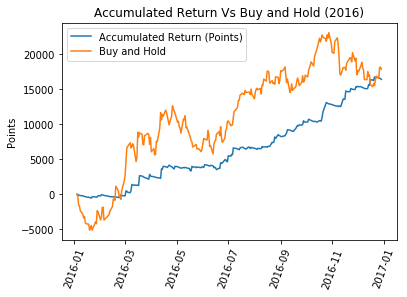

Days:  248
Days Gain: 78
Magnitude Gain:  28064
Days Loss: 161
Magnitude Loss:  -10970
Average Gain:  359.79487179487177
Average Loss:  -68.13664596273291
Average Overall Gain:  71.52301255230125
Gain / Loss Ratio:  0.3263598326359833
No Operate: 9


In [12]:
#PLOT 2016

inicioplotData = dt_idx.get_loc(DatasIniciaisMes[24])
fimplotData = dt_idx.get_loc(DatasIniciaisMes[36])


fimplot = inicioplot
inicioplot = fimplot-(fimplotData-inicioplotData)


auxTempAcumula = []
auxTempReal = []
for i in acumula[inicioplot:fimplot]:
    auxTempAcumula.append(i-acumula[inicioplot])
for i in real[inicioplot:fimplot]:
    auxTempReal.append(i-real[inicioplot])
    
plt.plot(DiasAnalisados[inicioplotData:fimplotData], auxTempAcumula)
plt.plot(DiasAnalisados[inicioplotData:fimplotData], auxTempReal)
plt.legend(['Accumulated Return (Points)', 'Buy and Hold'])
plt.title('Accumulated Return Vs Buy and Hold (2016)')
plt.xticks(rotation=70);
plt.ylabel('Points')
plt.show()

positivo = 0
ganhoPositivo = 0
negativo = 0
ganhoNegativo = 0
neutro = 0

for T in ganhoDiario[inicioplot:fimplot]:
    if T>0:
        positivo = 1+positivo
        ganhoPositivo = ganhoPositivo + T
    if T<0:
        negativo = 1+negativo
        ganhoNegativo = ganhoNegativo + T
    if T==0:
        neutro = neutro + 1

        
print("Days: ", positivo+negativo+neutro)
print("Days Gain:", positivo)
print("Magnitude Gain: ", ganhoPositivo)
print("Days Loss:", negativo)
print("Magnitude Loss: ", ganhoNegativo)

print("Average Gain: ", ganhoPositivo/positivo)
print("Average Loss: ", ganhoNegativo/negativo)

print("Average Overall Gain: ", (ganhoPositivo + ganhoNegativo)/(positivo+negativo))

print("Gain / Loss Ratio: ", positivo/(positivo+negativo))
print("No Operate:", neutro)


Worst period of execution - Change in behavior mentioned in the paper


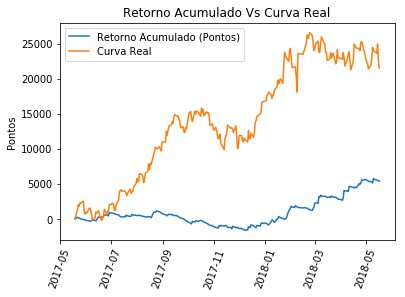

Days:  245
Days Gain: 73
Magnitude Gain:  18080
Days Loss: 162
Magnitude Loss:  -12774
Average Gain:  247.67123287671234
Average Loss:  -78.85185185185185
Average Overall Gain:  22.57872340425532
Gain / Loss Ratio:  0.31063829787234043
No Operate: 10


In [13]:
#PLOT - Problema
print("Worst period of execution - Change in behavior mentioned in the paper")

acumulaInicio = 372-30
plotDadosInicio = 901-30
acumulaFim = 617-30
plotDadosFim = 1146-30

inicioplotData = dt_idx.get_loc(DatasIniciaisMes[40])
fimplotData = dt_idx.get_loc(DatasIniciaisMes[52])


fimplot = acumulaFim
inicioplot = acumulaInicio


auxTempAcumula = []
auxTempReal = []
for i in acumula[acumulaInicio:acumulaFim]:
    auxTempAcumula.append(i-acumula[acumulaInicio])
for i in real[acumulaInicio:acumulaFim]:
    auxTempReal.append(i-real[acumulaInicio])
    
    
plt.plot(DiasAnalisados[plotDadosInicio:plotDadosFim], auxTempAcumula)
plt.plot(DiasAnalisados[plotDadosInicio:plotDadosFim], auxTempReal)
plt.legend(['Retorno Acumulado (Pontos)', 'Curva Real'])
plt.title('Retorno Acumulado Vs Curva Real')
plt.xticks(rotation=70);
plt.ylabel('Pontos')
plt.show()


positivo = 0
ganhoPositivo = 0
negativo = 0
ganhoNegativo = 0
neutro = 0

for T in ganhoDiario[inicioplot:fimplot]:
    if T>0:
        positivo = 1+positivo
        ganhoPositivo = ganhoPositivo + T
    if T<0:
        negativo = 1+negativo
        ganhoNegativo = ganhoNegativo + T
    if T==0:
        neutro = neutro + 1


print("Days: ", positivo+negativo+neutro)
print("Days Gain:", positivo)
print("Magnitude Gain: ", ganhoPositivo)
print("Days Loss:", negativo)
print("Magnitude Loss: ", ganhoNegativo)

print("Average Gain: ", ganhoPositivo/positivo)
print("Average Loss: ", ganhoNegativo/negativo)

print("Average Overall Gain: ", (ganhoPositivo + ganhoNegativo)/(positivo+negativo))

print("Gain / Loss Ratio: ", positivo/(positivo+negativo))
print("No Operate:", neutro)

